In [1]:
from ipywidgets import IntProgress
IntProgress(10,max=100)

IntProgress(value=10)

In [2]:
##################################################################################################################

In [3]:
import sys
print(sys.executable)

#sys.path.append('./opt/anaconda3/lib/python3.7/site-packages')

/Library/Frameworks/Python.framework/Versions/3.6/bin/python3


In [4]:
import matplotlib.pyplot as plt
import numpy as np
import pandas as pd
import ipywidgets as widgets
from IPython.display import display, clear_output
from mpl_toolkits import mplot3d
from termcolor import colored
from ipywidgets import Checkbox
from ipywidgets import Layout, Box
from IPython.core.display import display, HTML
from IPython.display import Image

#import ApogeeFunctions as ap
import ApogeeFunctionsNew as ap

import seaborn as sns
sns.set()

from scipy import *
from pylab import *
import matplotlib as mpl
import os
import astropy.io.fits as pyfits

from os import listdir
from glob import glob
from os import getcwd, chdir
import warnings
warnings.filterwarnings('ignore')

os.system('ulimit -n 50000')
os.system('ulimit -a');

shift   = 0
shift2  = 0
y_size  = 0.1
hide    = -1
target_shift   = 1.0
template_shift = 1.0

global Line_3970_visible
Line_3970_visible = 'Y'

print("\nInitialized!")


Initialized!


In [5]:
from IPython.display import display, HTML
display(HTML(data="""
<style>
    div#notebook-container    { width: 95%; }
    div#menubar-container     { width: 65%; }
    div#maintoolbar-container { width: 99%; }
</style>
"""))

## Common Spectral Lines (given in Å):

http://rbseu.uaa.alaska.edu/projects/spectroscopy/Stellar%20Spectroscopy.pdf

In [6]:
txt = """ Common Spectral Lines (given in Å):

Hydrogen (the “Balmer Series”):
Hα  6563
Hβ  4861
Hγ  4340
Hδ  4101
Hε  3970
H8  3889
H9  3835
H10 3798
H11 3771
H12 3750

Helium: 
He I   4026, 4388, 4471, 4713, 5015, 5048, 5875, 6678
He II  4339, 4542, 4686, 5412

Metals: 
Ca II  3933, 3968
C II   4267
C III  4649, 5696
C IV   4658, 5805
N III  4097, 4634
N IV   4058, 7100
NV     4605
OV     5592
Na I   5893
Mg I   5167, 5173, 5183
Mg II  4481
Si III 4552
Si IV  4089
Ca I   4226
Sc II  4246
Ti II  4444
Mn I   4032
Fe I   4045, 4325
Fe II  4175, 4233
Sr II  4077, 4215
Hg     4358, 5461, 5770, 5791

Molecular Bands: 
CH “G band” 4300
CN          3880, 4217, 7699
C2 “Swan”   4380, 4738, 5165, 5635, 6122
C3          4065
MgH         4780
TiO         4584, 4625, 4670, 4760

Telluric absorption bands: 
5860-5990
6270-6370 
6850-7400 
7570-7700 """

In [7]:
txt = """
The CII 4267 line appears in late 0-type stars and disappears at late B-type, 
with a maximum around B 5 and a positive luminosity effect. 

CII 6578-6583 lines are very strong from B 2 to B 5 supergiants

In C-type stars the [CI] line 8727 is prominent

C III lines (for instance 4647) appear at about 0 7 and disappear at B 0.5, 
with a maximum around 0 9.5. 
This line has a very pronounced positive luminosity effect.

The infrared C III line 8500 is always found in absorption in O and Of stars

The C III 5696 line is seen in emission in supergiants between O 6 and O 9.5 
and constitutes a good luminosity criterion

CIV (see 5801) characterizes O-type stars, with a maximum around 0 7. 
It has a positive luminosity effect. 
The same behavior is observed for CIV 5812 

CIV lines are characteristic of the hottest stars so far known, the pre-degenerates 

A strong 5801-5812 doublet in emission and a pronounced 4646 absorption of CIV 
are characteristic of the pre-degenerates 

A WR star exhibiting strong emission lines of carbon is called a WC star. 
Carbon is present in the form of CIII and CIV. 
The most important emission features are CIV 5801-12 (whose average wavelength is often quoted as 5808), 
which has equivalent widths between 2300 and 10 Å, 
with a clear tendency to exhibit the largest W in early type (WC 5 and 6) stars.

It can be seen that H lines appear in O-type stars, 
increase in strength to a maximum at about A 2 
and decrease slowly thereafter. 

Emission fines of CaII

CaII emissions originate in the chromospheres of late type stars (see also the discussion on chromospheres) 
and are frequently used to identify mass motion and the presence of circumstellar material. 
The emissions appear in the enter of the deep absorption lines 3933 and 3968 (see figure). 
The emission itself may have a central reversal and be shifted with respect to the center of the absorption line. 
The emission peaks may also have different intensities. CaII emissions are a fairly common phenomenon. 
Broadly speaking they are rare in F-type, become more frequent in G-type and are very common 
in K- and IVI-type stars. Bidelman (1954) published a very useful catalog of Call emission objects.


All hydrogen lines present a negative luminosity effect. 
This has led to extensive use of the strength of the Balmer lines for determination of luminosity

The line shape is determined by the Stark effect. 
Lines are narrow in supergiants and broad with large wings in dwarfs. 
With the Stark effect, the line profile varies with x-2.5 (x is the distance from the line center), 
which explains the extremely large wings of the lines.

For instance the H gamma line extends over about 6 Åin B 3Ia, 30 Å in B 3 III and 50 Å in B 3 V 




He lines are used for discriminating the spectral type of the hot stars. 
If only He I is present, then the star is of type B; 
if He II is present, then the star is of type O. 
In the transition region at late O-type, He I and He II lines coexist. 
When He I lines disappear one has stars of spectral type A (or later).

Usually, for the determination of spectral type, one considers also the hydrogen lines, 
because hydrogen lines increase in strength monotonically from early O-type to A 2, where they have a maximum.

For late type stars tmo He I lines, 10830(1) and 5876(11), have a considerable importance, 
since they are indicative of a stellar chromosphere 

Several forbidden lines of HeI, for instance 4469, 4025 and 4920, are visible (only) in B-type dwarfs. 

Some HeI lines are present in emission in Oe stars.
The 10830(1) line is in emission in most O-type stars outside the main sequence. 
The emissions are strong (up to 46 Å) and variable in time. 
In the later subtypes of WN stars HeI 6678 and 7065 are present in emission, 
the former being the stronger, with W up to 60 Å

"""

In [8]:
emission_line = [
    [3888, 'He_I'],   # WN Star emission pp 28
    [3995, 'N_II'],   # WN Star emission pp 28
    [3933, 'Ca_II'],  # The Fraunhofer Ca II line used as an indicator of metal abundance
    [3968, 'Ca_II'], 
    [4058, 'N_IV'],   # WN Star emission pp 28
    [4092, 'CO'],
    [4026, 'He_I'],   
    [4027, 'He_I'],   # WN Star emission pp 28
    [4144, 'He_I'],   # He an N lines in emission is a clear indication that material is repelled pp 24
    [4200, 'He_II'],  # WN Star emission pp 28
    [4227, 'Ca_I'],
    [4247, 'Sc_II'],
    [4267, 'C_II'],   # WC Star emission pp 29
    [4299, 'CH'],     # G-band
    [4303, 'O_II_V'],
    [4340, 'He_II'],  # WN Star emission pp 28
    [4367, 'O_II_V'],
    [4388, 'He_I'],
    [4471, 'He_I'],   # WN Star emission pp 28
    [4481, 'Mg_II'],
    [4542, 'He_II'],  # WN Star emission pp 28
    [4603, 'N_V'],    # WN Star emission pp 28
    [4609, 'O_II_V'],
    [4610, 'O_II_V'],
    [4619, 'N_V'],    # WN Star emission pp 28
    [4634, 'N_III'],  # Class O ionised metals pp 22
    [4640, 'N_III'],  # Class O ionised metals pp 22
    [4642, 'N_III'],  # Class O ionised metals pp 22
    [4651, 'C_III'],  # Class O ionised metals pp 22
    [4686, 'He_II'],  # WN Star emission pp 28
    [4713, 'He_I'],
    [4861, 'He_II'],  # WN Star emission pp 28
    [4922, 'He_I'],   # WN Star emission pp 28
    [5007, 'MgO'],
    [5015, 'He_I'],
    [5048, 'He_I'],
    [5167, 'Mg_I'],
    [5184, 'Mg_I'],
    [5303, 'Sc_I'],
    [5314, 'N_III'],  # WN Star emission pp 28 # Class O ionised metals pp 22
    [5412, 'He_II'],  # WN Star emission pp 28
    [5592, 'O_III'],  # O III emissions must be generated by the nebula, forbidden lines pp 24
    [5696, 'C_III'],  # WC Star emission pp 29 # Class O ionised metals pp 22
    [5801, 'C_IV'],
    [5812, 'C_IV'],
    [5876, 'He_I'],   # WN Star emission pp 28
    [5890, 'Na_I'],
    [5896, 'Na_I'],
    [6312, 'S_III'],
    [6532, 'VO'],
    [6560, 'He_II'],  # WN Star emission pp 28
    [6678, 'He_I'],
    [6708, 'Li_I'],
    [7065, 'He_I'],
    [7281, 'He_I'],
    [8498, 'Ca_II'],
    [8542, 'Ca_II'],
    [8583, 'He_I'],
    [8662, 'Ca_II'],
    [9229, 'Pa9'],
    [9546, 'Pa8'],
    [9956, 'Fe_II'],
    [9997, 'Fe_II'],
    [10048, 'Pa7'],
    [10123, 'He_II'],
    [10173, 'Fe_II'],
]

emission_lines = ['Choose an emission line']+sorted(emission_line)


In [9]:
He_I_emission_line = [
    [5015, 'He_I'],
    [5876, 'He_I'],   # WN Star emission pp 28
    [6678, 'He_I'],
    [7065, 'He_I'],
    [7281, 'He_I'],
    [8583, 'He_I'],
]

He_I_emission_lines = ['Choose an emission line']+sorted(He_I_emission_line)


In [10]:
Small_Fe_II_emission_line = [
    [4923, 'Fe_II'],
    [5018, 'Fe_II'],
    [5169, 'Fe_II'],
    [5317, 'Fe_II'],
]

Fe_II_emission_lines = ['Choose an emission line']+sorted(Small_Fe_II_emission_line)


In [11]:
Fe_II_emission_line = [
    [4923, 'Fe_II'],
    [5018, 'Fe_II'],
    [5169, 'Fe_II'],
    [5317, 'Fe_II'],
    [6453, 'Fe_II'], # (74)
    [6454, 'Fe_II'],
    [6455, 'Fe_II'],
    [6456, 'Fe_II'],
    [6457, 'Fe_II'],
    [6458, 'Fe_II'],
    [6512, 'Fe_II'], # (40)
    [6513, 'Fe_II'],
    [6514, 'Fe_II'],
    [6515, 'Fe_II'],
    [6516, 'Fe_II'],
    [6517, 'Fe_II'],
    [6518, 'Fe_II'],
]

Fe_II_emission_lines = ['Choose an emission line']+sorted(Fe_II_emission_line)


In [12]:
Class_SDSS_line = [
    [3725, 'O_II',      'b'],
    [3727, 'O_II',      'b'],
    [3835, 'H9',        'r'],
    [3868, 'Ne_III',    'g'],
    [3890, 'H8_zeta',   'r'],
    [3970, 'H_epsilon', 'r'], 
    [4102, 'H_delta',   'r'],   
    [4341, 'H_gamma',   'r'],
    [4363, 'O_III',     'b'],
    [4685, 'He_II',     'orange'],
    [4862, 'H_beta',    'r'],
    [4959, 'O_III',     'b'],
    [5007, 'O_III',     'b'],
    [5411, 'He_I',      'orange'],
    [5577, 'O_I',       'b'],
    [5755, 'N_II',      'g'],
    [5876, 'He_I',      'orange'], 
    [6300, 'O_I',       'b'],
    [6312, 'S_III',     'g'],
    [6363, 'O_I',       'b'],
    [6548, 'N_II',      'g'],
    [6564, 'H_alpha',   'r'],
    [6583, 'N_II',      'g'],
    [6716, 'S_II',      'g'],
    [6730, 'S_II',      'g'],
    [7135, 'Ar_III',    'g'],
]

Class_SDSS_lines = ['Choose a Class SDSS spectra line'] + sorted(Class_SDSS_line)


In [13]:
########################################################################################################################

In [14]:
# Hydrogen

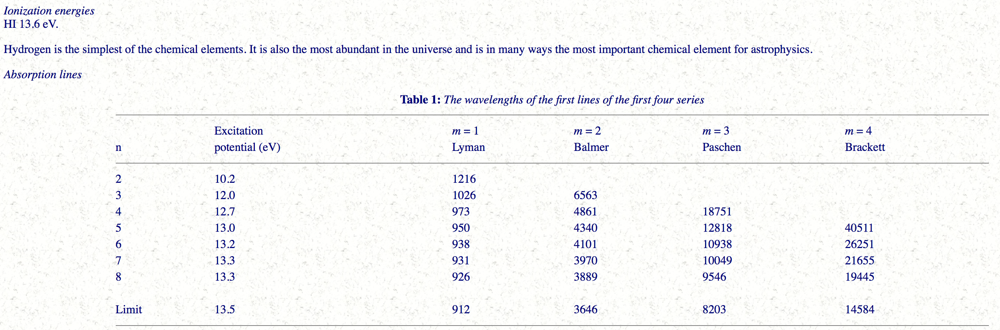

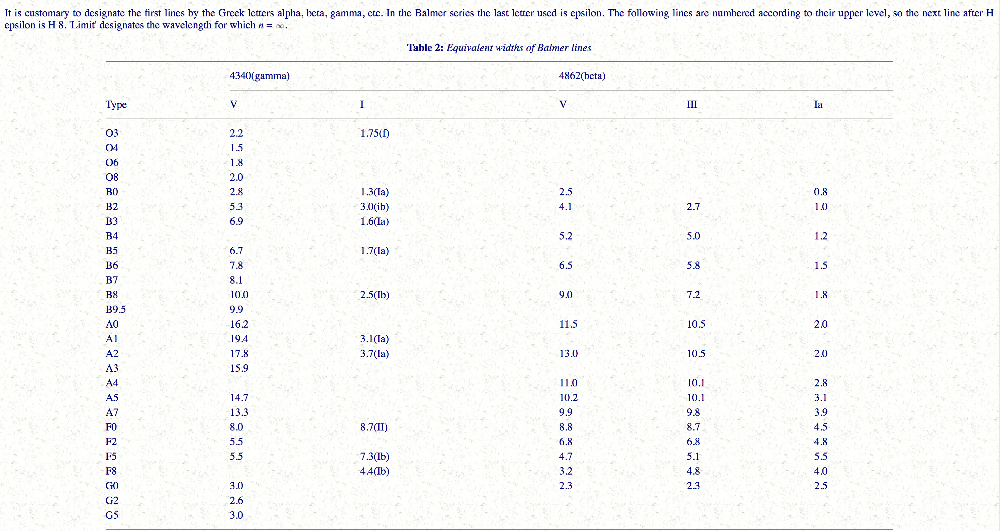

In [15]:
Hydrogen_line = [
    [3750, 'H12',       'r'], # Balmer Series
    [3771, 'H11',       'r'],
    [3798, 'H10',       'r'],
    [3835, 'H9',        'r'],
    [3890, 'H8_zeta',   'r'], 
    [3970, 'H_epsilon', 'r'],   
    [4102, 'H_delta',   'r'],  
    [4341, 'H_gamma',   'r'],
    [4862, 'H_beta',    'r'],
    [6564, 'H_alpha',   'r'],
]

Hydrogen_lines = ['Choose a Hydrogen spectra line'] + sorted(Hydrogen_line)


In [16]:
Small_Hydrogen_line = [
    [3970, 'H_epsilon', 'r'],   
    [4102, 'H_delta',   'r'],  
    [4341, 'H_gamma',   'r'],
    [4862, 'H_beta',    'r'],
    [6564, 'H_alpha',   'r'],
]

Small_Hydrogen_lines = ['Choose a Hydrogen spectra line'] + sorted(Small_Hydrogen_line)


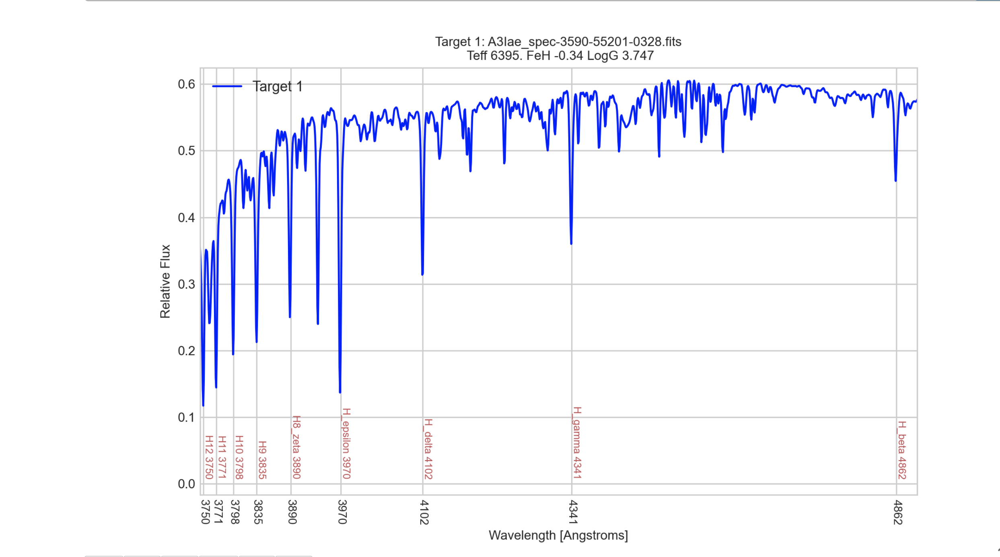

In [17]:
########################################################################################################################

In [18]:
# Helium - HeI and HeII

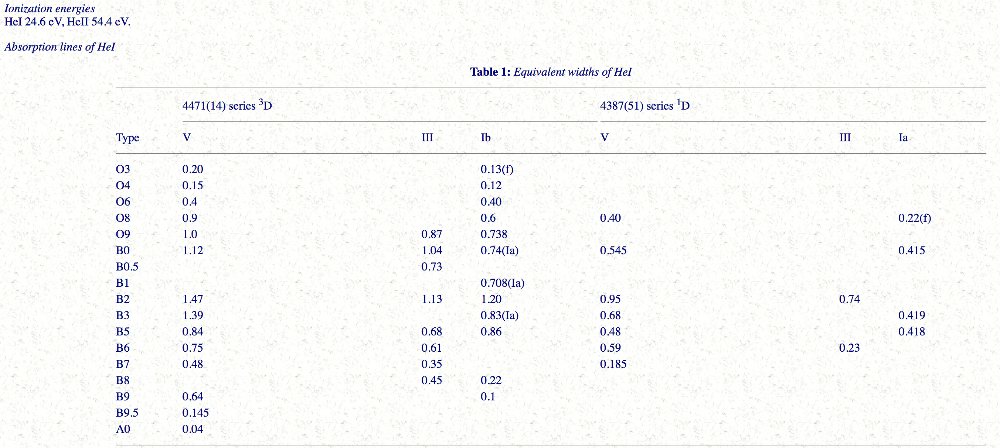

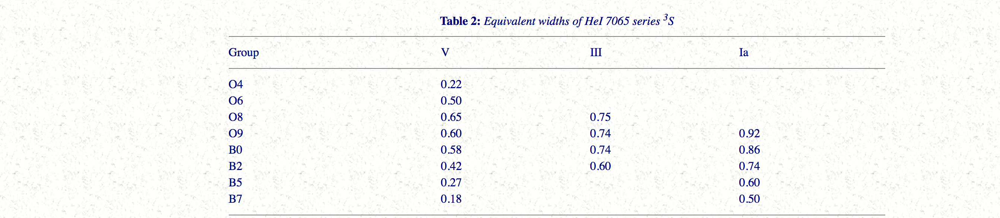

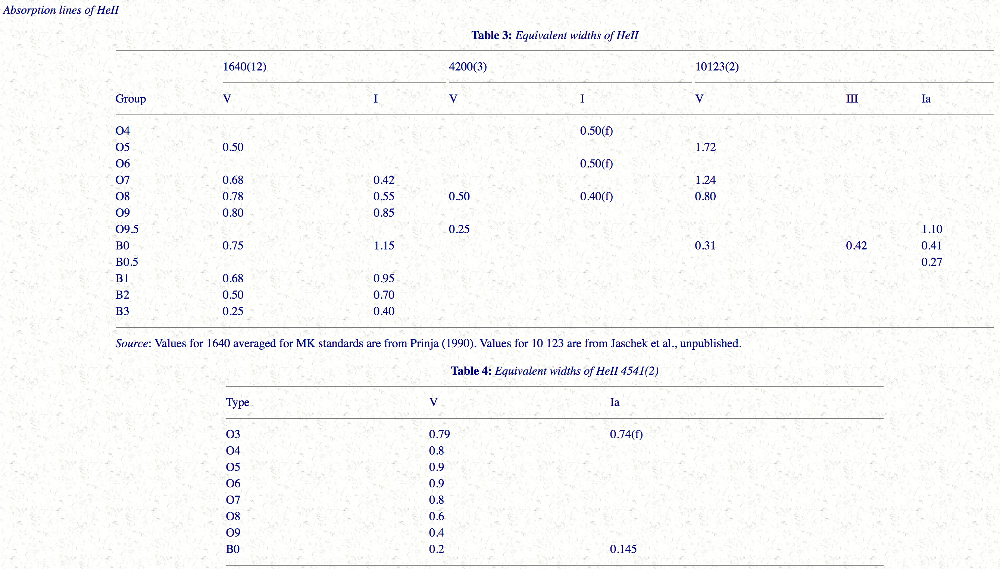

In [19]:
Helium_line = [
   
    [4026, 'He_I',    'orange'],   
    [4387, 'He_I',    'orange'],
    [4471, 'He_I',    'orange'],  
    [4713, 'He_I',    'orange'],   
    [5015, 'He_I',    'orange'],
    [5048, 'He_I',    'orange'],
    [5875, 'He_I',    'orange'], 
    [6678, 'He_I',    'orange'],
    [7065, 'He_I',    'orange'],
    [4200, 'He_II',   'orange'],
    [4339, 'He_II',   'orange'],
    [4541, 'He_II',   'orange'],  
    [4686, 'He_II',   'orange'],
    [5412, 'He_II',   'orange'],
]

Helium_lines = ['Choose a Helium spectra line'] + sorted(Helium_line)


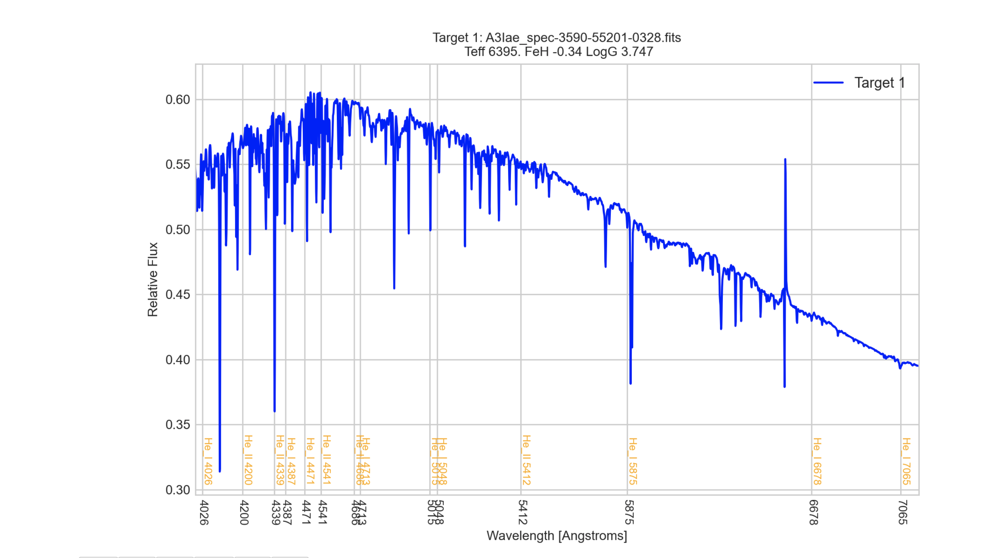

In [20]:
########################################################################################################################

In [21]:
# Calcium - CaI, CaII,  CaIII

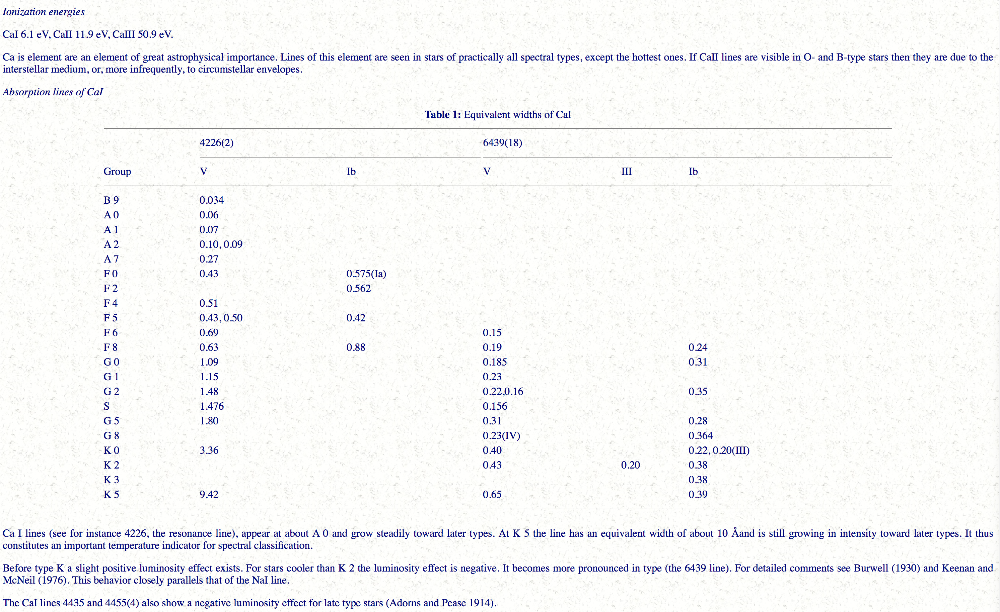

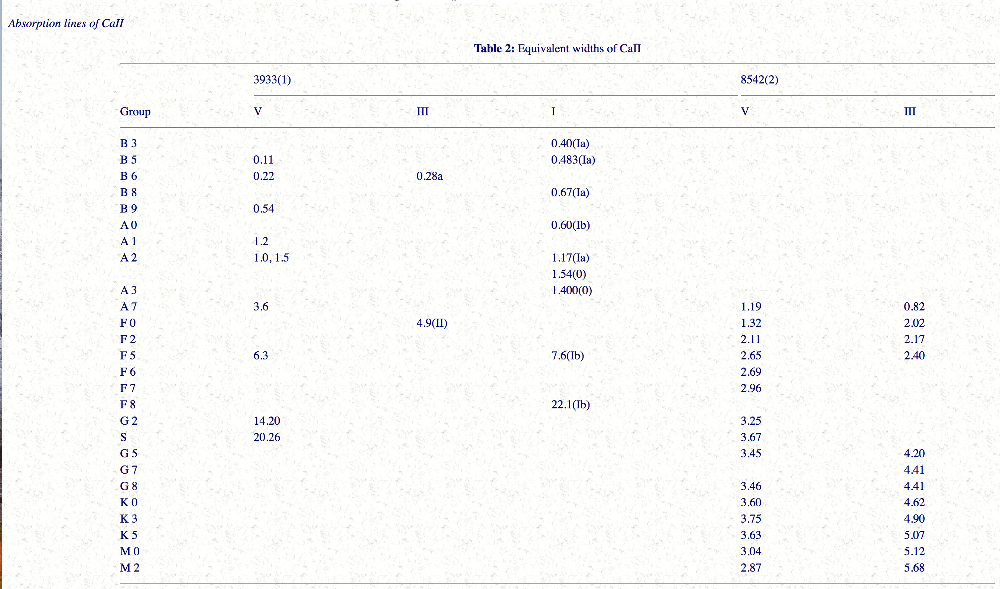

In [22]:
Ca_II_H_K_line = [
    [3934, 'Ca_II_K', 'b'],     # The Fraunhofer Ca II line used as an indicator of metal abundance  
    [3968, 'Ca_II_H', 'b'],     # Singly ionized calcium (Ca II)
]

Ca_II_H_K_lines = ['Choose a Ca II H or K spectra line'] + sorted(Ca_II_H_K_line)


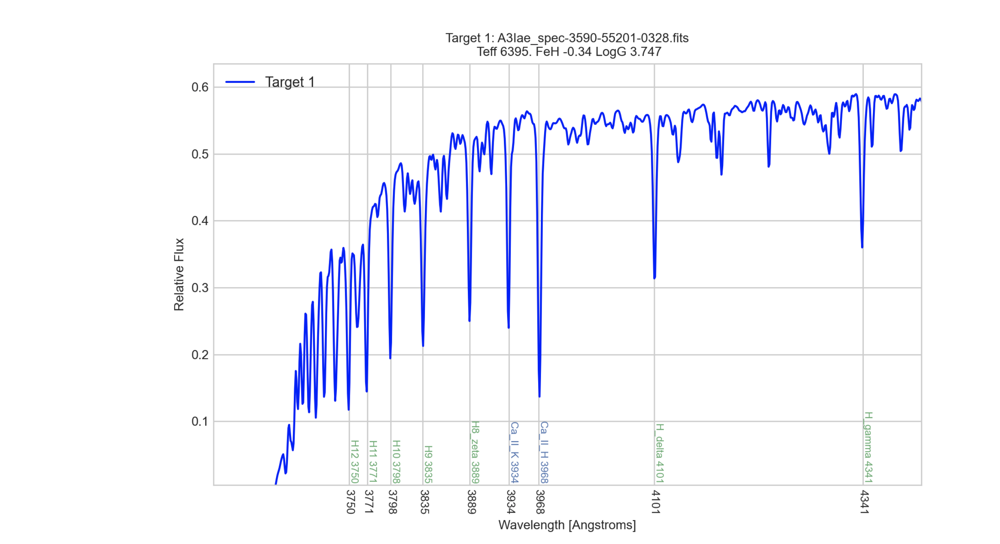

In [23]:
########################################################################################################################

In [24]:
# Oxygen

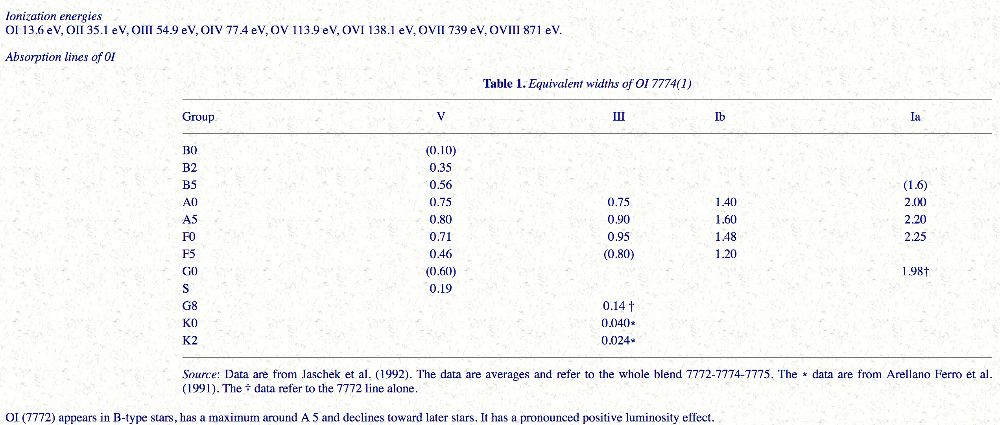

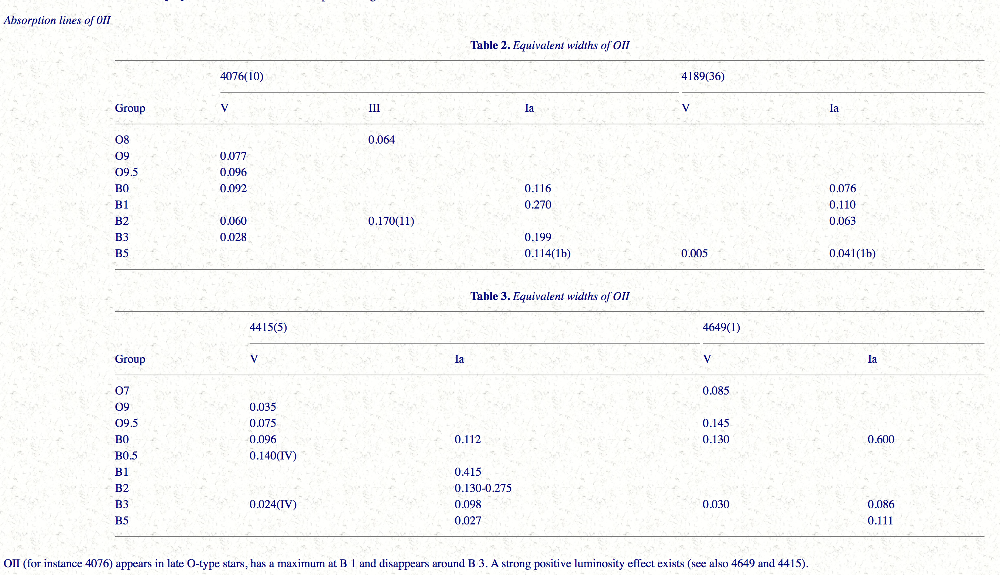

In [25]:
########################################################################################################################

In [26]:
Metals_line = [
    [3934, 'Ca_II_K', 'b'],     # The Fraunhofer Ca II line used as an indicator of metal abundance  
    [3968, 'Ca_II_H', 'b'],     # Singly ionized calcium (Ca II)
    [4649, 'C_III',   'm'], 
    [5696, 'C_III',   'm'],
    [4658, 'C_IV',    'm'],
    [5805, 'C_IV',    'm'],
    [4097, 'N_III',   'm'],
    [4634, 'N_III',   'm'],
    [4058, 'N_IV',    'm'],
    [7100, 'N_IV',    'm'],
    [4605, 'N_V',     'm'],
    [5591, 'O_V',     'm'],
    [5893, 'Na_I',    'r'],
    [5167, 'Mg_I_Triplet', 'aqua'], # Magnesium Triplet
    [5173, 'Mg_I_Triplet', 'aqua'],
    [5183, 'Mg_I_Triplet', 'aqua'],
    [4481, 'Mg_II',   'm'],         #
    [4552, 'Si_III',  'aqua'], 
    [4089, 'Si_IV',   'aqua'],
    [4226, 'Ca_I',    'm'], 
    [4246, 'Sc_II',   'm'], 
    [4444, 'Ti_II',   'm'], 
    [4032, 'Mn_I',    'm'],
    [4045, 'Fe_I',    'm'],
    [4325, 'Fe_I',    'm'],
    [4175, 'Fe_II',   'm'],
    [4233, 'Fe_II',   'm'],
    [4077, 'Sr_II',   'm'],
    [4215, 'Sr_II',   'm'],
    [4358, 'Hg',      'm'],
    [5461, 'Hg',      'm'],
    [5770, 'Hg',      'm'],
    [5790, 'Hg',      'm'],
]

Metals_lines = ['Choose a Metals spectra line'] + sorted(Metals_line)


In [27]:
########################################################################################################################

In [28]:
Molecular_Band_line = [
    [4300, 'CH_G_band', 'aqua'],      
    [3880, 'CN',        'v'], 
    [4217, 'CN',        'v'],
    [7699, 'CN',        'v'],
    [4380, 'C2',        'v'],
    [4738, 'C2',        'v'],
    [5165, 'C2',        'v'],
    [5635, 'C2',        'v'],
    [6123, 'C2',        'v'],
    [4065, 'C3',        'v'],
    [4780, 'MgH',       'v'],
    [4625, 'TiO',       'v'],
    [4670, 'TiO',       'v'],
    [4760, 'TiO',       'v'],
]

Molecular_Band_lines = ['Choose a Molecular_Band spectra line'] + sorted(Molecular_Band_line)


In [29]:
########################################################################################################################

In [30]:
Telluric_Absorption_Band_line = [      
    [5861, 'Telluric',        'k'], 
    [5862, 'Telluric',        'k'],
    [5863, 'Telluric',        'k'],
    [5864, 'Telluric',        'k'],
    [5865, 'Telluric',        'k'],
    [5866, 'Telluric',        'k'],
    [5867, 'Telluric',        'k'],
    [5868, 'Telluric',        'k'],
    [5869, 'Telluric',        'k'],
    [5871, 'Telluric',        'k'], 
    [5872, 'Telluric',        'k'],
    [5873, 'Telluric',        'k'],
    [5874, 'Telluric',        'k'],
    [5940, 'Telluric',        'k'],
    [5945, 'Telluric',        'k'],
    [5950, 'Telluric',        'k'],
    [5955, 'Telluric',        'k'],
    [5960, 'Telluric',        'k'],
    [5965, 'Telluric',        'k'],
    [5970, 'Telluric',        'k'],
    [5975, 'Telluric',        'k'],
    [5980, 'Telluric',        'k'],
    [5985, 'Telluric',        'k'],
    [5990, 'Telluric',        'k'],
]

Telluric_Absorption_Band_lines = ['Choose a Telluric Absorption Band spectra line'] + sorted(Telluric_Absorption_Band_line)


In [31]:
########################################################################################################################

In [32]:
txt = """In Oe stars the feature at 7774 is seen in emission """

In [33]:
Class_O_line = [
    [3725, 'O_II',      'b'],
    [3750, 'H12',       'r'],
    [3771, 'H11',       'r'],
    [3798, 'H10',       'r'],
    [3820, 'He_I',     'orange'],  
    [3835, 'H9',        'r'],
    [3888, 'He_I',     'orange'], 
    [3890, 'H8_zeta',   'r'],
    [3934, 'Ca_II',     'r'],  # The Fraunhofer Ca II line used as an indicator of metal abundance  
    [3965, 'O_III',     'b'],
    [3970, 'H_epsilon', 'r'],
    [4009, 'He_I',     'orange'],
    [4026, 'He_I',     'orange'],  
    [4058, 'N_IV',     'magenta'], 
    [4070, 'O_II',      'b'],
    [4089, 'Si_IV',     'aqua'],
    [4097, 'N_III',     'g'],
    [4102, 'H_delta',  'r'],
    [4116, 'Si_IV',     'aqua'],
    [4121, 'He_I',     'orange'],
    [4144, 'He_I',     'orange'],  
    [4200, 'He_II',    'orange'],   
    [4341, 'H_gamma',  'r'],
    [4379, 'N_III',    'g'],
    [4387, 'He_I',    'orange'],
    [4425, 'N_II',    'g'],       #AAS
    [4471, 'He_I',    'magenta'],
    [4488, 'O_II',    'b'],  
    [4511, 'N_III',   'g'],
    [4515, 'N_III',   'g'],  
    [4541, 'He_II',   'magenta'],  
    [4634, 'N_III',   'magenta'],
    [4640, 'N_III',   'magenta'],
    [4642, 'N_III',   'magenta'],
    [4658, 'C_IV',    'g'],
    [4686, 'He_II',   'orange'],  
    [4713, 'He_I',    'orange'],
    [4862, 'H_beta',  'r'],
    [4922, 'He_I',    'orange'], 
    [4959, 'O_III',   'g'],
    [5007, 'O_III',   'g'],
    [5016, 'He_I',    'orange'],
    [5048, 'He_I',    'orange'],
    [5314, 'N_III',   'g'], 
    [5411, 'He_I',    'orange'],
    [5461, 'Hg',      'k'],
    [5592, 'O_III',   'red'],
    [5696, 'C_III',   'b'],  
    [5801, 'C_IV',    'g'],
    [5812, 'C_IV',    'g'],
    [5876, 'He_I',    'orange'], 
    [5890, 'Na_I',    'r'],         #
    [5896, 'Na_I',    'r'],         #
    [5945, 'Telluric','k'],
    [6282, 'O2_a_band',     'b'],
    [6300, 'O_I',     'b'],
    [6363, 'O_I',     'b'],
    [6560, 'He_II',   'orange'],
    [6564, 'H_alpha', 'r'],         #
    [6678, 'He_I',    'orange'],
    [7037, 'C_III',   'g'],
    [7065, 'He_I',    'orange'],
    #[7066, 'La',      'g'],
    [7774, 'O_I',     'aqua'],
    [8500, 'C_III',   'g'],
    [8498, 'Ca_II',   'r'],
    [8542, 'Ca_II',   'r'],
    [8600, 'Pa14',   'g'],
    [8662, 'Ca_II',   'r'],
    [8752, 'Pa12',   'g'],
    [8865, 'Pa11',   'g'],
    [9017, 'Pa10',   'g'],
    [9229, 'Pa9',   'g'],
    [9546, 'Pa8',   'g'],
    [10048, 'Pa7',   'g'],
]

Class_O_lines = ['Choose a Class O spectra line'] + sorted(Class_O_line)


In [34]:
########################################################################################################################

In [35]:
txt = """
OI (7772) appears in B-type stars, has a maximum around A 5 and declines toward later stars. 
It has a pronounced positive luminosity effect.

In Be stars, the OI 7772 and 8446 lines are often seen in emission

"""

In [36]:
Class_B_line = [
    [3725, 'O_II',      'b'],
    [3750, 'H12',       'r'],
    [3771, 'H11',       'r'],
    [3798, 'H10',       'r'],
    [3835, 'H9',        'r'],       #
    [3890, 'H8_zeta',   'r'],       #
    [3934, 'Ca_II',     'g'],       ## The Fraunhofer Ca II line used as an indicator of metal abundance  
    [3970, 'H_epsilon', 'r'],       #
    [4009, 'He_I',     'orange'],   
    [4027, 'He_I',     'orange'],   #
    [4070, 'O_II',      'b'],
    [4089, 'Si_IV',    'magenta'], 
    [4102, 'H_delta',  'r'],        #
    [4116, 'Si_IV',     'aqua'],
    [4121, 'He_I',     'orange'],
    [4128, 'Si_II',    'magenta'],
    [4130, 'Si_II',    'magenta'],
    [4144, 'He_I',     'orange'],   # He and N lines in emission is a clear indication that material is repelled 
    [4169, 'He_I',     'orange'],
    [4200, 'He_II',    'orange'],  
    [4254, 'O_II',     'b'],
    [4267, 'C_II',     'g'], 
    [4276, 'O_II',     'b'],
    [4284, 'O_II',     'b'],
    [4318, 'O_II',     'b'],
    [4341, 'H_gamma',  'r'],        #
    [4367, 'O_II',     'b'],
    [4388, 'He_I',    'orange'],    #
    [4416, 'O_II',     'b'], 
    [4471, 'He_I',    'magenta'],   #
    [4481, 'Mg_II',   'magenta'],   #
    [4541, 'He_II',   'magenta'],
    [4552, 'Si_III',  'magenta'], 
    [4568, 'Si_III',  'g'],
    [4575, 'Si_III',  'g'],
    [4642, 'N_III',   'aqua'],
    [4650, 'C_III',   'g'], 
    [4676, 'O_II',    'b'],
    [4686, 'He_II',   'orange'], 
    [4713, 'He_I',    'orange'],    #
    [4862, 'H_beta',  'aqua'],      #
    [4922, 'He_I',    'orange'],    #
    [5016, 'He_I',    'aqua'],      #
    [5048, 'He_I',    'orange'],
    [5172, 'Mg_I',    'g'],
    [5411, 'He_II',   'orange'], 
    [5592, 'O_III',   'b'],
    [5696, 'C_III',   'b'],
    [5739, 'Si_III',  'g'],
    [5801, 'C_IV',    'g'],
    [5876, 'He_I',    'orange'],    #
    [5890, 'Na_I',    'r'],         #
    [5896, 'Na_I',    'r'],         #
    [5932, 'N_II',    'g'],         #
    [5942, 'N_II',    'g'],         #
    [6280, 'Telluric','k'],
    [6564, 'H_alpha', 'r'],         #
    [6678, 'He_I',    'aqua'],      #
    [7063, 'Ni_I',    'g'],   
    [7772, 'O_I',     'b'], 
    [8446, 'O_I',     'b'],
    [8498, 'Ca_II',   'r'],
    [8542, 'Ca_II',   'r'],
    [8600, 'Pa14',   'g'],
    [8662, 'Ca_II',   'r'],
    [8752, 'Pa12',   'g'],
    [8865, 'Pa11',   'g'],
    [9017, 'Pa10',   'g'],
    [9229, 'Pa9',   'g'],
    [9546, 'Pa8',   'g'],
    [10048, 'Pa7',   'g'],
]

Class_B_lines = ['Choose a Class B spectra line'] + sorted(Class_B_line)


In [37]:
########################################################################################################################

In [38]:
txt = """
In Be stars, the O_I 7772 and 8446 lines are often seen in emission
"""

In [39]:
Small_Class_Be_line = [
    
    [3820, 'He_I',     'orange'], 
    [4009, 'He_I',     'orange'],   
    
    # Central quasi-emission features
    [4026, 'He_I',     'orange'],   #
    [4471, 'He_I',    'orange'],    #
    [4713, 'He_I',    'orange'], 
    [4921, 'He_I',    'orange'], 
    [5015, 'He_I',    'orange'],  
    [5876, 'He_I',    'orange'],
    [6678, 'He_I',    'orange'],
    [7065, 'He_I',    'orange'],
    
    #[4481, 'Mg_II',   'g'],         #
    
    [4923, 'Fe_II',  'k'],
    [5018, 'Fe_II',  'k'],
    [5169, 'Fe_II',  'k'],
    [5317, 'Fe_II',  'k'],
    
    # Pure shell lines
    [5127, 'Fe_III',  'k'],
    [5156, 'Fe_III',  'k'],
      
            # Broad shallow trough with flat bottom
    [6347, 'Si_II',   'g'],
    [6371, 'Si_II',   'g'],
    
    [8446, 'O_I',  'k'],
    
    [4862, 'H_beta',  'r'],         #
    [6564, 'H_alpha', 'r'],         #
    
    # Photospheric Lines
    [4553, 'Si_III',   'g'],
    [4267, 'C_II',     'g'],
    
    [6280, 'Telluric', 'k']
]

Small_Class_Be_lines = ['Choose a Class Be spectra line'] + sorted(Small_Class_Be_line)


In [40]:
Class_Be_line = [
    [3750, 'H12',       'r'],
    [3771, 'H11',       'r'],
    [3798, 'H10',       'r'],
    [3820, 'He_I',     'orange'],
    [3835, 'H9',        'r'],       #
    [3890, 'H8_zeta',   'r'],       #
    [3934, 'Ca_II',     'r'],       ## The Fraunhofer Ca II line used as an indicator of metal abundance  
    [3970, 'H_epsilon', 'r'],       #
    [4009, 'He_I',     'orange'],   
    [4026, 'He_I',     'orange'],   #
    [4102, 'H_delta',  'r'],        #
    [4267, 'C_II',     'g'], 
    [4341, 'H_gamma',  'r'],        #
    [4388, 'He_I',    'orange'],    #
    [4416, 'O_II',     'g'], 
    [4471, 'He_I',    'orange'],    #
    [4481, 'Mg_II',   'g'],         #
    [4553, 'Si_III',   'g'],
    [4713, 'He_I',    'orange'],
    [4862, 'H_beta',  'r'],         #
    [4921, 'He_I',    'orange'],
    [5015, 'He_I',    'orange'],  
    [5127, 'Fe_III',  'k'],
    [5156, 'Fe_III',  'k'],
    [5169, 'Fe_II',   'k'],
    [5172, 'Mg_I',    'g'],
    [5528, 'Mg_I',    'g'],
    [5876, 'He_I',    'orange'],    
    [6347, 'Si_II',   'g'],
    [6371, 'Si_II',   'g'],
    [6564, 'H_alpha', 'r'],         #
    [6678, 'He_I',    'orange'], 
    [7065, 'He_I',    'orange'],
    [7772, 'O_I',     'g'], 
    [8446, 'O_I',     'g'],
    
    [4923, 'Fe_II',  'k'],
    [5018, 'Fe_II',  'k'],
    [5169, 'Fe_II',  'k'],
    [5317, 'Fe_II',  'k'],
    
    [6512, 'Fe_II',  'k'], # (40)
    [6513, 'Fe_II',  'k'],
    [6514, 'Fe_II',  'k'],
    [6515, 'Fe_II',  'k'],
    [6516, 'Fe_II',  'k'],
    [6517, 'Fe_II',  'k'],
    [6518, 'Fe_II',  'k'],
    
    [6280, 'Telluric', 'k']
]

Class_Be_lines = ['Choose a Class Be spectra line'] + sorted(Class_Be_line)


In [41]:
########################################################################################################################

In [42]:
Class_A_line = [
    [3725, 'O_II',      'b'],
    [3750, 'H12',       'r'],
    [3771, 'H11',       'r'],
    [3798, 'H10',       'r'],
    [3835, 'H9',        'r'],
    [3866, 'Ne_III',    'g'],
    [3890, 'H8_zeta',   'r'],
    [3934, 'Ca_II_K', 'b'],     # The Fraunhofer Ca II line used as an indicator of metal abundance  
    [3970, 'H_epsilon', 'r'],   
    [4102, 'H_delta', 'r'],  
    [4131, 'Si_II',   'k'],
    [4167, 'Mg_I',    'g'],
    [4227, 'Ca_I',    'b'],
    [4299, 'CH_G_band', 'aqua'],     # G-band
    [4341, 'H_gamma', 'r'],
    [4383, 'Fe',      'aqua'],
    [4417, 'O_II',    'aqua'],
    [4481, 'Mg_II',   'aqua'],
    [4862, 'H_beta',  'r'],
    [4890, 'Fe_II',   'k'],
    [4922, 'He_I',    'orange'],    #
    [4957, 'Fe_I',    'k'],
    [5016, 'He_I',    'aqua'],      #
    [5048, 'He_I',    'orange'],
    [5167, 'Mg_I',    'g'],
    [5172, 'Mg_I',    'g'],
    [5184, 'Mg_I',    'g'],
    [5270, 'Fe_I',    'k'],
    [5328, 'Fe_I',    'k'],
    [5411, 'He_II',   'orange'], 
    [6564, 'H_alpha', 'r'],
    [5876, 'He_I',    'orange'],
    [5890, 'Na_I',    'r'],
    [5896, 'Na_I',    'r'],
    [6280, 'Telluric','k'],
    [6347, 'Si_II',    'g'],
    [6371, 'Si_II',    'g'],
    [6455, 'Fe_II',   'k'],
    [7775, 'O',       'g'],
    [8446, 'O_I',     'b'],
    [8498, 'Ca_II',   'r'],
    [8542, 'Ca_II',   'r'],
    [8600, 'Pa14',   'g'],
    [8662, 'Ca_II',   'r'],
    [8752, 'Pa12',   'g'],
    [8865, 'Pa11',   'g'],
    [9017, 'Pa10',   'g'],
    [9229, 'Pa9',   'g'],
    [9546, 'Pa8',   'g'],
    [10048, 'Pa7',   'g'],
]

Class_A_lines = ['Choose a Class A spectra line'] + sorted(Class_A_line)


In [43]:
########################################################################################################################

In [44]:
Class_F_line = [
    [3750, 'H12',       'r'],
    [3771, 'H11',       'r'],
    [3798, 'H10',       'r'],
    [3835, 'H9',      'r'],
    [3890, 'H8_zeta', 'r'],
    [3934, 'Ca_II_K', 'b'],     # The Fraunhofer Ca II line used as an indicator of metal abundance  
    [3968, 'Ca_II_H', 'b'],     # Singly ionized calcium (Ca II)
    [4031, 'Mn_I',    'g'],
    [4102, 'H_delta', 'r'],
    [4173, 'Fe_II',   'g'],  
    [4227, 'Ca_I',    'g'],
    [4299, 'CH_G_band', 'aqua'],     # G-band
    [4341, 'H_gamma', 'r'],
    [4388, 'He_I',    'orange'],
    [4471, 'He_I',    'orange'],   
    [4713, 'He_I',    'orange'],
    [4862, 'H_beta',  'r'],
    [4922, 'He_I',    'orange'],   
    [5016, 'He_I',    'orange'],
    [5167, 'Mg_I',    'g'],
    [5184, 'Mg_I',    'g'],
    [5890, 'Na_I',    'r'],
    [5896, 'Na_I',    'r'],
    [6564, 'H_alpha', 'r'],
    [6678, 'He_I',    'r'],
    [7772, 'O_I',    'g'],
    [8498, 'Ca_II',   'r'],
    [8542, 'Ca_II',   'r'],
    [8600, 'Pa14',   'g'],
    [8662, 'Ca_II',   'r'],
    [8752, 'Pa12',   'g'],
    [8865, 'Pa11',   'g'],
    [9017, 'Pa10',   'g'],
    [9229, 'Pa9',   'g'],
    [9546, 'Pa8',   'g'],
    [10048, 'Pa7',   'g'],
]

Class_F_lines = ['Choose a Class F spectra line'] + sorted(Class_F_line)


In [45]:
########################################################################################################################

In [46]:
txt = """
The infrared triplet at 7772 is among the strongest lines of the chromospheric spectrum of the sun 

"""

In [47]:
Class_G_line = [
    [3750, 'H12',       'r'],
    [3771, 'H11',       'r'],
    [3798, 'H10',       'r'],
    [3834, 'CN',      'g'],
    [3934, 'Ca_II_K', 'b'],     # The Fraunhofer Ca II line used as an indicator of metal abundance  
    [3968, 'Ca_II_H', 'b'],     # Singly ionized calcium (Ca II)
    [4102, 'H_delta', 'r'],
    [4227, 'Ca_I',    'g'],
    [4299, 'CH_G_band', 'aqua'],     # G-band
    [4341, 'H_gamma', 'r'],
    [4388, 'He_I',    'orange'],
    [4862, 'H_beta',  'r'],
    [5167, 'Mg_I',    'g'],
    [5184, 'Mg_I',    'g'],
    [5270, 'Fe_I',    'k'],
    [5328, 'Fe_I',    'k'],
    [5405, 'Fe_I',    'k'],
    [5430, 'Fe_I',    'k'],
    [5477, 'Ni_I',    'b'],
    [5857, 'Ca_I',    'g'],
    [5890, 'Na_I',    'r'],
    [5896, 'Na_I',    'r'],
    [6103, 'Ca_I',    'g'],
    [6122, 'Ca_I',    'g'],
    [6137, 'Fe_I',    'k'],
    [6161, 'Ca_I',    'g'],
    [6170, 'Ca_I',    'g'],
    [6494, 'ZrO',    'g'],
    [6564, 'H_alpha', 'r'],
    [7772, 'O_I',     'g'],
    [7774, 'O_I',     'g'],
    [7775, 'O_I',     'g'],
    [8498, 'Ca_II',   'r'],
    [8542, 'Ca_II',   'r'],
    [8600, 'Pa14',   'g'],
    [8662, 'Ca_II',   'r'],
    [8752, 'Pa12',   'g'],
    [8865, 'Pa11',   'g'],
    [9017, 'Pa10',   'g'],
    [9229, 'Pa9',   'g'],
    [9546, 'Pa8',   'g'],
    [10048, 'Pa7',   'g'],
]

Class_G_lines = ['Choose a Class G spectra line'] + sorted(Class_G_line)


In [48]:
########################################################################################################################

In [49]:
Class_K_line = [
    [3750, 'H12',       'r'],
    [3771, 'H11',       'r'],
    [3798, 'H10',       'r'],
    [3834, 'CN',      'g'],
    [3934, 'Ca_II_K', 'b'],         # The Fraunhofer Ca II line used as an indicator of metal abundance  
    [3968, 'Ca_II_H', 'b'],         # Singly ionized calcium (Ca II)
    [4102, 'H_delta', 'r'],
    [4227, 'Ca_I',    'g'],
    [4299, 'CH_G_band', 'aqua'],    # G-band
    [4341, 'H_gamma', 'r'],
    [4388, 'He_I',    'orange'],
    [4862, 'H_beta',  'r'],
    [5167, 'Mg_I_Triplet', 'aqua'], # Magnesium Triplet
    [5173, 'Mg_I_Triplet', 'aqua'],
    [5184, 'Mg_I_Triplet', 'aqua'],
    [5890, 'Na_I',    'r'],
    [5896, 'Na_I',    'r'],
    [6564, 'H_alpha', 'r'],
    [6713, 'TiO',     'g'],         # Titanium Oxide (TiO)
    [6750, 'CaH',     'b'],
    [6903, 'CaH',     'b'],         # Calcium Hydride (CaH)
    [6921, 'CaH',     'b'],
    [7054, 'TiO',     'g'],
    [7088, 'TiO',     'g'],
    [7126, 'TiO',     'g'],
    [8498, 'Ca_II',   'r'],
    [8542, 'Ca_II',   'r'],
    [8662, 'Ca_II',   'r'],
]

Class_K_lines = ['Choose a Class K spectra line'] + sorted(Class_K_line)


In [50]:
########################################################################################################################

In [51]:
Class_M_line = [
    [3750, 'H12',       'r'],
    [3771, 'H11',       'r'],
    [3798, 'H10',       'r'],
    [3834, 'CN',      'g'],
    [3934, 'Ca_II_K', 'b'],         # The Fraunhofer Ca II line used as an indicator of metal abundance  
    [3968, 'Ca_II_H', 'b'],         # Singly ionized calcium (Ca II)
    [4102, 'H_delta', 'r'],
    [4227, 'Ca_I',    'g'],
    [4299, 'CH_G_band', 'aqua'],    # G-band
    [4341, 'H_gamma', 'r'],
    [4388, 'He_I',    'orange'],
    [4862, 'H_beta',  'r'],
    [5167, 'Mg_I_Triplet', 'aqua'], # Magnesium Triplet
    [5173, 'Mg_I_Triplet', 'aqua'],
    [5184, 'Mg_I_Triplet', 'aqua'],
    [5890, 'Na_I',    'r'],
    [5896, 'Na_I',    'r'],
    [6564, 'H_alpha', 'r'],
    [6713, 'TiO',     'g'],         # Titanium Oxide (TiO)
    [6750, 'CaH',     'b'],
    [6903, 'CaH',     'b'],         # Calcium Hydride (CaH)
    [6921, 'CaH',     'b'],
    [7054, 'TiO',     'g'],
    [7088, 'TiO',     'g'],
    [7126, 'TiO',     'g'],
    [8498, 'Ca_II',   'r'],
    [8542, 'Ca_II',   'r'],
    [8662, 'Ca_II',   'r'],
]

Class_M_lines = ['Choose a Class K spectra line'] + sorted(Class_M_line)


In [52]:
########################################################################################################################

In [53]:
All_idx    = []
Ar_III_idx = []
Ba_II_idx  = []
C_idx      = []
C_I_idx    = []
C_II_idx   = []
C_III_idx  = []
C_IV_idx   = []
C2_idx     = []
C3_idx     = []
Ca_idx     = []
Ca_I_idx   = []
Ca_II_idx  = []
Ca_II_H_idx  = []
Ca_II_K_idx  = []
CaH_idx    = []
CH_idx     = []
CH_G_band_idx = []
Cn_idx     = []
CN_idx     = []
CO_idx     = []
Cr_idx     = []
Cr_I_idx   = []
Cr_II_idx  = []
Fe_idx     = []
Fe_I_idx   = []
Fe_II_idx  = []
Fe_III_idx  = []
H_idx      = []
Hg_idx      = []
H8_zeta_idx   = []
H9_idx        = []
H10_idx       = []
H11_idx       = []
H12_idx       = []
H_epsilon_idx = []
H_delta_idx   = []
H_gamma_idx   = []
H_beta_idx    = []
H_alpha_idx   = []
h_idx      = []
He_I_idx   = []
He_II_idx  = []
La_idx     = []
Li_idx     = []
Li_I_idx   = []
Mg_idx     = []
Mg_I_idx   = []
Mg_I_Triplet_idx   = []
Mg_II_idx  = []
MgH_idx    = []
MgO_idx    = []
Mn_I_idx   = []
N_II_idx   = []
N_III_idx  = []
N_IV_idx   = []
N_V_idx    = []
Na_I_idx   = []
Ne_III_idx = []
Ni_I_idx   = []
O_idx      = []
O_I_idx    = []
O_II_idx   = []
O_II_V_idx = []
O_III_idx  = []
O_V_idx    = []
O2_a_band_idx    = []
O2_A_band_idx    = []
O2_B_band_idx    = []
Pa7_idx    = []
Pa8_idx    = []
Pa9_idx    = []
Pa10_idx    = []
Pa11_idx    = []
Pa12_idx    = []
Pa13_idx    = []
Pa14_idx    = []
S_idx      = []
S_II_idx   = []
S_III_idx  = []
Sc_I_idx   = []
Sc_II_idx  = []
Si_idx     = []
Si_II_idx  = []
Si_III_idx = []
Si_IV_idx  = []
SiC2_idx   = []
Si_idx     = []
Sr_II_idx  = []
Telluric_idx = []
Ti_idx     = []
Ti_I_idx   = []
Ti_II_idx  = []
TiO_idx    = []
V_I_idx    = []
VI_CaI_idx = []
VO_idx     = []
Zr_II_idx  = []
ZrO_idx    = []

In [34]:

#MgO = (5007) # duplicate with O_III


In [56]:

##################################################

ck_All = Checkbox(False, description='All')
                
def All_changed(event):
    list   = df_Lines.SpectraLine
    
    for i in df_Lines.index:
        if ck_All.value == True:
            Apply_annotate(df_Lines["SpectraLine"][i], y_size, df_Lines["Element"][i], 'g', All_idx)
            xticks[t.index(df_Lines["SpectraLine"][i])].set_visible(True)
        else:
            xticks[t.index(df_Lines["SpectraLine"][i])].set_visible(False)
            for a in All_idx:
                a.remove()
            All_idx[:] = []
                   
ck_All.observe(All_changed, names=['value'])

##################################################

ck_Hydrogen = Checkbox(False, description='Hydrogen')
                
def Hydrogen_changed(event):
    out.clear_output()
    with out:
        display(HTML('https://ned.ipac.caltech.edu/level5/Glossary/Jaschek/H.html'))
    for i in range(1, len(Hydrogen_lines)):
        if ck_Hydrogen.value == True:
            Apply_annotate(Hydrogen_lines[i][0], y_size, Hydrogen_lines[i][1], 'r', 
                   eval(str(Hydrogen_lines[i][1]) + '_idx'))
            xticks[t.index(Hydrogen_lines[i][0])].set_visible(True)
        else:
            xticks[t.index(Hydrogen_lines[i][0])].set_visible(False)
            for a in eval(str(Hydrogen_lines[i][1]) + '_idx'):
                a.remove()
            eval(str(Hydrogen_lines[i][1]) + '_idx')[:] = []
    
ck_Hydrogen.observe(Hydrogen_changed, names=['value'])


##################################################

ck_Small_Hydrogen = Checkbox(False, description='Small Hydrogen')
                
def Small_Hydrogen_changed(event):
    out.clear_output()
    with out:
        display(HTML('https://ned.ipac.caltech.edu/level5/Glossary/Jaschek/H.html'))
    for i in range(1, len(Small_Hydrogen_lines)):
        if ck_Small_Hydrogen.value == True:
            Apply_annotate(Small_Hydrogen_lines[i][0], y_size, Small_Hydrogen_lines[i][1], 'r', 
                   eval(str(Small_Hydrogen_lines[i][1]) + '_idx'))
            xticks[t.index(Small_Hydrogen_lines[i][0])].set_visible(True)
        else:
            xticks[t.index(Small_Hydrogen_lines[i][0])].set_visible(False)
            for a in eval(str(Small_Hydrogen_lines[i][1]) + '_idx'):
                a.remove()
            eval(str(Small_Hydrogen_lines[i][1]) + '_idx')[:] = []
    
ck_Small_Hydrogen.observe(Small_Hydrogen_changed, names=['value'])


##################################################


ck_Helium = Checkbox(False, description='Helium')
                
def Helium_changed(event):
    out.clear_output()
    with out:
        display(HTML('https://ned.ipac.caltech.edu/level5/Glossary/Jaschek/He.html'))
    for i in range(1, len(Helium_lines)):
        if ck_Helium.value == True:
            Apply_annotate(Helium_lines[i][0], y_size, Helium_lines[i][1], 'orange', 
                   eval(str(Helium_lines[i][1]) + '_idx'))
            xticks[t.index(Helium_lines[i][0])].set_visible(True)
        else:
            xticks[t.index(Helium_lines[i][0])].set_visible(False)
            for a in eval(str(Helium_lines[i][1]) + '_idx'):
                a.remove()
            eval(str(Helium_lines[i][1]) + '_idx')[:] = []
    
ck_Helium.observe(Helium_changed, names=['value'])


##################################################

ck_Ca_II_H_K = Checkbox(False, description='Ca II H and K')
                
def Ca_II_H_K_changed(event):
    out.clear_output()
    with out:
        display(HTML('https://ned.ipac.caltech.edu/level5/Glossary/Jaschek/Ca.html'))
    for i in range(1, len(Ca_II_H_K_lines)):
        if ck_Ca_II_H_K.value == True:
            Apply_annotate(Ca_II_H_K_lines[i][0], y_size, Ca_II_H_K_lines[i][1], 'b', 
                   eval(str(Ca_II_H_K_lines[i][1]) + '_idx'))
            xticks[t.index(Ca_II_H_K_lines[i][0])].set_visible(True)
        else:
            xticks[t.index(Ca_II_H_K_lines[i][0])].set_visible(False)
            for a in eval(str(Ca_II_H_K_lines[i][1]) + '_idx'):
                a.remove()
            eval(str(Ca_II_H_K_lines[i][1]) + '_idx')[:] = []
    
ck_Ca_II_H_K.observe(Ca_II_H_K_changed, names=['value'])


##################################################

ck_Metals = Checkbox(False, description='Metals')
                
def Metals_changed(event):
    for i in range(1, len(Metals_lines)):
        if ck_Metals.value == True:
            Apply_annotate(Metals_lines[i][0], y_size, Metals_lines[i][1], 'm', 
                   eval(str(Metals_lines[i][1]) + '_idx'))
            xticks[t.index(Metals_lines[i][0])].set_visible(True)
        else:
            xticks[t.index(Metals_lines[i][0])].set_visible(False)
            for a in eval(str(Metals_lines[i][1]) + '_idx'):
                a.remove()
            eval(str(Metals_lines[i][1]) + '_idx')[:] = []
    
ck_Metals.observe(Metals_changed, names=['value'])


##################################################

ck_Molecular_Band = Checkbox(False, description='Molecular Bands')
            
def Molecular_Band_changed(event):
    for i in range(1, len(Molecular_Band_lines)):
        if ck_Molecular_Band.value == True:
            Apply_annotate(Molecular_Band_lines[i][0], y_size, Molecular_Band_lines[i][1], 'g', 
                   eval(str(Molecular_Band_lines[i][1]) + '_idx'))
            xticks[t.index(Molecular_Band_lines[i][0])].set_visible(True)
        else:
            xticks[t.index(Molecular_Band_lines[i][0])].set_visible(False)
            for a in eval(str(Molecular_Band_lines[i][1]) + '_idx'):
                a.remove()
            eval(str(Molecular_Band_lines[i][1]) + '_idx')[:] = []
    
ck_Molecular_Band.observe(Molecular_Band_changed, names=['value'])


##################################################

ck_Telluric_Absorption = Checkbox(False, description='Telluric Absorption Bands')
            
def Telluric_Absorption_changed(event):
    out1.clear_output()
    out2.clear_output()
    """with out1:
        display(Image(filename="/Volumes/HD_2018_2019/Boss Fits/Telluric_I.png", width =900))
    with out2:
        display(Image(filename="/Volumes/HD_2018_2019/Boss Fits/Telluric_2.png", width =900))"""
    for i in range(1, len(Telluric_Absorption_Band_lines)):
        if ck_Telluric_Absorption.value == True:
            Apply_annotate(Telluric_Absorption_Band_lines[i][0], y_size, Telluric_Absorption_Band_lines[i][1], 'k', 
                   eval(str(Telluric_Absorption_Band_lines[i][1]) + '_idx'))
            xticks[t.index(Telluric_Absorption_Band_lines[i][0])].set_visible(True)
        else:
            xticks[t.index(Telluric_Absorption_Band_lines[i][0])].set_visible(False)
            for a in eval(str(Telluric_Absorption_Band_lines[i][1]) + '_idx'):
                a.remove()
            eval(str(Telluric_Absorption_Band_lines[i][1]) + '_idx')[:] = []
    
ck_Telluric_Absorption.observe(Telluric_Absorption_changed, names=['value'])


##################################################

ck_Special = Checkbox(False, description='Special')
                
def Special_changed(event):
    for i in range(1, len(emission_lines)):
        if ck_Special.value == True:
            Apply_annotate(emission_lines[i][0], y_size, emission_lines[i][1], 'g', 
                   eval(str(emission_lines[i][1]) + '_idx'))
            xticks[t.index(emission_lines[i][0])].set_visible(True)
        else:
            xticks[t.index(emission_lines[i][0])].set_visible(False)
            for a in eval(str(emission_lines[i][1]) + '_idx'):
                a.remove()
            eval(str(emission_lines[i][1]) + '_idx')[:] = []
    
ck_Special.observe(Special_changed, names=['value'])


##################################################

ck_Emission = Checkbox(False, description='Emission')
                
def Emission_changed(event):
    for i in range(1, len(emission_lines)):
        if ck_Emission.value == True:
            Apply_annotate(emission_lines[i][0], y_size, emission_lines[i][1], 'g', 
                   eval(str(emission_lines[i][1]) + '_idx'))
            xticks[t.index(emission_lines[i][0])].set_visible(True)
        else:
            xticks[t.index(emission_lines[i][0])].set_visible(False)
            for a in eval(str(emission_lines[i][1]) + '_idx'):
                a.remove()
            eval(str(emission_lines[i][1]) + '_idx')[:] = []
    
ck_Emission.observe(Emission_changed, names=['value'])


##################################################

ck_He_I_Emission = Checkbox(False, description='He_I_Emission')
                
def He_I_Emission_changed(event):
    for i in range(1, len(He_I_emission_lines)):
        if ck_He_I_Emission.value == True:
            Apply_annotate(He_I_emission_lines[i][0], y_size, He_I_emission_lines[i][1], 'g', 
                   eval(str(He_I_emission_lines[i][1]) + '_idx'))
            xticks[t.index(He_I_emission_lines[i][0])].set_visible(True)
        else:
            xticks[t.index(He_I_emission_lines[i][0])].set_visible(False)
            for a in eval(str(He_I_emission_lines[i][1]) + '_idx'):
                a.remove()
            eval(str(He_I_emission_lines[i][1]) + '_idx')[:] = []
    
ck_He_I_Emission.observe(He_I_Emission_changed, names=['value'])


##################################################

ck_Fe_II_Emission = Checkbox(False, description='Fe_II_Emission')
                
def Fe_II_Emission_changed(event):
    for i in range(1, len(Fe_II_emission_lines)):
        if ck_Fe_II_Emission.value == True:
            Apply_annotate(Fe_II_emission_lines[i][0], y_size, Fe_II_emission_lines[i][1], 'g', 
                   eval(str(Fe_II_emission_lines[i][1]) + '_idx'))
            xticks[t.index(Fe_II_emission_lines[i][0])].set_visible(True)
        else:
            xticks[t.index(Fe_II_emission_lines[i][0])].set_visible(False)
            for a in eval(str(Fe_II_emission_lines[i][1]) + '_idx'):
                a.remove()
            eval(str(Fe_II_emission_lines[i][1]) + '_idx')[:] = []
    
ck_Fe_II_Emission.observe(Fe_II_Emission_changed, names=['value'])


##################################################

ck_Class_SDSS = Checkbox(False, description='Class SDSS')
                
def Class_SDSS_changed(event):
    for i in range(1, len(Class_SDSS_lines)):
        if ck_Class_SDSS.value == True:
            Apply_annotate(Class_SDSS_lines[i][0], y_size, Class_SDSS_lines[i][1],  str(Class_SDSS_lines[i][2]), 
                   eval(str(Class_SDSS_lines[i][1]) + '_idx'))
            xticks[t.index(Class_SDSS_lines[i][0])].set_visible(True)
        else:
            xticks[t.index(Class_SDSS_lines[i][0])].set_visible(False)
            for a in eval(str(Class_SDSS_lines[i][1]) + '_idx'):
                a.remove()
            eval(str(Class_SDSS_lines[i][1]) + '_idx')[:] = []
    
ck_Class_SDSS.observe(Class_SDSS_changed, names=['value'])

##################################################

ck_Class_O = Checkbox(False, description='Class O')
                
def Class_O_changed(event):
    if ck_Class_O.value == True:
        out.clear_output()
        out1.clear_output()
        out2.clear_output()
        out3.clear_output()
        notes.clear_output()
        
        """with out1:
            display(Image(filename="/Volumes/HD_2018_2019/Boss Fits/Class_O_1.png", width =900))
        with out2:
            display(Image(filename="/Volumes/HD_2018_2019/Boss Fits/Class_O_2.png", width =900))
        with out3:
            display(Image(filename="/Volumes/HD_2018_2019/Boss Fits/Class_O_3.png", width =900))"""
        with out:
            display(HTML('https://en.wikipedia.org/wiki/O-type_star'))
        with notes:
            print(Class_O_notes)
        
        for i in range(1, len(Class_O_lines)):
            Apply_annotate(Class_O_lines[i][0], y_size, Class_O_lines[i][1], str(Class_O_lines[i][2]), 
                   eval(str(Class_O_lines[i][1]) + '_idx'))
            xticks[t.index(Class_O_lines[i][0])].set_visible(True)
            
    else:
        out.clear_output()
        out1.clear_output()
        out2.clear_output()
        out3.clear_output()
        notes.clear_output()
        
        for i in range(1, len(Class_O_lines)):
            xticks[t.index(Class_O_lines[i][0])].set_visible(False)
            for a in eval(str(Class_O_lines[i][1]) + '_idx'):
                a.remove()
            eval(str(Class_O_lines[i][1]) + '_idx')[:] = []
            
    
ck_Class_O.observe(Class_O_changed, names=['value'])

##################################################

ck_Class_B = Checkbox(False, description='Class B')
                
def Class_B_changed(event):
    if ck_Class_B.value == True:
        out.clear_output()
        out1.clear_output()
        out2.clear_output()
        out3.clear_output()
        out4.clear_output()
        out5.clear_output()
        notes.clear_output()
        
        """with out2:
            display(Image(filename="/Volumes/HD_2018_2019/Boss Fits/Class_B_1.png", width =900))
        with out3:
            display(Image(filename="/Volumes/HD_2018_2019/Boss Fits/Class_B_2.png", width =900))
        with out4:
            display(Image(filename="/Volumes/HD_2018_2019/Boss Fits/Class_B_3.png", width =900))
        with out5:
            display(Image(filename="/Volumes/HD_2018_2019/Boss Fits/B2_A6_F4.png", width =900))"""
        with out1:
            display(HTML('https://en.wikipedia.org/wiki/B-type_main-sequence_star'))
        with out:
            display(HTML('https://www.cfa.harvard.edu/~pberlind/atlas/htmls/bstars.html'))
        with notes:
            print(Class_B_notes)
        
        for i in range(1, len(Class_B_lines)):
            Apply_annotate(Class_B_lines[i][0], y_size, Class_B_lines[i][1], str(Class_B_lines[i][2]), 
                   eval(str(Class_B_lines[i][1]) + '_idx'))
            xticks[t.index(Class_B_lines[i][0])].set_visible(True)
            
    else:
        out.clear_output()
        out1.clear_output()
        out2.clear_output()
        out3.clear_output()
        out4.clear_output()
        out5.clear_output()
        notes.clear_output()
        
        for i in range(1, len(Class_B_lines)):
            xticks[t.index(Class_B_lines[i][0])].set_visible(False)
            for a in eval(str(Class_B_lines[i][1]) + '_idx'):
                a.remove()
            eval(str(Class_B_lines[i][1]) + '_idx')[:] = []
            
            
ck_Class_B.observe(Class_B_changed, names=['value'])

##################################################

ck_Class_Be = Checkbox(False, description='Class Be')
                
def Class_Be_changed(event):
    if ck_Class_Be.value == True:
        out.clear_output()
        out1.clear_output()
        notes.clear_output()
        
        with out:
            display(HTML('https://www.cfa.harvard.edu/~pberlind/atlas/htmls/bstars.html'))
        with out1:
            display(HTML('https://en.wikipedia.org/wiki/B-type_main-sequence_star'))
        with notes:
            print(Class_B_notes)
        
        for i in range(1, len(Class_Be_lines)):
            Apply_annotate(Class_Be_lines[i][0], y_size, Class_Be_lines[i][1], str(Class_Be_lines[i][2]), 
                   eval(str(Class_Be_lines[i][1]) + '_idx'))
            xticks[t.index(Class_Be_lines[i][0])].set_visible(True)
            
    else:
        out.clear_output()
        out1.clear_output()
        notes.clear_output()
        
        for i in range(1, len(Class_Be_lines)):
            xticks[t.index(Class_Be_lines[i][0])].set_visible(False)
            for a in eval(str(Class_Be_lines[i][1]) + '_idx'):
                a.remove()
            eval(str(Class_Be_lines[i][1]) + '_idx')[:] = []
            
    
ck_Class_Be.observe(Class_Be_changed, names=['value'])

##################################################

ck_Small_Class_Be = Checkbox(False, description='Small Class Be')
                
def Small_Class_Be_changed(event):
    if ck_Small_Class_Be.value == True:
        out.clear_output()
        out1.clear_output()
        notes.clear_output()
        
        with out:
            display(HTML('https://www.cfa.harvard.edu/~pberlind/atlas/htmls/bstars.html'))
        with out1:
            display(HTML('https://en.wikipedia.org/wiki/B-type_main-sequence_star'))
        with notes:
            print(Class_B_notes)
        
        for i in range(1, len(Small_Class_Be_lines)):
            Apply_annotate(Small_Class_Be_lines[i][0], y_size, Small_Class_Be_lines[i][1], str(Small_Class_Be_lines[i][2]), 
                   eval(str(Small_Class_Be_lines[i][1]) + '_idx'))
            xticks[t.index(Small_Class_Be_lines[i][0])].set_visible(True)
            
    else:
        out.clear_output()
        out1.clear_output()
        notes.clear_output()
        
        for i in range(1, len(Small_Class_Be_lines)):
            xticks[t.index(Small_Class_Be_lines[i][0])].set_visible(False)
            for a in eval(str(Small_Class_Be_lines[i][1]) + '_idx'):
                a.remove()
            eval(str(Small_Class_Be_lines[i][1]) + '_idx')[:] = []
            
    
ck_Small_Class_Be.observe(Small_Class_Be_changed, names=['value'])

##################################################

ck_Class_A = Checkbox(False, description='Class A')
                
def Class_A_changed(event):
    if ck_Class_A.value == True:
        out.clear_output()
        out1.clear_output()
        out2.clear_output()
        out3.clear_output()
        out4.clear_output()
        out5.clear_output()
        notes.clear_output()
        
        """with out1:
            display(Image(filename="/Volumes/HD_2018_2019/Boss Fits/Class_A_1.png", width =900))
        with out2:
            display(Image(filename="/Volumes/HD_2018_2019/Boss Fits/Class_A_2.png", width =900))
        with out3:
            display(Image(filename="/Volumes/HD_2018_2019/Boss Fits/Class_A_3.png", width =900))
        with out4:
            display(Image(filename="/Volumes/HD_2018_2019/Boss Fits/Class_A_4.png", width =900))
        with out5:
            display(Image(filename="/Volumes/HD_2018_2019/Boss Fits/B2_A6_F4.png", width =900))"""
        with out:
            display(HTML('https://en.wikipedia.org/wiki/A-type_main-sequence_star'))
        with notes:
            print(Class_A_notes)
        
        for i in range(1, len(Class_A_lines)):
            Apply_annotate(Class_A_lines[i][0], y_size, Class_A_lines[i][1], str(Class_A_lines[i][2]), 
                   eval(str(Class_A_lines[i][1]) + '_idx'))
            xticks[t.index(Class_A_lines[i][0])].set_visible(True)
            
    else:
        out.clear_output()
        out1.clear_output()
        out2.clear_output()
        out3.clear_output()
        out4.clear_output()
        out5.clear_output()
        notes.clear_output()
        
        for i in range(1, len(Class_A_lines)):
            xticks[t.index(Class_A_lines[i][0])].set_visible(False)
            for a in eval(str(Class_A_lines[i][1]) + '_idx'):
                a.remove()
            eval(str(Class_A_lines[i][1]) + '_idx')[:] = []
            
    
ck_Class_A.observe(Class_A_changed, names=['value'])

##################################################

ck_Class_Am = Checkbox(False, description='Class Am')
                
def Class_Am_changed(event):
    if ck_Class_Am.value == True:
        out.clear_output()
        out1.clear_output()
        out2.clear_output()
        out3.clear_output()
        out4.clear_output()
        out5.clear_output()
        out6.clear_output()
        out7.clear_output()
        notes.clear_output()
        
        """with out:
            display(Image(filename="/Volumes/HD_2018_2019/Boss Fits/Sirius_0.png", width =900))
        with out1:
            display(Image(filename="/Volumes/HD_2018_2019/Boss Fits/Sirius_1.png", width =900))
        with out2:
            display(Image(filename="/Volumes/HD_2018_2019/Boss Fits/Sirius_2.png", width =900))
        with out3:
            display(Image(filename="/Volumes/HD_2018_2019/Boss Fits/Sirius_3.png", width =900))
        with out4:
            display(Image(filename="/Volumes/HD_2018_2019/Boss Fits/Sirius_4.png", width =900))
        with out5:
            display(Image(filename="/Volumes/HD_2018_2019/Boss Fits/Sirius_5.png", width =900))
        with out6:
            display(Image(filename="/Volumes/HD_2018_2019/Boss Fits/Sirius_6.png", width =900))
        with out7:
            display(Image(filename="/Volumes/HD_2018_2019/Boss Fits/Sirius_7.png", width =900))"""
        with notes:
            print(Class_A_notes)
        
        for i in range(1, len(Class_A_lines)):
            Apply_annotate(Class_A_lines[i][0], y_size, Class_A_lines[i][1], str(Class_A_lines[i][2]), 
                   eval(str(Class_A_lines[i][1]) + '_idx'))
            xticks[t.index(Class_A_lines[i][0])].set_visible(True)
            
    else:
        out.clear_output()
        out1.clear_output()
        out2.clear_output()
        out3.clear_output()
        out4.clear_output()
        notes.clear_output()
        
        for i in range(1, len(Class_A_lines)):
            xticks[t.index(Class_A_lines[i][0])].set_visible(False)
            for a in eval(str(Class_A_lines[i][1]) + '_idx'):
                a.remove()
            eval(str(Class_A_lines[i][1]) + '_idx')[:] = []
            
            
ck_Class_Am.observe(Class_Am_changed, names=['value'])

##################################################

ck_Class_F = Checkbox(False, description='Class F')
                
def Class_F_changed(event):
    if ck_Class_F.value == True:
        out.clear_output()
        out1.clear_output()
        out2.clear_output()
        out3.clear_output()
        notes.clear_output()
        
        """with out1:
            display(Image(filename="/Volumes/HD_2018_2019/Boss Fits/Class_F_1.png", width =900))
        with out2:
            display(Image(filename="/Volumes/HD_2018_2019/Boss Fits/Class_F_2.png", width =900))
        with out3:
            display(Image(filename="/Volumes/HD_2018_2019/Boss Fits/B2_A6_F4.png", width =900))"""
        with out:
            display(HTML('https://en.wikipedia.org/wiki/F-type_main-sequence_star'))
        with notes:
            print(Class_F_notes)
        
        for i in range(1, len(Class_F_lines)):
            Apply_annotate(Class_F_lines[i][0], y_size, Class_F_lines[i][1], str(Class_F_lines[i][2]), 
                   eval(str(Class_F_lines[i][1]) + '_idx'))
            xticks[t.index(Class_F_lines[i][0])].set_visible(True)
            
    else:
        out.clear_output()
        out1.clear_output()
        out2.clear_output()
        out3.clear_output()
        notes.clear_output()
        
        for i in range(1, len(Class_F_lines)):
            xticks[t.index(Class_F_lines[i][0])].set_visible(False)
            for a in eval(str(Class_F_lines[i][1]) + '_idx'):
                a.remove()
            eval(str(Class_F_lines[i][1]) + '_idx')[:] = []
            
            
ck_Class_F.observe(Class_F_changed, names=['value'])

##################################################

ck_Class_G = Checkbox(False, description='Class G')
                
def Class_G_changed(event):
    if ck_Class_G.value == True:
        out.clear_output()
        out1.clear_output()
        out2.clear_output()
        out3.clear_output()
        out4.clear_output()
        notes.clear_output()
        
        """ with out1:
            display(Image(filename="/Volumes/HD_2018_2019/Boss Fits/Class_G_1.png", width =900))
        with out2:
            display(Image(filename="/Volumes/HD_2018_2019/Boss Fits/Class_G_2.png", width =900))
        with out3:
            display(Image(filename="/Volumes/HD_2018_2019/Boss Fits/Class_G_3.png", width =900))
        with out4:
            display(Image(filename="/Volumes/HD_2018_2019/Boss Fits/G4_K4_M2.png", width =900))"""
        with out:
            display(HTML('https://en.wikipedia.org/wiki/G-type_main-sequence_star'))
        with notes:
            print(Class_G_notes)
        
        for i in range(1, len(Class_G_lines)):
            Apply_annotate(Class_G_lines[i][0], y_size, Class_G_lines[i][1], str(Class_G_lines[i][2]), 
                   eval(str(Class_G_lines[i][1]) + '_idx'))
            xticks[t.index(Class_G_lines[i][0])].set_visible(True)
            
    else:
        out.clear_output()
        out1.clear_output()
        out2.clear_output()
        out3.clear_output()
        out4.clear_output()
        notes.clear_output()
        
        for i in range(1, len(Class_G_lines)):
            xticks[t.index(Class_G_lines[i][0])].set_visible(False)
            for a in eval(str(Class_G_lines[i][1]) + '_idx'):
                a.remove()
            eval(str(Class_G_lines[i][1]) + '_idx')[:] = []
            
    
ck_Class_G.observe(Class_G_changed, names=['value'])

##################################################

ck_Class_K = Checkbox(False, description='Class K')
                
def Class_K_changed(event):
    if ck_Class_K.value == True:
        out.clear_output()
        out1.clear_output()
        out2.clear_output()
        out3.clear_output()
        out4.clear_output()
        out5.clear_output()
        notes.clear_output()
        
        """with out1:
            display(Image(filename="/Volumes/HD_2018_2019/Boss Fits/Class_K_1.png", width =900))
        with out2:
            display(Image(filename="/Volumes/HD_2018_2019/Boss Fits/Class_K_2.png", width =900))
        with out3:
            display(Image(filename="/Volumes/HD_2018_2019/Boss Fits/Class_K_3.png", width =900))
        with out4:
            display(Image(filename="/Volumes/HD_2018_2019/Boss Fits/Class_K_4.png", width =900))
        with out5:
            display(Image(filename="/Volumes/HD_2018_2019/Boss Fits/G4_K4_M2.png", width =900))"""
        with out:
            display(HTML('https://en.wikipedia.org/wiki/K-type_main-sequence_star'))
        with notes:
            print(Class_K_notes)
        
        for i in range(1, len(Class_K_lines)):
            Apply_annotate(Class_K_lines[i][0], y_size, Class_K_lines[i][1], str(Class_K_lines[i][2]), 
                   eval(str(Class_K_lines[i][1]) + '_idx'))
            xticks[t.index(Class_K_lines[i][0])].set_visible(True)
            
    else:
        out.clear_output()
        out1.clear_output()
        out2.clear_output()
        out3.clear_output()
        out4.clear_output()
        out5.clear_output()
        notes.clear_output()
        
        for i in range(1, len(Class_K_lines)):
            xticks[t.index(Class_K_lines[i][0])].set_visible(False)
            for a in eval(str(Class_K_lines[i][1]) + '_idx'):
                a.remove()
            eval(str(Class_K_lines[i][1]) + '_idx')[:] = []
            
    
ck_Class_K.observe(Class_K_changed, names=['value'])

##################################################

ck_Class_M = Checkbox(False, description='Class M')
                
def Class_M_changed(event):      
    if ck_Class_M.value == True:
        out.clear_output()
        out1.clear_output()
        out2.clear_output()
        out3.clear_output()
        out4.clear_output()
        notes.clear_output()
        
        """with out1:
            display(Image(filename="/Volumes/HD_2018_2019/Boss Fits/Class_M_1.png", width =900))
        with out2:
            display(Image(filename="/Volumes/HD_2018_2019/Boss Fits/Class_M_2.png", width =900))
        with out3:
            display(Image(filename="/Volumes/HD_2018_2019/Boss Fits/Class_M_3.png", width =900))
        with out4:
            display(Image(filename="/Volumes/HD_2018_2019/Boss Fits/G4_K4_M2.png", width =900))"""
        with out:
            display(HTML('https://en.wikipedia.org/wiki/M-type_main-sequence_star'))
        with notes:
            print(Class_M_notes)
        
        for i in range(1, len(Class_M_lines)):
            Apply_annotate(Class_M_lines[i][0], y_size, Class_M_lines[i][1], str(Class_M_lines[i][2]), 
                   eval(str(Class_M_lines[i][1]) + '_idx'))
            xticks[t.index(Class_M_lines[i][0])].set_visible(True)
            
    else:
        out.clear_output()
        out1.clear_output()
        out2.clear_output()
        out3.clear_output()
        out4.clear_output()
        notes.clear_output()
        
        for i in range(1, len(Class_M_lines)):
            xticks[t.index(Class_M_lines[i][0])].set_visible(False)
            for a in eval(str(Class_M_lines[i][1]) + '_idx'):
                a.remove()
            eval(str(Class_M_lines[i][1]) + '_idx')[:] = []
            
            
ck_Class_M.observe(Class_M_changed, names=['value'])

##################################################

def Apply_spectra(s_lines, s_loc, s_label, s_color, s_idx):
    for i in s_lines:
        Apply_annotate(i, s_loc, s_label, s_color, s_idx)
        xticks[t.index(i)].set_visible(True)
    
def Hide_spectra(s_lines, s_idx):
    for i in s_lines:
        xticks[t.index(i)].set_visible(False)
    for a in s_idx:
        a.remove()
    s_idx[:] = []
    
def Apply_annotate(r_line, r_loc, r_element, r_color, r_list):
    a = eval('plt.annotate(xy=[' + str(r_line) + ', ' + str(r_loc) + '], s=' + "'" + 
        str(r_element) + ' ' + str(r_line)  + "'" + 
        ', rotation=-90, fontsize=8, color=' + "'" + str(r_color) + "'" + ')' )
    r_list.append(a)
    
def Process_Checkbox(filter):
    list   = df_Lines[df_Lines.Element == filter].SpectraLine
    
    for i in df_Lines[df_Lines.Element == filter].index:
        if eval('ck_' + filter ).value == True:
            Apply_annotate(df_Lines["SpectraLine"][i], y_size, df_Lines["Element"][i], df_Lines["Color"][i], 
                eval(str(df_Lines["Element"][i]) + '_idx'))
            xticks[t.index(df_Lines["SpectraLine"][i])].set_visible(True)
        else:
            Hide_spectra(list, eval(filter + '_idx'))

##################################################

ck_Ba_II = Checkbox(False, description='Ba II')
                
def Ba_II_changed(event):
    #print('event: ' + str(event))
    Process_Checkbox('Ba_II')
    out.clear_output()
    with out:
        display(HTML('http://ned.ipac.caltech.edu/level5/Glossary/Jaschek/Ba.html'))
    
ck_Ba_II.observe(Ba_II_changed, names=['value'])

##################################################

ck_C = Checkbox(False, description='C')
                
def C_changed(event):
    Process_Checkbox('C')
    out.clear_output()
    with out:
        display(HTML('https://ned.ipac.caltech.edu/level5/Glossary/Jaschek/C.html'))
    out1.clear_output()
    """with out1:
        display(Image(filename="/Volumes/HD_2018_2019/Boss Fits/CI.png", width =900))"""

ck_C.observe(C_changed, names=['value'])

##################################################

ck_C_I = Checkbox(False, description='C I')
                
def C_I_changed(event):
    Process_Checkbox('C_I')
    out.clear_output()
    with out:
        display(HTML('https://ned.ipac.caltech.edu/level5/Glossary/Jaschek/C.html'))
    out1.clear_output()
    """with out1:
        display(Image(filename="/Volumes/HD_2018_2019/Boss Fits/CI.png", width =900))
"""
ck_C_I.observe(C_I_changed, names=['value'])

##################################################

ck_C_II = Checkbox(False, description='C II')
                
def C_II_changed(event):
    Process_Checkbox('C_II')
    out.clear_output()
    with out:
        display(HTML('https://ned.ipac.caltech.edu/level5/Glossary/Jaschek/C.html'))
    out1.clear_output()
    """with out1:
        display(Image(filename="/Volumes/HD_2018_2019/Boss Fits/CII.png", width =900))"""

ck_C_II.observe(C_II_changed, names=['value'])

##################################################

ck_C_III = Checkbox(False, description='C III')
                
def C_III_changed(event):
    Process_Checkbox('C_III')
    out.clear_output()
    with out:
        display(HTML('https://ned.ipac.caltech.edu/level5/Glossary/Jaschek/C.html'))
    out1.clear_output()
    """with out1:
        display(Image(filename="/Volumes/HD_2018_2019/Boss Fits/CIII.png", width =900))"""


        
ck_C_III.observe(C_III_changed, names=['value'])

##################################################

ck_C_IV = Checkbox(False, description='C IV')
                
def C_IV_changed(event):
    Process_Checkbox('C_IV')
    out.clear_output()
    with out:
        display(HTML('https://ned.ipac.caltech.edu/level5/Glossary/Jaschek/C.html'))
    out1.clear_output()
    """with out1:
        display(Image(filename="/Volumes/HD_2018_2019/Boss Fits/CIV.png", width =900))"""
        
ck_C_IV.observe(C_IV_changed, names=['value'])

##################################################

ck_C2 = Checkbox(False, description='C2')
                
def C2_changed(event):
    Process_Checkbox('C2')
        
ck_C2.observe(C2_changed, names=['value'])

##################################################

ck_Ca_I = Checkbox(False, description='Ca I')
                
def Ca_I_changed(event):
    Process_Checkbox('Ca_I')
    out.clear_output()
    with out:
        display(HTML('https://ned.ipac.caltech.edu/level5/Glossary/Jaschek/Ca.html'))
        
ck_Ca_I.observe(Ca_I_changed, names=['value'])

##################################################

ck_Ca_II = Checkbox(False, description='Ca II')
                
def Ca_II_changed(event):
    Process_Checkbox('Ca_II')
    out.clear_output()
    with out:
        display(HTML('https://ned.ipac.caltech.edu/level5/Glossary/Jaschek/Ca.html'))
        
ck_Ca_II.observe(Ca_II_changed, names=['value'])

##################################################

ck_CaH = Checkbox(False, description='CaH')
                
def CaH_changed(event):
    Process_Checkbox('CaH')
        
ck_CaH.observe(CaH_changed, names=['value'])

##################################################

ck_CH = Checkbox(False, description='CH')
                
def CH_changed(event):
    Process_Checkbox('CH')
        
ck_CH.observe(CH_changed, names=['value'])

##################################################

ck_Cn = Checkbox(False, description='Cn')
                
def Cn_changed(event):
    Process_Checkbox('Cn')
        
ck_Cn.observe(Cn_changed, names=['value'])

##################################################

ck_CN = Checkbox(False, description='CN')
                
def CN_changed(event):
    Process_Checkbox('CN')
        
ck_CN.observe(CN_changed, names=['value'])

##################################################

ck_Cr_I = Checkbox(False, description='Cr I')
                
def Cr_I_changed(event):
    Process_Checkbox('Cr_I')
    out.clear_output()
    with out:
        display(HTML('http://ned.ipac.caltech.edu/level5/Glossary/Jaschek/Cr.html'))
        
ck_Cr_I.observe(Cr_I_changed, names=['value'])

##################################################

ck_Cr_II = Checkbox(False, description='Cr II')
                
def Cr_II_changed(event):
    Process_Checkbox('Cr_II')
    out.clear_output()
    with out:
        display(HTML('http://ned.ipac.caltech.edu/level5/Glossary/Jaschek/Cr.html'))
        
ck_Cr_II.observe(Cr_II_changed, names=['value'])

##################################################

ck_Fe = Checkbox(False, description='Fe')
                
def Fe_changed(event):
    Process_Checkbox('Fe')
    out.clear_output()
    with out:
        display(HTML('http://ned.ipac.caltech.edu/level5/Glossary/Jaschek/Fe.html'))
        
ck_Fe.observe(Fe_changed, names=['value'])

##################################################

ck_Fe_I = Checkbox(False, description='Fe I')
                
def Fe_I_changed(event):
    Process_Checkbox('Fe_I')
    out.clear_output()
    with out:
        display(HTML('http://ned.ipac.caltech.edu/level5/Glossary/Jaschek/Fe.html'))
        
ck_Fe_I.observe(Fe_I_changed, names=['value'])

##################################################

ck_Fe_II = Checkbox(False, description='Fe II')
                
def Fe_II_changed(event):
    Process_Checkbox('Fe_II')
    out.clear_output()
    with out:
        display(HTML('http://ned.ipac.caltech.edu/level5/Glossary/Jaschek/Fe.html'))
        
ck_Fe_II.observe(Fe_II_changed, names=['value'])

##################################################

ck_He_I = Checkbox(False, description='He I',
                  tootip='Neutral Helium He I',
                  description_tootip='')
                
def He_I_changed(event):
    Process_Checkbox('He_I')
    out.clear_output()
    with out:
        display(HTML('https://ned.ipac.caltech.edu/level5/Glossary/Jaschek/He.html'))
    out1.clear_output()
    """with out1:
        display(Image(filename="/Volumes/HD_2018_2019/Boss Fits/HeI.png", width =900))
    out2.clear_output()
    with out2:
        display(Image(filename="/Volumes/HD_2018_2019/Boss Fits/HeI_2.png", width =900))"""
        
ck_He_I.observe(He_I_changed, names=['value'])

##################################################

ck_He_II = Checkbox(False, description='He II', 
                    description_tootip='Ionised Helium He II')
                
def He_II_changed(event):
    Process_Checkbox('He_II')
    out.clear_output()
    with out:
        display(HTML('https://ned.ipac.caltech.edu/level5/Glossary/Jaschek/He.html'))
    out1.clear_output()
    """with out1:
        display(Image(filename="/Volumes/HD_2018_2019/Boss Fits/HeII.png", width =900))"""
        
ck_He_II.observe(He_II_changed, names=['value'])

##################################################

ck_Mg_I = Checkbox(False, description='Mg I')
                
def Mg_I_changed(event):
    Process_Checkbox('Mg_I')
    out.clear_output()
    with out:
        display(HTML('http://ned.ipac.caltech.edu/level5/Glossary/Jaschek/Mg.html'))
        
ck_Mg_I.observe(Mg_I_changed, names=['value'])

##################################################

ck_Mg_II = Checkbox(False, description='Mg II')
                
def Mg_II_changed(event):
    Process_Checkbox('Mg_II')
    out.clear_output()
    with out:
        display(HTML('http://ned.ipac.caltech.edu/level5/Glossary/Jaschek/Mg.html'))
        
ck_Mg_II.observe(Mg_II_changed, names=['value'])

##################################################

ck_Mn_I = Checkbox(False, description='Mn I')
                
def Mn_I_changed(event):
    Process_Checkbox('Mn_I')
    out.clear_output()
    with out:
        display(HTML('http://ned.ipac.caltech.edu/level5/Glossary/Jaschek/Mn.html'))
        
ck_Mn_I.observe(Mn_I_changed, names=['value'])

##################################################

ck_N_II = Checkbox(False, description='N II')
                
def N_II_changed(event):
    Process_Checkbox('N_II')
    out.clear_output()
    with out:
        display(HTML('http://ned.ipac.caltech.edu/level5/Glossary/Jaschek/N.html'))
        
ck_N_II.observe(N_II_changed, names=['value'])

##################################################

ck_N_III = Checkbox(False, description='N III')
                
def N_III_changed(event):
    Process_Checkbox('N_III')
    out.clear_output()
    with out:
        display(HTML('http://ned.ipac.caltech.edu/level5/Glossary/Jaschek/N.html'))
        
ck_N_III.observe(N_III_changed, names=['value'])

##################################################

ck_N_IV = Checkbox(False, description='N IV')
                
def N_IV_changed(event):
    Process_Checkbox('N_IV')
    out.clear_output()
    with out:
        display(HTML('http://ned.ipac.caltech.edu/level5/Glossary/Jaschek/N.html'))
        
ck_N_IV.observe(N_IV_changed, names=['value'])

##################################################

ck_N_V = Checkbox(False, description='N V')
                
def N_V_changed(event):
    Process_Checkbox('N_V')
    out.clear_output()
    with out:
        display(HTML('http://ned.ipac.caltech.edu/level5/Glossary/Jaschek/N.html'))
        
ck_N_V.observe(N_V_changed, names=['value'])

##################################################

ck_Na_I = Checkbox(False, description='Na I')
                
def Na_I_changed(event):
    Process_Checkbox('Na_I')
    out.clear_output()
    with out:
        display(HTML('http://ned.ipac.caltech.edu/level5/Glossary/Jaschek/Na.html'))
        
ck_Na_I.observe(Na_I_changed, names=['value'])

##################################################

ck_Ne_III = Checkbox(False, description='Ne III')
                
def Ne_III_changed(event):
    Process_Checkbox('Ne_III')
    out.clear_output()
    with out:
        display(HTML('http://ned.ipac.caltech.edu/level5/Glossary/Jaschek/Ne.html'))
        
ck_Ne_III.observe(Ne_III_changed, names=['value'])

##################################################

ck_Ni_I = Checkbox(False, description='Ni I')
                
def Ni_I_changed(event):
    Process_Checkbox('Ni_I')
    out.clear_output()
    with out:
        display(HTML('http://ned.ipac.caltech.edu/level5/Glossary/Jaschek/Ni.html'))
        
ck_Ni_I.observe(Ni_I_changed, names=['value'])

##################################################

ck_O = Checkbox(False, description='O')
                
def O_changed(event):
    Process_Checkbox('O')
    out.clear_output()
    with out:
        display(HTML('http://ned.ipac.caltech.edu/level5/Glossary/Jaschek/O.html'))
        
ck_O.observe(O_changed, names=['value'])

##################################################

ck_O_I = Checkbox(False, description='O I')
                
def O_I_changed(event):
    Process_Checkbox('O_I')
    out.clear_output()
    with out:
        display(HTML('http://ned.ipac.caltech.edu/level5/Glossary/Jaschek/O.html'))
    out1.clear_output()
    """with out1:
        display(Image(filename="/Volumes/HD_2018_2019/Boss Fits/OI.png", width =900))"""
        
ck_O_I.observe(O_I_changed, names=['value'])

##################################################

ck_O_II = Checkbox(False, description='O II')
                
def O_II_changed(event):
    Process_Checkbox('O_II')
    out.clear_output()
    with out:
        display(HTML('http://ned.ipac.caltech.edu/level5/Glossary/Jaschek/O.html'))
    out1.clear_output()
    """with out1:
        display(Image(filename="/Volumes/HD_2018_2019/Boss Fits/OII.png", width =900))"""
        
ck_O_II.observe(O_II_changed, names=['value'])

##################################################

ck_O_II_V = Checkbox(False, description='O II_V')
                
def O_II_V_changed(event):
    Process_Checkbox('O_II_V')
    out.clear_output()
    with out:
        display(HTML('http://ned.ipac.caltech.edu/level5/Glossary/Jaschek/O.html'))
        
ck_O_II_V.observe(O_II_V_changed, names=['value'])

##################################################

ck_O_III = Checkbox(False, description='O III')
                
def O_III_changed(event):
    Process_Checkbox('O_III')
    out.clear_output()
    with out:
        display(HTML('http://ned.ipac.caltech.edu/level5/Glossary/Jaschek/O.html'))
    out1.clear_output()
    """with out1:
        display(Image(filename="/Volumes/HD_2018_2019/Boss Fits/OIII.png", width =900))"""
        
ck_O_III.observe(O_III_changed, names=['value'])

##################################################

ck_O_V = Checkbox(False, description='O V')
                
def O_V_changed(event):
    Process_Checkbox('O_V')
    out.clear_output()
    with out:
        display(HTML('http://ned.ipac.caltech.edu/level5/Glossary/Jaschek/O.html'))
        
ck_O_V.observe(O_V_changed, names=['value'])

##################################################

ck_O2_a_band = Checkbox(False, description='O2_a_band')
                
def O2_a_band_changed(event):
    Process_Checkbox('O2_a_band')
    out.clear_output()
    with out:
        display(HTML('http://ned.ipac.caltech.edu/level5/Glossary/Jaschek/O.html'))
        
ck_O2_a_band.observe(O2_a_band_changed, names=['value'])

##################################################

ck_O2_A_band = Checkbox(False, description='O2_A_band')
                
def O2_A_band_changed(event):
    Process_Checkbox('O2_A_band')
    out.clear_output()
    with out:
        display(HTML('http://ned.ipac.caltech.edu/level5/Glossary/Jaschek/O.html'))
        
ck_O2_A_band.observe(O2_A_band_changed, names=['value'])

##################################################

ck_O2_B_band = Checkbox(False, description='O2_B_band')
                
def O2_B_band_changed(event):
    Process_Checkbox('O2_B_band')
    out.clear_output()
    with out:
        display(HTML('http://ned.ipac.caltech.edu/level5/Glossary/Jaschek/O.html'))
        
ck_O2_B_band.observe(O2_B_band_changed, names=['value'])

##################################################

ck_S = Checkbox(False, description='S')
                
def S_changed(event):
    Process_Checkbox('S')
    out.clear_output()
    with out:
        display(HTML('http://ned.ipac.caltech.edu/level5/Glossary/Jaschek/S.html'))
        
ck_S.observe(S_changed, names=['value'])

##################################################

ck_S_II = Checkbox(False, description='S II')
                
def S_II_changed(event):
    Process_Checkbox('S_II')
    out.clear_output()
    with out:
        display(HTML('http://ned.ipac.caltech.edu/level5/Glossary/Jaschek/S.html'))
        
ck_S_II.observe(S_II_changed, names=['value'])

##################################################

ck_Si_II = Checkbox(False, description='Si II')
                
def Si_II_changed(event):
    Process_Checkbox('Si_II')
    out.clear_output()
    with out:
        display(HTML('http://ned.ipac.caltech.edu/level5/Glossary/Jaschek/Si.html'))
        
ck_Si_II.observe(Si_II_changed, names=['value'])

##################################################

ck_Si_III = Checkbox(False, description='Si III')
                
def Si_III_changed(event):
    Process_Checkbox('Si_III')
    out.clear_output()
    with out:
        display(HTML('http://ned.ipac.caltech.edu/level5/Glossary/Jaschek/Si.html'))
        
ck_Si_III.observe(Si_III_changed, names=['value'])

##################################################

ck_Si_IV = Checkbox(False, description='Si IV')
                
def Si_IV_changed(event):
    Process_Checkbox('Si_IV')
    out.clear_output()
    with out:
        display(HTML('http://ned.ipac.caltech.edu/level5/Glossary/Jaschek/Si.html'))
        
ck_Si_IV.observe(Si_IV_changed, names=['value'])

##################################################


ck_SiC2 = Checkbox(False, description='SiC2')
                
def SiC2_changed(event):
    Process_Checkbox('SiC2')
    out.clear_output()
    with out:
        display(HTML('http://ned.ipac.caltech.edu/level5/Glossary/Jaschek/Si.html'))
    out1.clear_output()
    with out1:
        display(HTML('http://ned.ipac.caltech.edu/level5/Glossary/Jaschek/C.html'))
        
ck_SiC2.observe(SiC2_changed, names=['value'])

##################################################

ck_Sr_II = Checkbox(False, description='Sr II')
                
def Sr_II_changed(event):
    Process_Checkbox('Sr_II')
    out.clear_output()
    with out:
        display(HTML('http://ned.ipac.caltech.edu/level5/Glossary/Jaschek/Sr.html'))
        
ck_Sr_II.observe(Sr_II_changed, names=['value'])

##################################################

ck_Telluric = Checkbox(False, description='Telluric')
                
def Telluric_changed(event):
    Process_Checkbox('Telluric')
        
ck_Telluric.observe(Telluric_changed, names=['value'])

##################################################

ck_Ti_I = Checkbox(False, description='Ti I')
                
def Ti_I_changed(event):
    Process_Checkbox('Ti_I')
    out.clear_output()
    with out:
        display(HTML('http://ned.ipac.caltech.edu/level5/Glossary/Jaschek/Ti.html'))
        
ck_Ti_I.observe(Ti_I_changed, names=['value'])

##################################################

ck_Ti_II = Checkbox(False, description='Ti II')
                
def Ti_II_changed(event):
    Process_Checkbox('Ti_II')
    out.clear_output()
    with out:
        display(HTML('http://ned.ipac.caltech.edu/level5/Glossary/Jaschek/Ti.html'))
        
ck_Ti_II.observe(Ti_II_changed, names=['value'])

##################################################

ck_TiO = Checkbox(False, description='TiO')
                
def TiO_changed(event):
    Process_Checkbox('TiO')
    out.clear_output()
    with out:
        display(HTML('http://ned.ipac.caltech.edu/level5/Glossary/Jaschek/Ti.html'))
    out1.clear_output()
    with out1:
        display(HTML('http://ned.ipac.caltech.edu/level5/Glossary/Jaschek/O.html'))
        
ck_TiO.observe(TiO_changed, names=['value'])

##################################################

ck_V_I = Checkbox(False, description='V I')
                
def V_I_changed(event):
    Process_Checkbox('V_I')
    out.clear_output()
    with out:
        display(HTML('http://ned.ipac.caltech.edu/level5/Glossary/Jaschek/V.html'))
        
ck_V_I.observe(V_I_changed, names=['value'])

##################################################

ck_VI_CaI = Checkbox(False, description='VI/CaI')
                
def VI_CaI_changed(event):
    Process_Checkbox('VI_CaI')
    out.clear_output()
    with out:
        display(HTML('http://ned.ipac.caltech.edu/level5/Glossary/Jaschek/V.html'))
        
ck_VI_CaI.observe(VI_CaI_changed, names=['value'])

##################################################

ck_Zr_II = Checkbox(False, description='Zr II')
                
def Zr_II_changed(event):
    Process_Checkbox('Zr_II')
    out.clear_output()
    with out:
        display(HTML('http://ned.ipac.caltech.edu/level5/Glossary/Jaschek/Zr.html'))
        
ck_Zr_II.observe(Zr_II_changed, names=['value'])

##################################################

ck_ZrO = Checkbox(False, description='ZrO')
                
def ZrO_changed(event):
    Process_Checkbox('ZrO')
    out.clear_output()
    with out:
        display(HTML('http://ned.ipac.caltech.edu/level5/Glossary/Jaschek/Zr.html'))
    out1.clear_output()
    with out1:
        display(HTML('http://ned.ipac.caltech.edu/level5/Glossary/Jaschek/O.html'))
        
ck_ZrO.observe(ZrO_changed, names=['value'])

##################################################

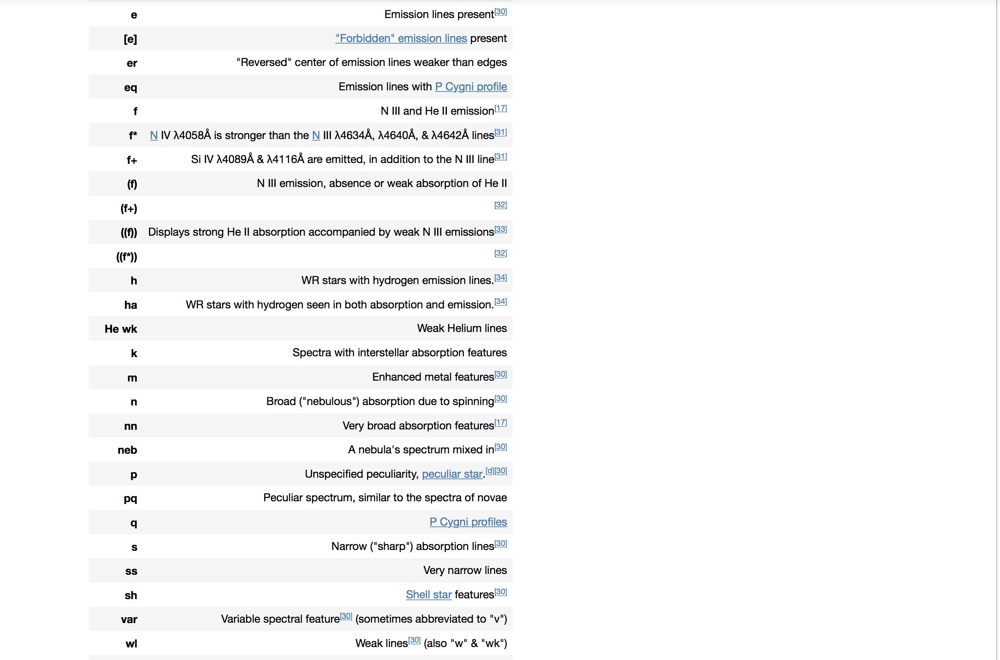

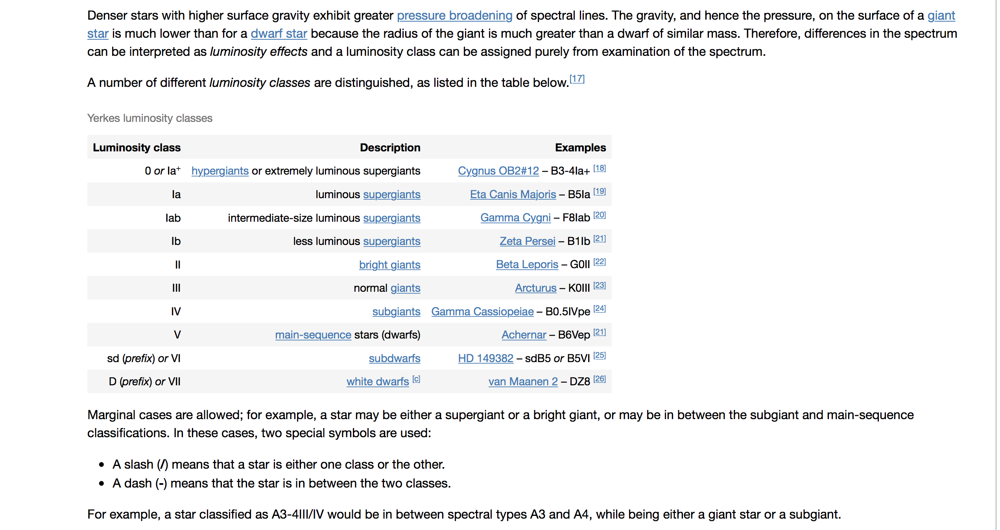

In [ ]:
txt = """ 
0   A0 (19510)
1	A0IVn (25642)          IVn- subgiants n-Broad(nebulous) absorption due to spinning
2	A1Iae (12953)          Iae- luminous supergiants        e-Emission lines present
3	A1III (225180)         III- normal giants
4	A1m (78209)            m-   Enhanced metal features
5	A1V (95418)            V-   main sequence stars (dwarfs)
6	A2Ia (14489)           Ia-  luminous supergiants
7	A2II (39866)           II-  bright giants
8	A3Iae (223385)         Iae- luminous supergiants         e-Emission lines present
9	A4 (G_165-39)
10	A4p (G_37-26)          p-   peculiar
11	A4V (136729)           V-   main sequence stars (dwarfs)
12	A4V (97603)            V-   main sequence stars (dwarfs)
13	A5Ia (17378)           Ia-  luminous supergiants
14	A5II (34578)           II-  bright giants
15	A6IV (28527)           IV-  subgiants
16	A8V (155514)           V-   main sequence stars (dwarfs)
17	A9V (154660)           V-   main sequence stars (dwarfs)
18	Am (78362)             m-   Enhanced metal features
19	B0.5Iae (185859)       Iae- luminous supergiants         e-Emission lines present
20	B0.5Ibe... (187459)    Ibe- less luminous supergiants    e-Emission lines present
21	B0IVe (5394)           IVe- subgiants                    e-Emission lines present
22	B1Ve (212571)          Ve-  main sequence stars (dwarfs) e-Emission lines present
23	B2.5V (175426)         V-   main sequence stars (dwarfs)
24	B2.5Ve (187811)        Ve-  main sequence stars (dwarfs) e-Emission lines present
25	B2Iaevar (41117)       Iaevar- luminous supergiants e-Emission lines present var-Variable spectral feature
26	B2III (35468)          III- normal giants
27	B2IV-V (176819)        IV-V  subgiants / main sequence stars (dwarfs)
28	B2Ve (164284)          Ve-  main sequence stars (dwarfs) e-Emission lines present
29	B2Vne (202904)         Vne- main sequence stars (dwarfs) n-Broad(nebulous) absorption due to spinning e-Emission lines present
30	B2Vne (58343)          Vne- main sequence stars (dwarfs) n-Broad(nebulous) absorption due to spinning e-Emission lines present
31	B3Ib/II (51309)        Ib/II less luminous supergiants / bright giants
32	B3II (175156)          II-  bright giants
33	B3V (29763)            V-   main sequence stars (dwarfs)
34	B3Ve (25940)           Ve-  main sequence stars (dwarfs) e-Emission lines present
35	B5 (338529)
36	B5Ib (191243)          Ib-  less luminous supergiants
37	B5III (209419)         III- normal giants
38	B5V (173087)           V-   main sequence stars (dwarfs)
39	B6IIIpe (109387)       IIIpe- normal giants p-peculiar   e-Emission lines present
40	B6IV (174959)          IV-  subgiants
41	B7IVe (209409)         IVe- subgiants                    e-Emission lines present
42	B8Ib (208501)          Ib-  less luminous supergiants
43	B8III (220575)         III- normal giants
44	B8IV (171301)          IV-  subgiants
45	B9 (105262)
46	B9.5V+... (37269)      V+-  main sequence stars (dwarfs)
47	B9III (15318)          III- normal giants
48	B9Vn (177756)          Vn-  main sequence stars (dwarfs) n-Broad(nebulous) absorption due to spinning
49	CalciumWD
50	Carbon
51	CV
52	F0Ib (36673)           Ib-  less luminous supergiants
53	F0II (25291)           II-  bright giants
54	F0III (89025)          III- normal giants
55	F0IV (81937)           IV-  subgiants
56	F0V (90277)            V-   main sequence stars (dwarfs)
57	F2III (89254)          III- normal giants
58	F2V (33256)            V-   main sequence stars (dwarfs)
59	F3/F5V (30743)         V-   main sequence stars (dwarfs)
60	F5Ib... (17463)        Ib-  less luminous supergiants
61	F6Iab: (187929)        Iab- Intermediate-size luminous supergiants
62	F6II (61295)           II-  bright giants
63	F6III (61064)          III- normal giants
64	F6V (16673)            V-   main sequence stars (dwarfs)
65	F8Ibvar (45412)        Ibvar- less luminous supergiants  var-Variable spectral feature
66	F8V (30562)            V-   main sequence stars (dwarfs)
67	F8V (G_243-63)         V-   main sequence stars (dwarfs)
68	F9IV (136064)          IV-  subgiants
69	G0 (63791)
70	G0 (G_101-29)
71	G0.5IV (14214)         IV-  subgiants
72	G0Ib (204867)          Ib-  less luminous supergiants
73	G0Va (143761)          Va-   main sequence stars (dwarfs)
74	G1V (95128)            V-   main sequence stars (dwarfs)
75	G3Ib (58526)           Ib-  less luminous supergiants
76	G4V (32923)            V-   main sequence stars (dwarfs)
77	G5/G6IVw (26297)       Vw-   main sequence stars (dwarfs) w-Weak lines
78	G5Iab: (20123)         Iab- Intermediate-size luminous supergiants
79	G5III+... (157910)     III+- normal giants
80	G8V (101501)           V-   main sequence stars (dwarfs)
81	G8V (75732)            V-   main sequence stars (dwarfs)
82	G9Ib (221861)          Ib-  less luminous supergiants
83	G9IV (100030)          IV-  subgiants
84	K0IIIa (57669)         IIIa- normal giants
85	K0IV (191026)          IV-  subgiants
86	K0V (10780)            V-   main sequence stars (dwarfs)
87	K1III (18322)          III- normal giants
88	K1IVa (142091)         IVa-  subgiants
89	K1V... (25329)         V-   main sequence stars (dwarfs)
90	K2III (115136)         III- normal giants
91	K3Iab: (4817)          Iab- Intermediate-size luminous supergiants
92	K3Ib... (17506)        Ib-  less luminous supergiants
93	K3III (101673)         III- normal giants
94	K3p (165195)           p-   peculiar
95	K3V (32147)            V-   main sequence stars (dwarfs)
96	K4Iab: (34255)         Iab- Intermediate-size luminous supergiants
97	K4III (136726)         III- normal giants
98	K5 (110281)
99	K5 (G_19-24)
100	K5III (111335)         III- normal giants
101	K5III (120933)         III- normal giants
102	K5Ve (118100)          Ve-  main sequence stars (dwarfs) e-Emission lines present
103	Ldwarf
104	M0III (168720)         III- normal giants
105	M1 (204445)
106	M2Iab: (36389)         Iab- Intermediate-size luminous supergiants
107	M2III (169305)         III- normal giants
108	M3III (44478)          III- normal giants
109	M4.5:III (123657)      III- normal giants
110	M4II (175588)          II-  bright giants
111	M5Iab: (197812)        Iab- Intermediate-size luminous supergiants
112	M5III (221615)         III- normal giants
113	M6III (148783)         III- normal giants
114	M7IIIevar (177940)     IIIevar- normal giants e-Emission lines present var-Variable spectral feature
115	M8IIIe (84748)         IIIe- normal giants e-Emission lines present
116	O8/O9 (167771)
117	O8e (188001)           e-Emission lines present
118	O9.5Iae (30614)        Iae- luminous supergiants e-Emission lines present
119	sd:F0 (G_84-29)
120	sdF3 (140283)
121	WDcooler
122	WDhotter
123	WDmagnetic
"""

In [58]:
t = """pd.set_option('display.max_rows', 200)

Boss_spectra = pd.read_csv("/Volumes/HD_2018_2019/Boss Fits/BossSubclass.csv")
Boss_spectra"""

In [59]:
txt = """ e	Emission lines present
m	Enhanced metal features
n	Broad ("nebulous") absorption due to spinning
p	Unspecified peculiarity
var	Variable spectral feature[30] (sometimes abbreviated to "v")
wl	Weak lines[30] (also "w" & "wk")

0 or Ia+ hypergiants or extremely luminous supergiants	
Ia	luminous supergiants	
Iab	intermediate-size luminous supergiants	
Ib	less luminous supergiants
II	bright giants	
III	normal giants
IV	subgiants
V	main-sequence stars (dwarfs)	
sd (prefix) or VI	subdwarfs
D (prefix) or VII	white dwarfs """

https://arxiv.org/pdf/1604.03704.pdf

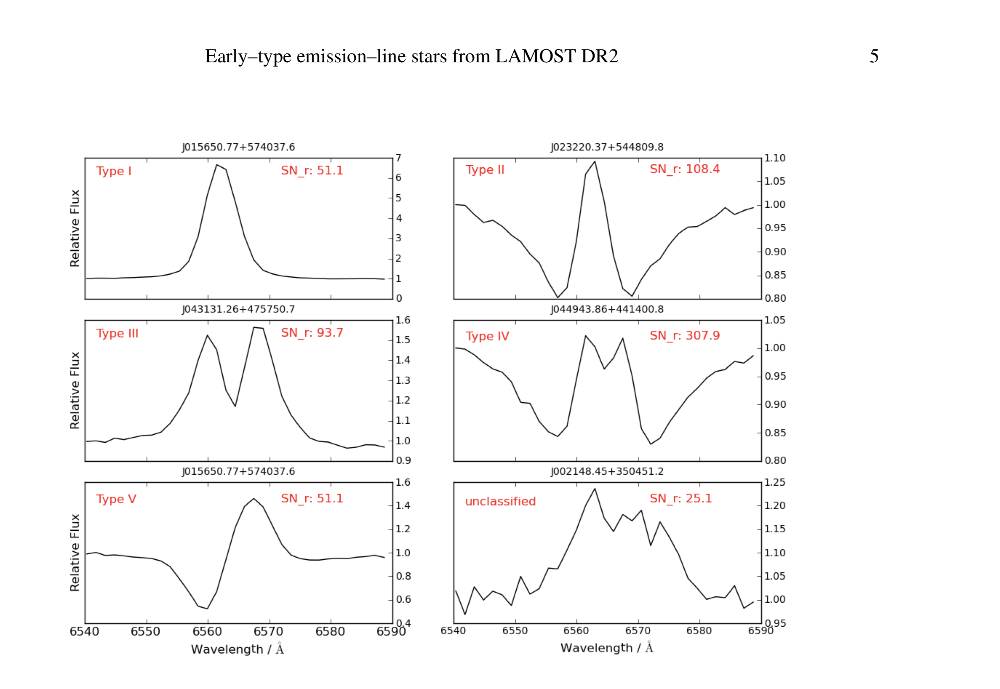

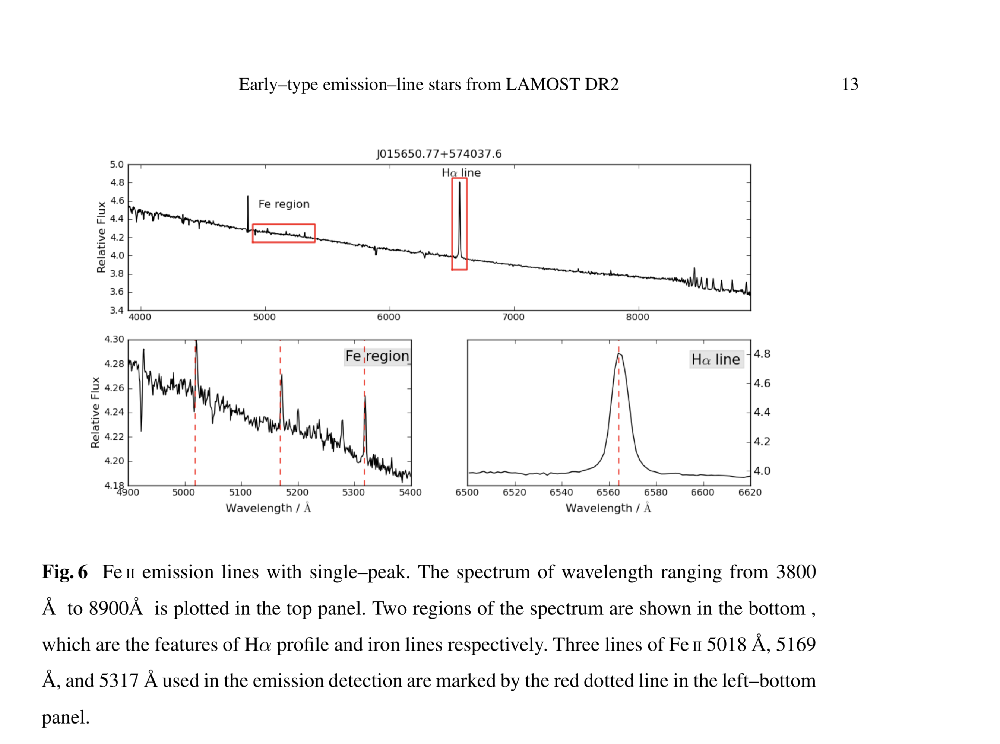

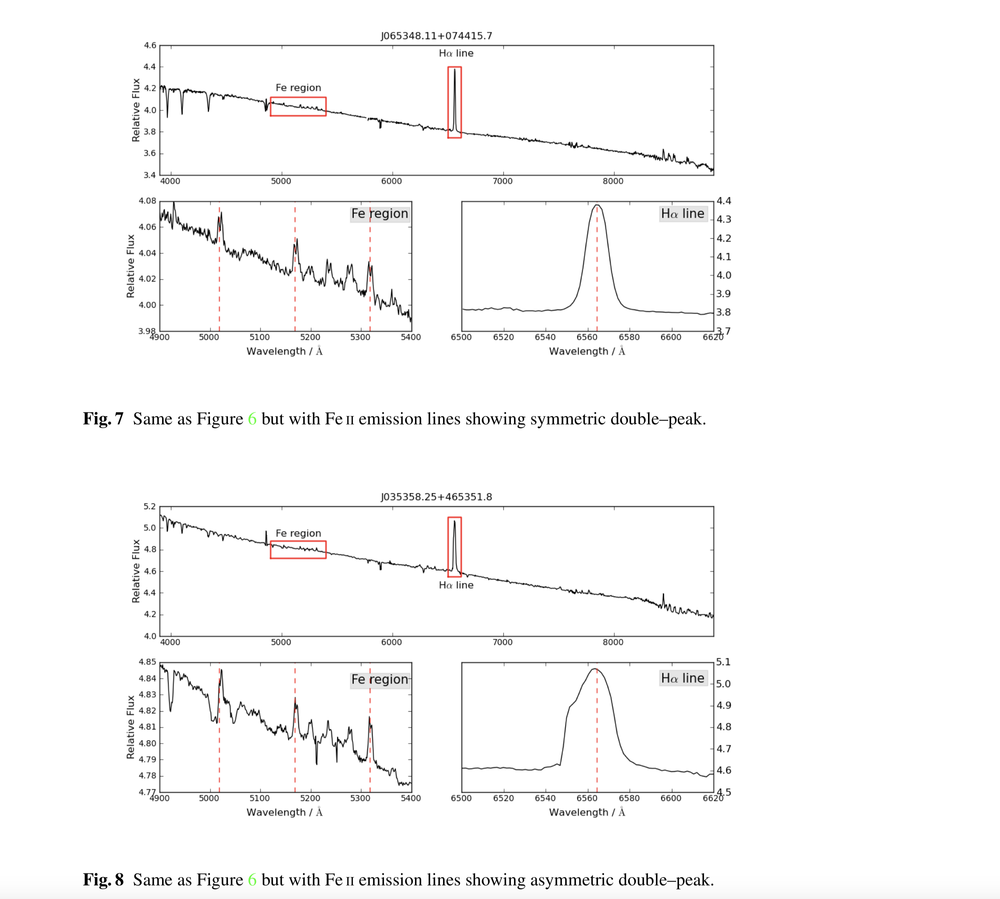

http://www.eso.org/~triviniu/documents/bigwork_print.pdf

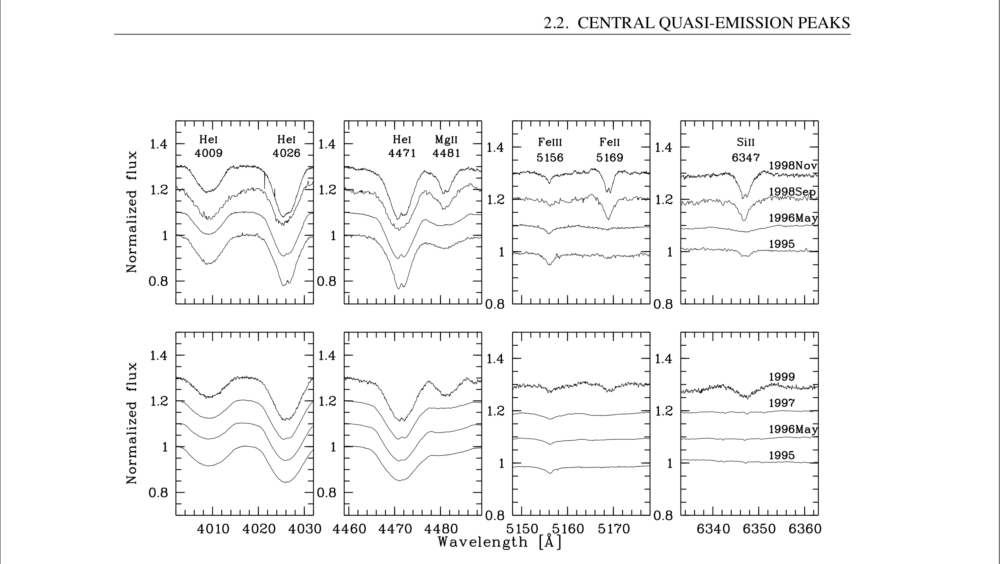

https://arxiv.org/pdf/1604.03704.pdf

Hα emission line in the spectra originates from stellar envelopes or outer stellar atmospheres in early–type stars, due to the presence of strong stellar winds, rotating rings and accre- tion dust disks.
Moreover, depending on the different physical mechanisms or the geometry of the objects, the Hα emission profiles display a wide variety of shapes.

Halpha emmision stars with O,B, or A spectral types dominated by three types:
1. Classical Be (Oe/Ae) stars - CBe stars - emission in the Balmer lines, 
   sometimes emission in singly-ionized metals (like Fe II) or neutral helium. (V-III)
2. Herbig Ae/Be stars - HAeBe stars pre-main sequence stars with mass 2-10 solar masss.
   - emission in the Balmer lines, sometimes emission in singly-ionized metals (like Fe II)
   low-excitation lines such as Ca II and Fe I seen in spectra.
3. Close binaries


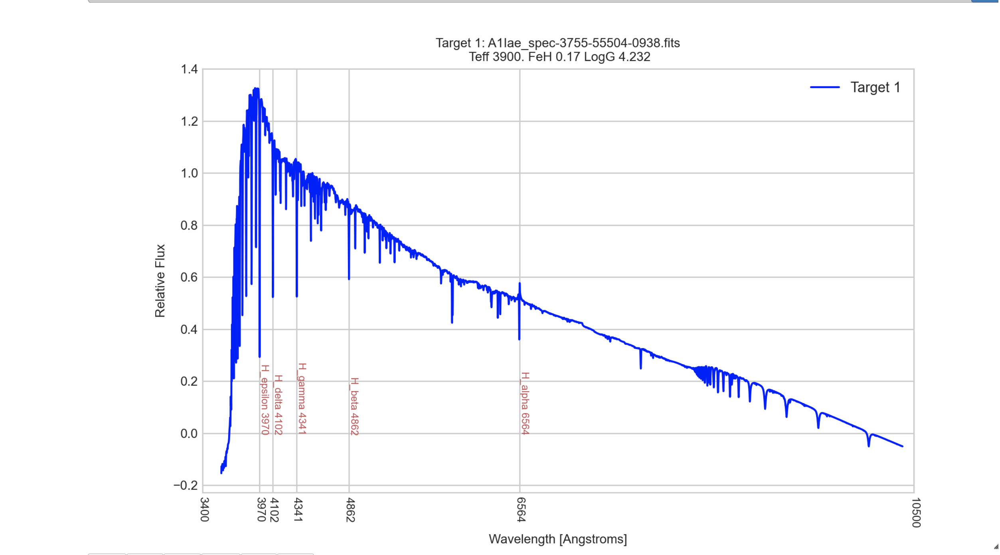

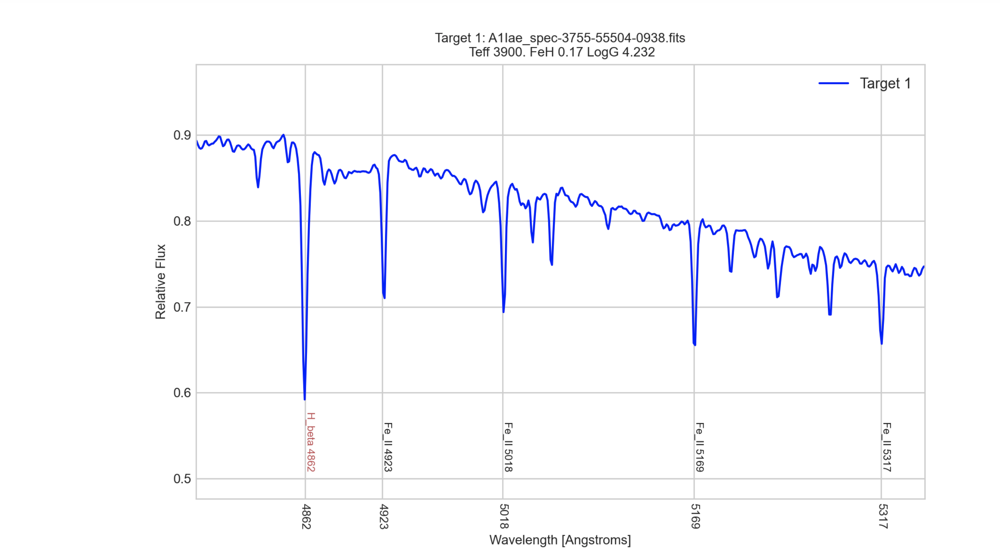

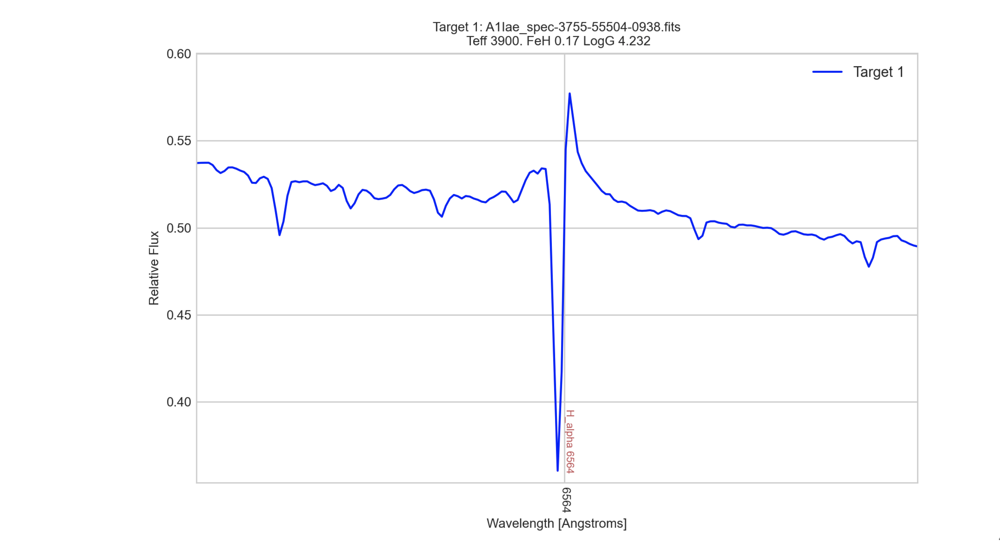

In [ ]:
txt = """ 
SDSS DR16 BOSS Survey A1Iae_32.csv  [Iae- luminous supergiants       
                                          e-Emission lines present]
A1Iae_spec-3586-55181-0127.fits - Type V P-Cygni profile H-alpha emission
A1Iae_spec-3752-55236-0410.fits - Type V P-Cygni profile H-alpha emission
A1Iae_spec-3755-55504-0938.fits - Type V P-Cygni profile H-alpha emission
A1Iae_spec-3759-55236-0980.fits
A1Iae_spec-3773-55240-0272.fits
A1Iae_spec-3782-55244-0918.fits
A1Iae_spec-3827-55565-0718.fits
A1Iae_spec-3928-55331-0184.fits
A1Iae_spec-3981-55603-0854.fits
A1Iae_spec-4011-55635-0414.fits
A1Iae_spec-4994-55739-0602.fits
A1Iae_spec-5014-55717-0772.fits
A1Iae_spec-5057-56209-0231.fits
A1Iae_spec-5065-55739-0566.fits
A1Iae_spec-5145-55835-0230.fits
A1Iae_spec-5146-55831-0130.fits
A1Iae_spec-5301-55987-0732.fits
A1Iae_spec-5375-55973-0272.fits
A1Iae_spec-5447-55958-0706.fits
A1Iae_spec-5450-55986-0518.fits
A1Iae_spec-5493-56009-0624.fits
A1Iae_spec-5876-56042-0941.fits
A1Iae_spec-6155-56245-0036.fits
A1Iae_spec-6467-56270-0412.fits
A1Iae_spec-6701-56367-0952.fits
A1Iae_spec-6800-56399-0520.fits
A1Iae_spec-7117-56685-0893.fits
A1Iae_spec-7167-56604-0070.fits
A1Iae_spec-7242-56628-0602.fits
A1Iae_spec-7337-56662-0546.fits
A1Iae_spec-7373-56990-0037.fits
A1Iae_spec-7416-56810-0865.fits

SDSS DR16 eBOSS Survey A1Iae_20.csv
A1Iae_spec-7631-57279-0381.fits
A1Iae_spec-7670-57328-0404.fits
A1Iae_spec-7678-57282-0841.fits
A1Iae_spec-7709-57666-0913.fits
A1Iae_spec-7829-57011-0378.fits
A1Iae_spec-7891-57332-0089.fits
A1Iae_spec-7893-57286-0428.fits
A1Iae_spec-8386-57518-0973.fits
A1Iae_spec-8529-58013-0738.fits
A1Iae_spec-8532-58022-0096.fits
A1Iae_spec-8759-57700-0576.fits
A1Iae_spec-8833-57779-0522.fits
A1Iae_spec-9154-58013-0039.fits
A1Iae_spec-9332-58072-0962.fits
A1Iae_spec-9589-57813-0155.fits
A1Iae_spec-9630-58086-0343.fits
A1Iae_spec-10253-58487-0394.fits - Type V P-Cygni profile H-alpha emission
A1Iae_spec-10464-58155-0620.fits - Type V P-Cygni profile H-alpha emission
A1Iae_spec-11279-58449-0940.fits - Type V P-Cygni profile H-alpha emission
A1Iae_spec-11654-58543-0855.fits """

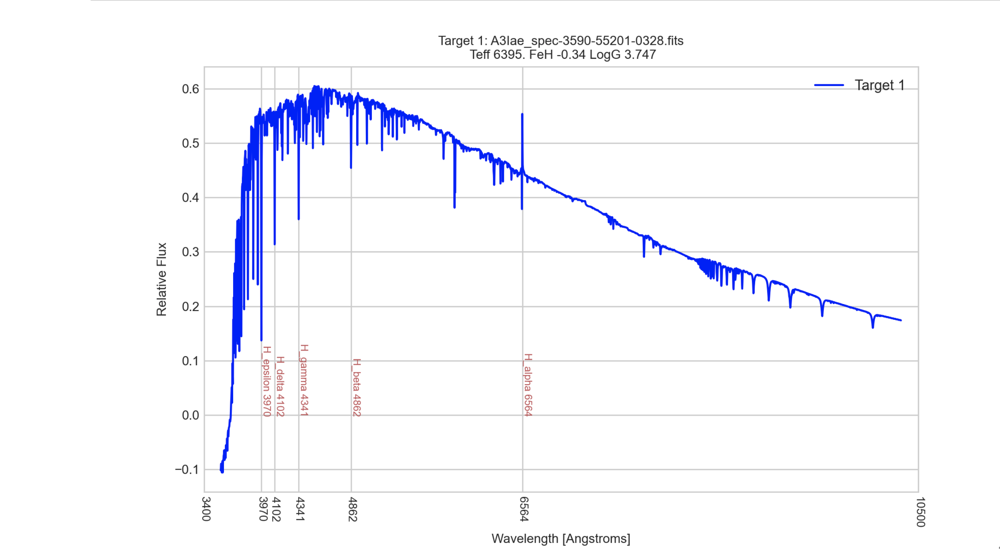

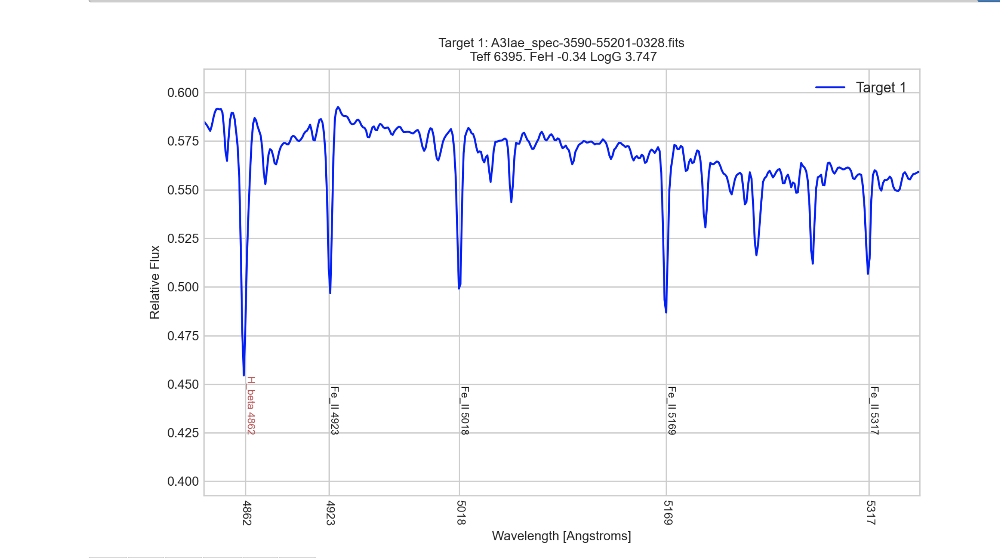

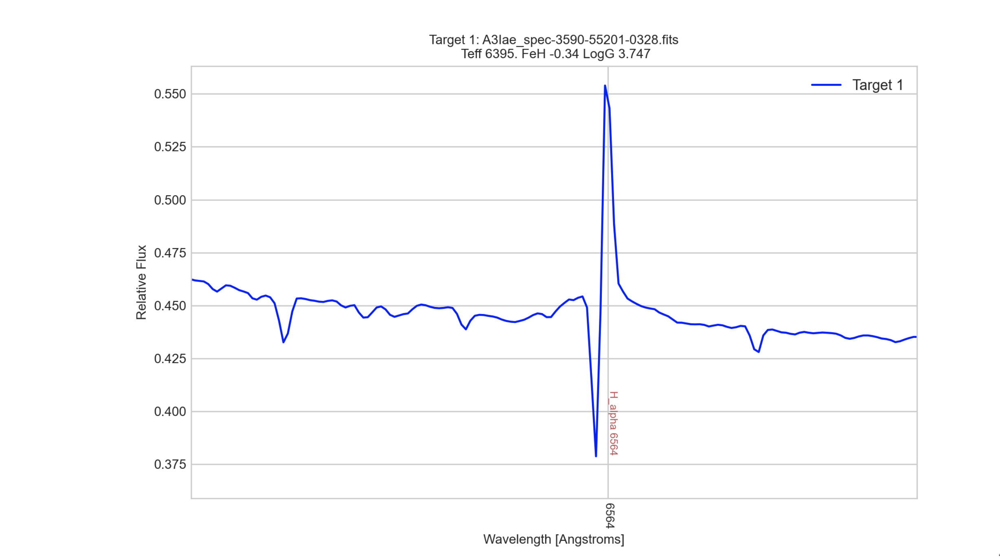

In [ ]:
txt = """ 
A3Iae_63.csv  [Iae- luminous supergiants       
                    e-Emission lines present]
A3Iae_spec-3590-55201-0328.fits - Type V P-Cygni profile H-alpha emission
A3Iae_spec-3609-55201-0830.fits - Type V P-Cygni profile H-alpha emission
A3Iae_spec-3686-55268-0901.fits - Type V P-Cygni profile H-alpha emission
A3Iae_spec-3688-55273-0190.fits - Type V P-Cygni profile H-alpha emission
A3Iae_spec-3761-55272-0168.fits - Type V P-Cygni profile H-alpha emission
A3Iae_spec-3762-55507-0778.fits - Type V P-Cygni profile H-alpha emission
A3Iae_spec-3790-55208-0738.fits - Type V P-Cygni profile H-alpha emission
A3Iae_spec-3806-55505-0290.fits - Type V P-Cygni profile H-alpha emission

eBOSS A3Iae_30.csv
A3Iae_spec-10253-58487-0130.fits - Type V P-Cygni profile H-alpha emission
A3Iae_spec-10434-58140-0334.fits - Type V P-Cygni profile H-alpha emission
A3Iae_spec-10437-58135-0488.fits - Type V P-Cygni profile H-alpha emission """

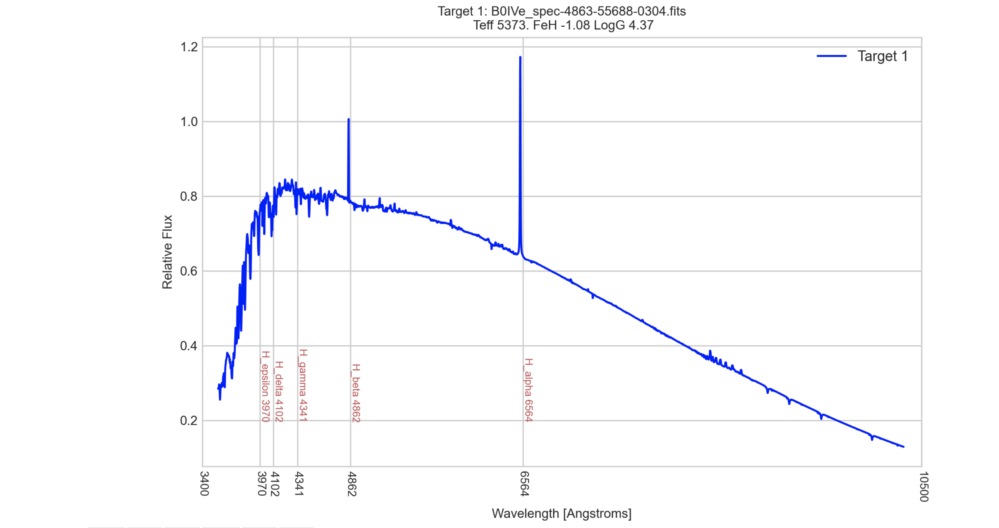

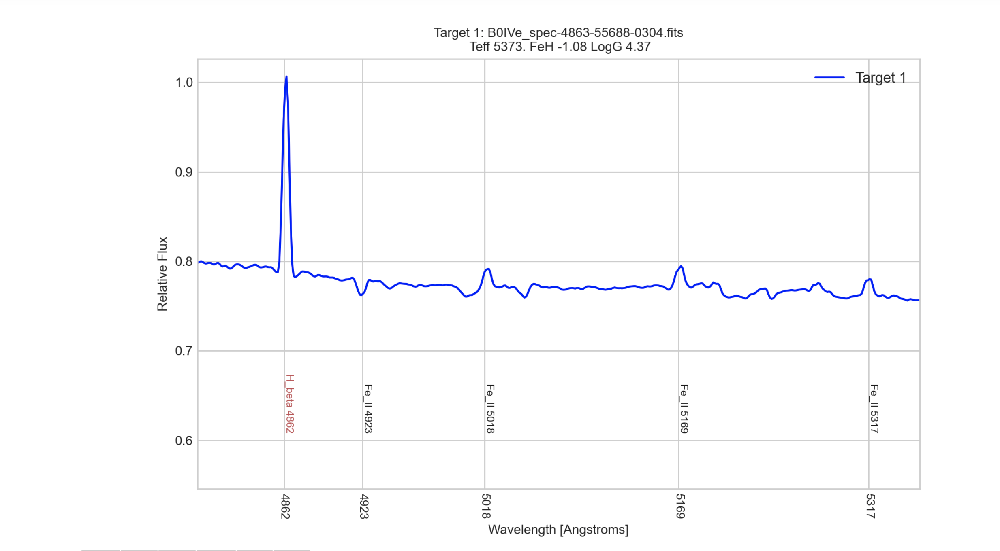

In [ ]:
txt = """ 
https://www.cfa.harvard.edu/~pberlind/atlas/htmls/bstars.html

SDSS DR16 BOSS Survey B0IVe_14.csv  [IVe- subgiants                  
                                          e-Emission lines present]
B0IVe_spec-3672-55484-0783.fits - Type 1 H-alpha emission
                                - Type 1 H-Beta emission
                                - Fe II 5018A ̊,5169 A ̊,5317A ̊ emission                              
B0IVe_spec-3753-55486-0285.fits - Type 1 H-alpha emission
                                - Type 1 H-Beta emission
                                - Fe II 5018A ̊,5169 A ̊,5317A ̊ emission  
B0IVe_spec-3932-55337-0263.fits - Type 1 H-alpha emission
                                - Type 1 H-Beta emission
                                - Fe II 5018A ̊,5169 A ̊,5317A ̊ emission
B0IVe_spec-4032-55333-0652.fits - Type 1 H-alpha emission
                                - Type 1 H-Beta emission
                                - Fe II 5018A ̊,5169 A ̊,5317A ̊ emission
B0IVe_spec-4242-55476-0864.fits - Type 1 H-alpha emission
                                - Type 1 H-Beta emission
                                - Fe II 5018A ̊,5169 A ̊,5317A ̊ emission
B0IVe_spec-4642-55926-0814.fits - Type 1 H-alpha emission
                                - Type 1 H-Beta emission
                                - Fe II 5018A ̊,5169 A ̊,5317A ̊ emission
B0IVe_spec-4863-55688-0304.fits - Type 1 H-alpha emission
                                - Type 1 H-Beta emission
                                - Fe II 5018A ̊,5169 A ̊,5317A ̊ emission ***
B0IVe_spec-5063-55831-0748.fits - Type 1 H-alpha emission
                                - Type 1 H-Beta emission
                                - Fe II 5018A ̊,5169 A ̊,5317A ̊ emission
B0IVe_spec-5140-55836-0484.fits - Type 1 H-alpha emission
                                - Type 1 H-Beta emission
                                - Fe II 5018A ̊,5169 A ̊,5317A ̊ emission
B0IVe_spec-5735-55980-0517.fits - Type 1 H-alpha emission
                                - Type 1 H-Beta emission
                                - Fe II 5018A ̊,5169 A ̊,5317A ̊ emission
B0IVe_spec-5858-56063-0862.fits - Type 1 H-alpha emission
                                - Type 1 H-Beta emission
                                - Fe II 5018A ̊,5169 A ̊,5317A ̊ emission
B0IVe_spec-6160-56190-0460.fits - Type 1 H-alpha emission
                                - Type 1 H-Beta emission
                                - Fe II 5018A ̊,5169 A ̊,5317A ̊ emission
B0IVe_spec-6514-56487-0221.fits - Type 1 H-alpha emission
                                - Type 1 H-Beta emission
                                - Fe II 5018A ̊,5169 A ̊,5317A ̊ emission
B0IVe_spec-6700-56384-0016.fits - Type 1 H-alpha emission
                                - Type 1 H-Beta emission
                                - Fe II 5018A ̊,5169 A ̊,5317A ̊ emission
                                
SDSS DR16 eBOSS Survey  B0IVe_16.csv                           
B0IVe_spec-7689-57743-0276.fits  - Type 1 H-alpha emission
                                 - Type 1 H-Beta emission
                                 - Fe II 5018A ̊,5169 A ̊,5317A ̊ emission ***
B0IVe_spec-7730-58107-0808.fits  - Type 1 H-alpha emission
                                 - Type 1 H-Beta emission
                                 - Fe II 5018A ̊,5169 A ̊,5317A ̊ emission ***
B0IVe_spec-7730-58107-0910.fits  - Type 1 H-alpha emission
                                 - Type 1 H-Beta emission
                                 - Fe II 5018A ̊,5169 A ̊,5317A ̊ emission ***
B0IVe_spec-7730-58107-0913.fits  - Type 1 H-alpha emission
                                 - Type 1 H-Beta emission
                                 - Fe II 5018A ̊,5169 A ̊,5317A ̊ emission ***
B0IVe_spec-7767-58049-0518.fits - Type 1 H-alpha emission
                                 - Type 1 H-Beta emission
                                 - Fe II 5018A ̊,5169 A ̊,5317A ̊ emission ***
B0IVe_spec-8534-57905-0959.fits  - Type 1 H-alpha emission
                                 - Type 1 H-Beta emission
                                 - Fe II 5018A ̊,5169 A ̊,5317A ̊ emission
B0IVe_spec-8876-57783-0907.fits  - Type 1 H-alpha emission
                                 - Type 1 H-Beta emission
                                 - Fe II 5018A ̊,5169 A ̊,5317A ̊ emission
B0IVe_spec-9218-57724-0863.fits  - Type 1 H-alpha emission
                                 - Type 1 H-Beta emission
                                 - Fe II 5018A ̊,5169 A ̊,5317A ̊ emission
B0IVe_spec-9233-58035-0722.fits  - Type 1 H-alpha emission
                                 - Type 1 H-Beta emission
                                 - Fe II 5018A ̊,5169 A ̊,5317A ̊ emission
B0IVe_spec-9328-57727-0982.fits  - Type 1 H-alpha emission
                                 - Type 1 H-Beta emission
                                 - Fe II 5018A ̊,5169 A ̊,5317A ̊ emission
B0IVe_spec-9608-58137-0367.fits  - Type 1 H-alpha emission
                                 - Type 1 H-Beta emission
                                 - Fe II 5018A ̊,5169 A ̊,5317A ̊ emission
B0IVe_spec-9614-57835-0548.fits  - Type 1 H-alpha emission
                                 - Type 1 H-Beta emission
                                 - Fe II 5018A ̊,5169 A ̊,5317A ̊ emission
B0IVe_spec-10246-58171-0022.fits - Type 1 H-alpha emission
                                 - Type 1 H-Beta emission
                                 - Fe II 5018A ̊,5169 A ̊,5317A ̊ emission
B0IVe_spec-10461-58142-0419.fits - Type 1 H-alpha emission
                                 - Type 1 H-Beta emission
                                 - Fe II 5018A ̊,5169 A ̊,5317A ̊ emission 
B0IVe_spec-11108-58467-0951.fits - Type 1 H-alpha emission
                                 - Type 1 H-Beta emission
                                 - Fe II 5018A ̊,5169 A ̊,5317A ̊ emission 
B0IVe_spec-11112-58428-0135.fits - Type 1 H-alpha emission
                                 - Type 1 H-Beta emission
                                 - Fe II 5018A ̊,5169 A ̊,5317A ̊ emission """

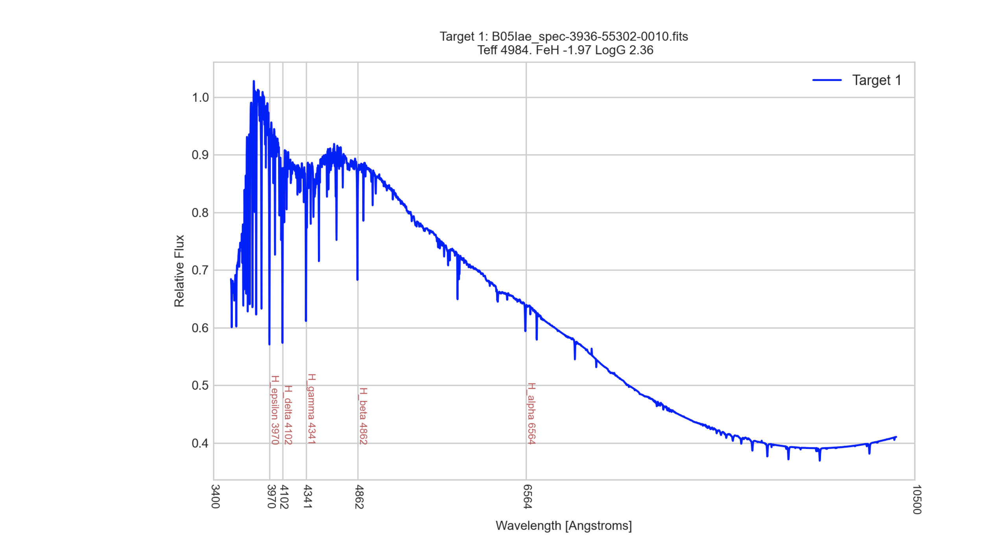

In [ ]:
txt = """
SDSS DR16 BOSS Survey B0.5Iae_21.csv  [Iae- luminous supergiants       
                                            e-Emission lines present]
B05Iae_spec-3735-55209-0277.fits
B05Iae_spec-3764-55514-0004.fits
B05Iae_spec-3782-55244-0297.fits
B05Iae_spec-3936-55302-0010.fits
B05Iae_spec-4013-55629-0864.fits
B05Iae_spec-4872-55944-0272.fits
B05Iae_spec-5112-55895-0548.fits
B05Iae_spec-5136-55836-0918.fits
B05Iae_spec-5183-55976-0750.fits
B05Iae_spec-5330-56000-0878.fits
B05Iae_spec-5408-56038-0068.fits
B05Iae_spec-5770-56014-0279.fits
B05Iae_spec-6252-56248-0944.fits
B05Iae_spec-6312-56487-0158.fits
B05Iae_spec-6442-56369-0453.fits
B05Iae_spec-6507-56478-0246.fits
B05Iae_spec-6684-56412-0492.fits
B05Iae_spec-6692-56390-0820.fits
B05Iae_spec-6983-56447-0722.fits
B05Iae_spec-7114-56748-0184.fits
B05Iae_spec-7376-56749-0405.fits         

SDSS DR16 eBOSS Survey B0.5Iae_11.csv
B05Iae_spec-7749-58073-0933.fits
B05Iae_spec-7843-56902-0378.fits
B05Iae_spec-7843-56902-0540.fits
B05Iae_spec-8736-57400-0190.fits
B05Iae_spec-8738-57402-0305.fits
B05Iae_spec-8750-58401-0265.fits
B05Iae_spec-8838-57870-0681.fits
B05Iae_spec-9142-57664-0052.fits
B05Iae_spec-10661-58171-0489.fits
B05Iae_spec-11076-58428-0256.fits
B05Iae_spec-11561-58485-0099.fits
"""            

In [ ]:
txt = """
SDSS DR16 BOSS Survey B0.5Ibe_65.csv  [Ibe- less luminous supergiants    
                                            e-Emission lines present]
B05Ibe_spec-3586-55181-0804.fits
B05Ibe_spec-3769-55240-0431.fits
B05Ibe_spec-3829-55300-0124.fits
B05Ibe_spec-3829-55300-0506.fits
B05Ibe_spec-3845-55323-0996.fits
B05Ibe_spec-3848-55647-0686.fits
B05Ibe_spec-3926-55327-0864.fits
B05Ibe_spec-3940-55327-0584.fits
B05Ibe_spec-4009-55648-0450.fits
B05Ibe_spec-4014-55630-0142.fits
B05Ibe_spec-4035-55383-0636.fits
B05Ibe_spec-4059-55360-0788.fits
B05Ibe_spec-4068-55445-0319.fits
B05Ibe_spec-4081-55365-0033.fits
B05Ibe_spec-4084-55447-0866.fits
B05Ibe_spec-4085-55452-0328.fits
B05Ibe_spec-4194-55450-0340.fits
B05Ibe_spec-4202-55445-0288.fits
B05Ibe_spec-4280-55503-0937.fits
B05Ibe_spec-4320-55894-0810.fits
B05Ibe_spec-4406-55858-0254.fits
B05Ibe_spec-4407-55884-0904.fits
B05Ibe_spec-4427-56107-0655.fits
B05Ibe_spec-4501-55590-0192.fits
B05Ibe_spec-4612-55590-0762.fits
B05Ibe_spec-4648-55673-0346.fits
B05Ibe_spec-4726-55712-0406.fits
B05Ibe_spec-4759-55649-0112.fits
B05Ibe_spec-4900-55739-0062.fits
B05Ibe_spec-5042-55856-0544.fits
B05Ibe_spec-5107-55940-0656.fits
B05Ibe_spec-5139-55866-0278.fits
B05Ibe_spec-5189-56074-0670.fits
B05Ibe_spec-5206-56033-0106.fits
B05Ibe_spec-5309-55929-0075.fits
B05Ibe_spec-5376-55987-0774.fits
B05Ibe_spec-5400-56308-0152.fits
B05Ibe_spec-5411-55953-0855.fits
B05Ibe_spec-5415-55982-0002.fits
B05Ibe_spec-5448-56013-0012.fits
B05Ibe_spec-5491-56034-0298.fits
B05Ibe_spec-5851-56075-0148.fits
B05Ibe_spec-5859-56065-0820.fits
B05Ibe_spec-5863-56042-0226.fits
B05Ibe_spec-5894-56039-0376.fits
B05Ibe_spec-5900-56043-0720.fits
B05Ibe_spec-6019-56074-0184.fits
B05Ibe_spec-6064-56097-0667.fits
B05Ibe_spec-6178-56213-0434.fits
B05Ibe_spec-6294-56482-0642.fits
B05Ibe_spec-6321-56449-0787.fits
B05Ibe_spec-6453-56365-0480.fits
B05Ibe_spec-6488-56364-0940.fits
B05Ibe_spec-6501-56563-0764.fits
B05Ibe_spec-6512-56567-0466.fits
B05Ibe_spec-6631-56364-0686.fits
B05Ibe_spec-6661-56366-0288.fits
B05Ibe_spec-6669-56413-0368.fits
B05Ibe_spec-7041-56569-0831.fits
B05Ibe_spec-7154-56955-0432.fits
B05Ibe_spec-7158-56956-0360.fits
B05Ibe_spec-7160-56599-0832.fits
B05Ibe_spec-7161-56625-0014.fits
B05Ibe_spec-7317-56992-0988.fits
B05Ibe_spec-7422-56799-0210.fits        

SDSS DR16 eBOSS Survey B0.5Ibe_6.csv
B05Ibe_spec-7877-56898-0273.fits
B05Ibe_spec-8068-57185-0707.fits
B05Ibe_spec-8194-57401-0237.fits
B05Ibe_spec-8519-58198-0327.fits
B05Ibe_spec-9359-58056-0492.fits
B05Ibe_spec-11294-58451-0230.fits
"""            

In [ ]:
txt = """
eB1Ve_44.csv
B1Ve_109.csv  [Ve-  main sequence stars (dwarfs) 
                    e-Emission lines present]
None ???"""

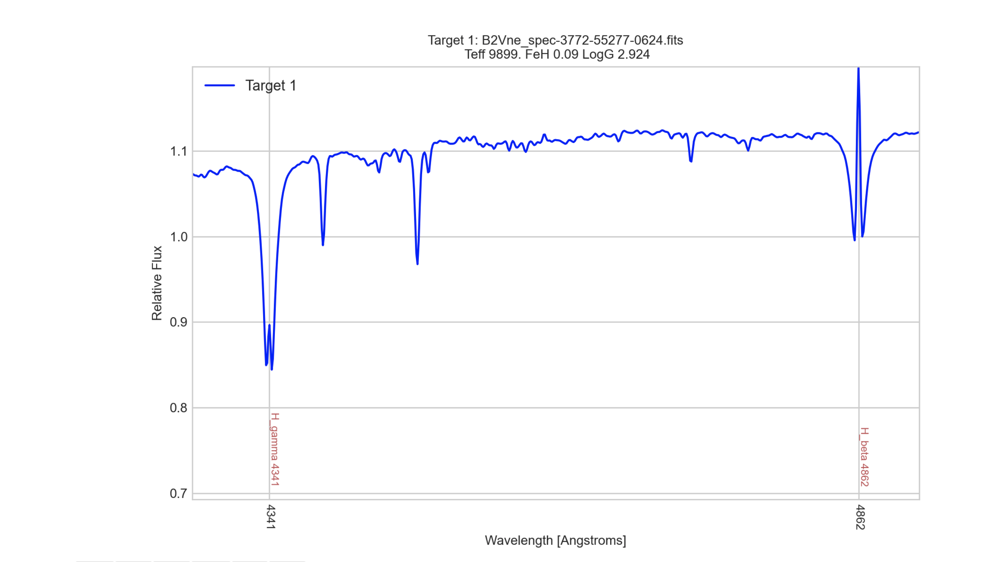

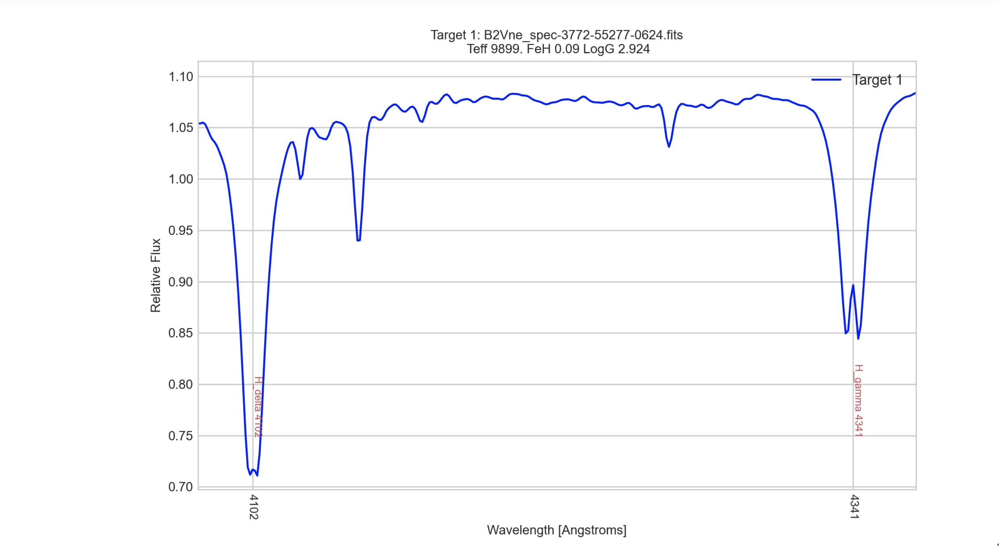

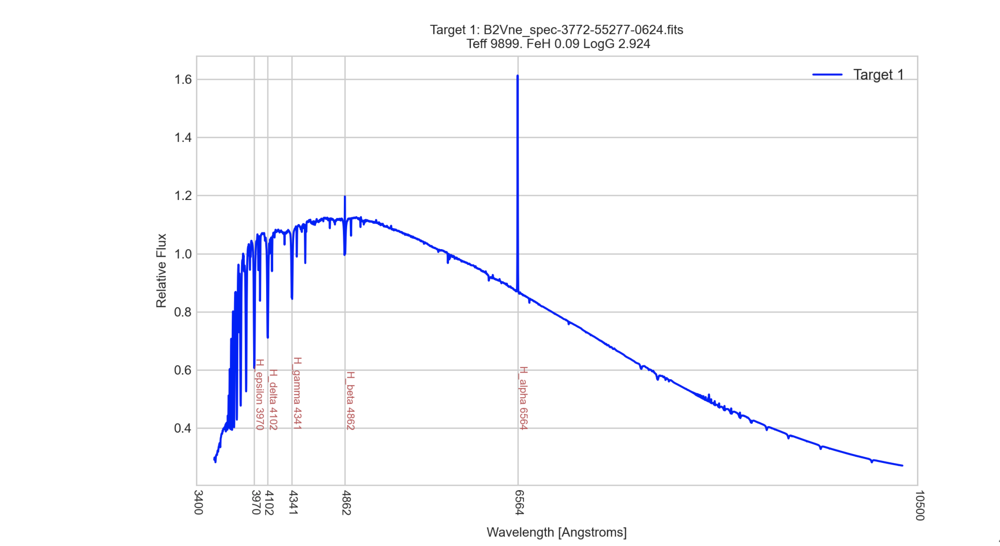

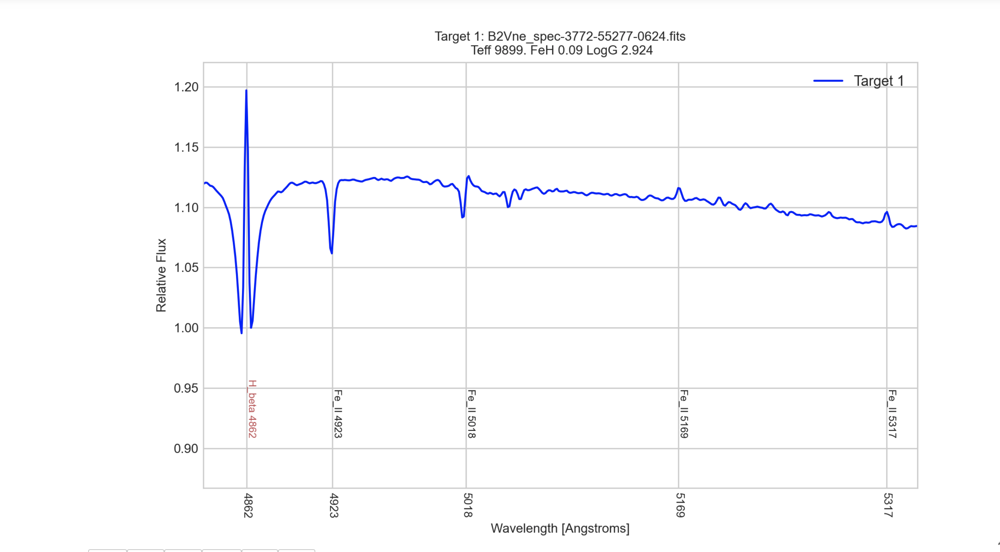

In [ ]:
txt = """ 
SDSS DR16 BOSS Survey B2Vne_6.csv  
                      B2VneTwo_53.csv  [Vne- main sequence stars (dwarfs)                                   
                                             n-Broad(nebulous) absorption due to spinning 
                                             e-Emission lines present]
B2Vne_spec-3587-55182-0926.fits - Type 1 H-alpha emission
                                - Type 2 H-Beta emission
                                - Fe II 5018A ̊,5169 A ̊,5317A ̊ emission
B2Vne_spec-3755-55504-0639.fits - Type 1 H-alpha emission
                                - Type 2 H-Beta emission
                                - Fe II 5018A ̊,5169 A ̊,5317A ̊ emission
B2Vne_spec-3772-55277-0624.fits - Type 1 H-alpha emission
                                - Type 2 H-Beta emission
                                - Fe II 5018A ̊,5169 A ̊,5317A ̊ emission
B2Vne_spec-3801-55509-0422.fits - Type 1 H-alpha emission
                                - Type 2 H-Beta emission
                                - Fe II 5018A ̊,5169 A ̊,5317A ̊ emission
B2Vne_spec-3853-55268-0882.fits - Type 1 H-alpha emission
                                - Type 2 H-Beta emission
                                - Fe II 5018A ̊,5169 A ̊,5317A ̊ emission
B2Vne_spec-3935-55326-0058.fits
B2Vne_spec-3965-55302-0240.fits
B2Vne_spec-4021-55620-0728.fits
B2Vne_spec-4022-55352-0054.fits
B2Vne_spec-4311-55506-0232.fits
B2Vne_spec-4554-56193-0338.fits
B2Vne_spec-4635-55615-0370.fits
B2Vne_spec-4649-55621-0042.fits
B2Vne_spec-4691-55651-0486.fits
B2Vne_spec-4733-55649-0162.fits
B2Vne_spec-4772-55654-0316.fits
B2Vne_spec-4998-55722-0972.fits
B2Vne_spec-5007-55710-0230.fits
B2Vne_spec-5123-55841-0926.fits
B2Vne_spec-5154-55864-0388.fits
B2Vne_spec-5402-55927-0872.fits
B2Vne_spec-5489-55990-0720.fits
B2Vne_spec-5800-56279-0252.fits
B2Vne_spec-5860-56046-0916.fits
B2Vne_spec-5875-56038-0184.fits
B2Vne_spec-5967-56063-0834.fits
B2Vne_spec-5986-56328-0786.fits
B2Vne_spec-5987-56339-0666.fits
B2Vne_spec-6185-56217-0478.fits
B2Vne_spec-6265-56248-0834.fits
B2Vne_spec-6297-56218-0978.fits
B2Vne_spec-6447-56362-0905.fits
B2Vne_spec-6479-56364-0826.fits
B2Vne_spec-6480-56340-0208.fits
B2Vne_spec-6480-56340-0610.fits
B2Vne_spec-6482-56358-0146.fits
B2Vne_spec-6599-56567-0225.fits
B2Vne_spec-6599-56567-0230.fits
B2Vne_spec-6599-56567-0277.fits
B2Vne_spec-6599-56567-0309.fits
B2Vne_spec-6641-56383-0846.fits
B2Vne_spec-6659-56607-0202.fits
B2Vne_spec-6677-56385-0496.fits
B2Vne_spec-6689-56396-0894.fits
B2Vne_spec-6744-56399-0495.fits
B2Vne_spec-6757-56416-0624.fits - Type 1 H-alpha emission
                                - Type 2 H-Beta emission
                                - Fe II 5018A ̊,5169 A ̊,5317A ̊ emission
B2Vne_spec-6796-56453-0932.fits
B2Vne_spec-6801-56487-0126.fits
B2Vne_spec-7091-56658-0366.fits
B2Vne_spec-7091-56658-0430.fits
B2Vne_spec-7091-56658-0870.fits
B2Vne_spec-7156-56959-0164.fits
B2Vne_spec-7262-56683-0155.fits
B2Vne_spec-7290-57073-0269.fits
B2Vne_spec-7291-56992-0532.fits
B2Vne_spec-7291-56992-0650.fits
B2Vne_spec-7377-56741-0414.fits
B2Vne_spec-7424-57160-0180.fits
B2Vne_spec-7513-56780-0270.fits - Type 1 H-alpha emission
                                - Type 2 H-Beta emission
                                - Fe II 5018A ̊,5169 A ̊,5317A ̊ emission                                
           
SDSS DR16 eBOSS Survey B2Vne_4.csv
                       B2VneTwo_78.csv 
B2Vne_spec-7637-56933-0552.fits
B2Vne_spec-7667-57580-0666.fits
B2Vne_spec-7730-58107-0238.fits
B2Vne_spec-7730-58107-0788.fits
B2Vne_spec-7730-58107-0809.fits
B2Vne_spec-7730-58107-0810.fits
B2Vne_spec-7730-58107-0826.fits
B2Vne_spec-7730-58107-0860.fits
B2Vne_spec-7730-58107-0928.fits
B2Vne_spec-7730-58107-0960.fits
B2Vne_spec-7730-58107-0968.fits
B2Vne_spec-7731-58130-0230.fits
B2Vne_spec-7731-58130-0239.fits
B2Vne_spec-7731-58130-0248.fits
B2Vne_spec-7731-58130-0322.fits
B2Vne_spec-7731-58130-0325.fits
B2Vne_spec-7731-58130-0368.fits
B2Vne_spec-7731-58130-0374.fits
B2Vne_spec-7731-58130-0376.fits
B2Vne_spec-7731-58130-0378.fits
B2Vne_spec-7731-58130-0388.fits
B2Vne_spec-7731-58130-0406.fits
B2Vne_spec-7731-58130-0414.fits
B2Vne_spec-7731-58130-0416.fits
B2Vne_spec-7731-58130-0432.fits
B2Vne_spec-7731-58130-0448.fits
B2Vne_spec-7731-58130-0452.fits
B2Vne_spec-7731-58130-0468.fits
B2Vne_spec-7731-58130-0470.fits
B2Vne_spec-7731-58130-0472.fits
B2Vne_spec-7731-58130-0660.fits
B2Vne_spec-7731-58130-0698.fits
B2Vne_spec-7731-58130-0700.fits
B2Vne_spec-7731-58130-0739.fits
B2Vne_spec-7731-58130-0740.fits
B2Vne_spec-7745-58077-0038.fits
B2Vne_spec-7747-58398-0669.fits
B2Vne_spec-7759-58401-0150.fits
B2Vne_spec-7761-58071-0054.fits
B2Vne_spec-7768-58289-0580.fits
B2Vne_spec-7876-57002-0550.fits
B2Vne_spec-8175-57039-0736.fits
B2Vne_spec-8185-57431-0907.fits
B2Vne_spec-8193-57333-0017.fits
B2Vne_spec-8205-58143-0780.fits
B2Vne_spec-8222-57431-0462.fits
B2Vne_spec-8224-57378-0926.fits
B2Vne_spec-8226-57423-0679.fits
B2Vne_spec-8228-57423-0188.fits
B2Vne_spec-8355-56988-0626.fits
B2Vne_spec-8373-57785-0030.fits
B2Vne_spec-8374-57783-0462.fits
B2Vne_spec-8384-57513-0766.fits
B2Vne_spec-8388-57488-0722.fits
B2Vne_spec-8398-57870-0540.fits
B2Vne_spec-8398-57870-0966.fits
B2Vne_spec-8427-57846-0878.fits
B2Vne_spec-8491-57488-0621.fits
B2Vne_spec-8501-57519-0302.fits
B2Vne_spec-8529-58013-0806.fits
B2Vne_spec-8836-57424-0250.fits
B2Vne_spec-8842-57424-0868.fits
B2Vne_spec-8852-57449-0098.fits
B2Vne_spec-8865-57426-0205.fits
B2Vne_spec-8865-57426-0335.fits
B2Vne_spec-8866-57457-0930.fits
B2Vne_spec-8870-57779-0761.fits
B2Vne_spec-8878-57785-0268.fits
B2Vne_spec-9328-57727-0091.fits
B2Vne_spec-9360-58055-0940.fits
B2Vne_spec-9554-57807-0165.fits
B2Vne_spec-9614-57835-0981.fits
B2Vne_spec-10247-58162-0444.fits
B2Vne_spec-10249-58229-0204.fits
B2Vne_spec-10251-58173-0354.fits
B2Vne_spec-10261-58462-0255.fits
B2Vne_spec-11074-58488-0736.fits
B2Vne_spec-11314-58436-0115.fits
B2Vne_spec-11349-58441-0738.fits
B2Vne_spec-11384-58522-0594.fits
B2Vne_spec-11395-58488-0540.fits
B2Vne_spec-11396-58490-0127.fits """

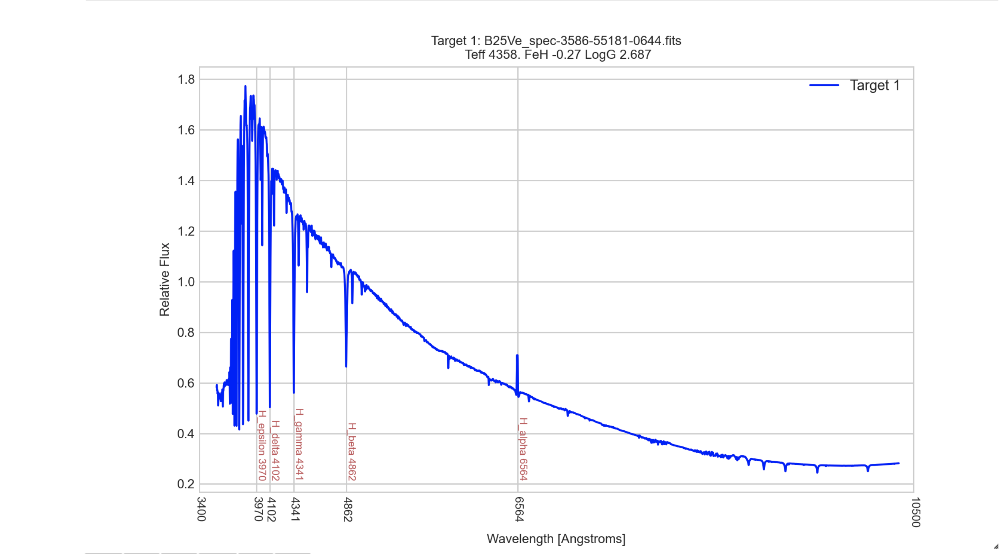

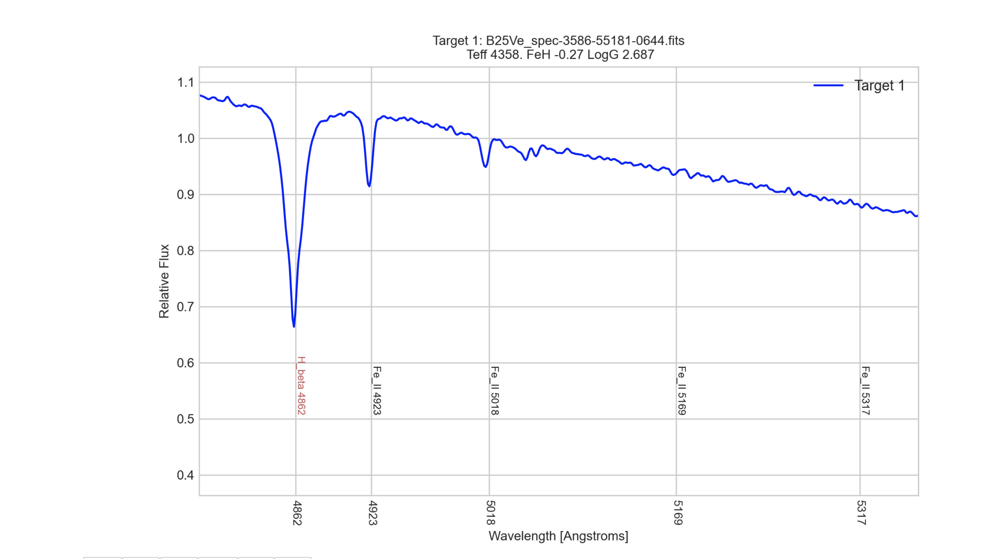

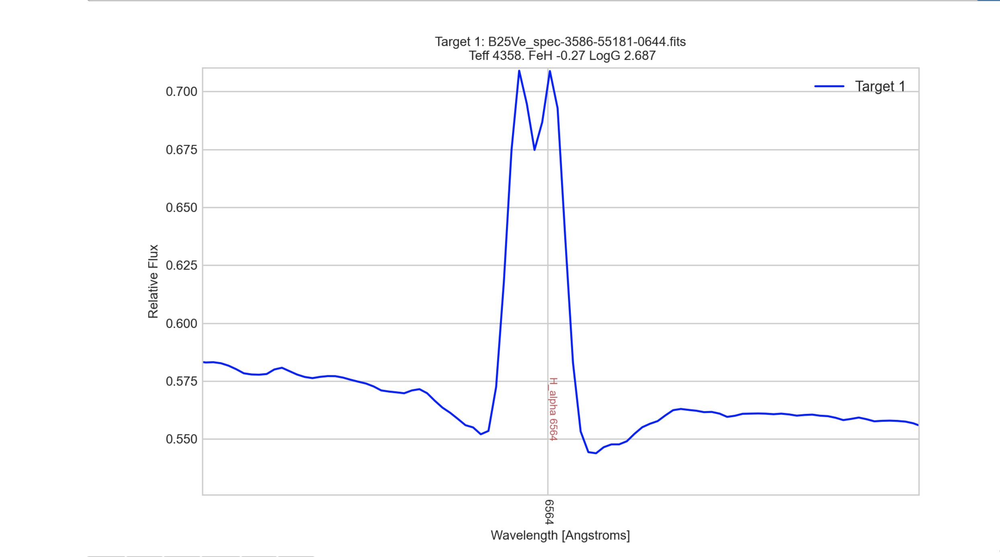

In [ ]:
txt = """ 
SDSS DR16 BOSS Survey B25Ve_31.csv  [Ve-  main sequence stars (dwarfs) 
                                           e-Emission lines present]                               
B25Ve_spec-3586-55181-0644.fits - Type 3 H-alpha emission width 20A
B25Ve_spec-3782-55244-0686.fits - Type 3 H-alpha emission width 20A
B25Ve_spec-3969-55307-0746.fits - Type 3 H-alpha emission width 20A
B25Ve_spec-4091-55498-0909.fits - Type 3 H-alpha emission
B25Ve_spec-4344-55557-0340.fits - Type 3 H-alpha emission
B25Ve_spec-4392-55833-0760.fits - Type 3 H-alpha emission
B25Ve_spec-4440-55539-0586.fits - Type 3 H-alpha emission
B25Ve_spec-4637-55616-0358.fits - Type 3 H-alpha emission
B25Ve_spec-4637-55616-0774.fits - Type 3 H-alpha emission
B25Ve_spec-4664-56192-0268.fits - Type 3 H-alpha emission
B25Ve_spec-4725-55711-0559.fits - Type 3 H-alpha emission
B25Ve_spec-5130-55835-0658.fits - Type 3 H-alpha emission
B25Ve_spec-5193-56066-0292.fits - Type 3 H-alpha emission
B25Ve_spec-5328-55982-0022.fits - Type 3 H-alpha emission
B25Ve_spec-5328-55982-0047.fits - Type 3 H-alpha emission
B25Ve_spec-5333-56001-0405.fits - Type 3 H-alpha emission
B25Ve_spec-5333-56001-0499.fits - Type 3 H-alpha emission
B25Ve_spec-6110-56279-0160.fits - Type 3 H-alpha emission
B25Ve_spec-6140-56189-0929.fits - Type 3 H-alpha emission
B25Ve_spec-6267-56279-0541.fits - Type 3 H-alpha emission
B25Ve_spec-6408-56329-0961.fits - Type 3 H-alpha emission
B25Ve_spec-6599-56567-0289.fits - Type 3 H-alpha emission
B25Ve_spec-6723-56428-0542.fits - Type 3 H-alpha emission
B25Ve_spec-6803-56402-0280.fits - Type 3 H-alpha emission
B25Ve_spec-6831-56426-0363.fits - Type 3 H-alpha emission
B25Ve_spec-7135-56564-0765.fits - Type 3 H-alpha emission
B25Ve_spec-7169-56628-0843.fits - Type 3 H-alpha emission
B25Ve_spec-7243-56629-0300.fits - Type 3 H-alpha emission
B25Ve_spec-7414-56748-0964.fits - Type 3 H-alpha emission
B25Ve_spec-7414-56748-0980.fits - Type 3 H-alpha emission
B25Ve_spec-7432-57107-0553.fits - Type 3 H-alpha emission

SDSS DR16 eBOSS Survey B25Ve_24.csv
B25Ve_spec-7580-56955-0099.fits - Type 3 H-alpha emission
B25Ve_spec-7623-56901-0640.fits - Type 3 H-alpha emission
B25Ve_spec-7730-58107-0732.fits - Type 3 H-alpha emission
B25Ve_spec-7730-58107-0753.fits - Type 3 H-alpha emission
B25Ve_spec-7730-58107-0760.fits - Type 3 H-alpha emission
B25Ve_spec-7730-58107-0764.fits - Type 3 H-alpha emission
B25Ve_spec-7730-58107-0780.fits - Type 3 H-alpha emission
B25Ve_spec-7730-58107-0783.fits - Type 3 H-alpha emission
B25Ve_spec-7730-58107-0802.fits - Type 3 H-alpha emission
B25Ve_spec-7730-58107-0828.fits - Type 3 H-alpha emission
B25Ve_spec-7730-58107-0920.fits - Type 3 H-alpha emission
B25Ve_spec-7731-58130-0237.fits - Type 3 H-alpha emission
B25Ve_spec-7731-58130-0241.fits - Type 3 H-alpha emission
B25Ve_spec-7731-58130-0332.fits - Type 3 H-alpha emission
B25Ve_spec-7731-58130-0364.fits - Type 3 H-alpha emission
B25Ve_spec-7731-58130-0396.fits - Type 3 H-alpha emission
B25Ve_spec-7731-58130-0658.fits - Type 3 H-alpha emission
B25Ve_spec-7739-57673-0488.fits - Type 3 H-alpha emission
B25Ve_spec-8220-57432-0450.fits - Type 3 H-alpha emission
B25Ve_spec-8501-57519-0912.fits - Type 3 H-alpha emission
B25Ve_spec-8837-57867-0273.fits - Type 3 H-alpha emission
B25Ve_spec-10753-58242-0868.fits - Type 3 H-alpha emission
B25Ve_spec-11044-58508-0470.fits - Type 3 H-alpha emission
B25Ve_spec-11318-58419-0786.fits - Type 3 H-alpha emission """

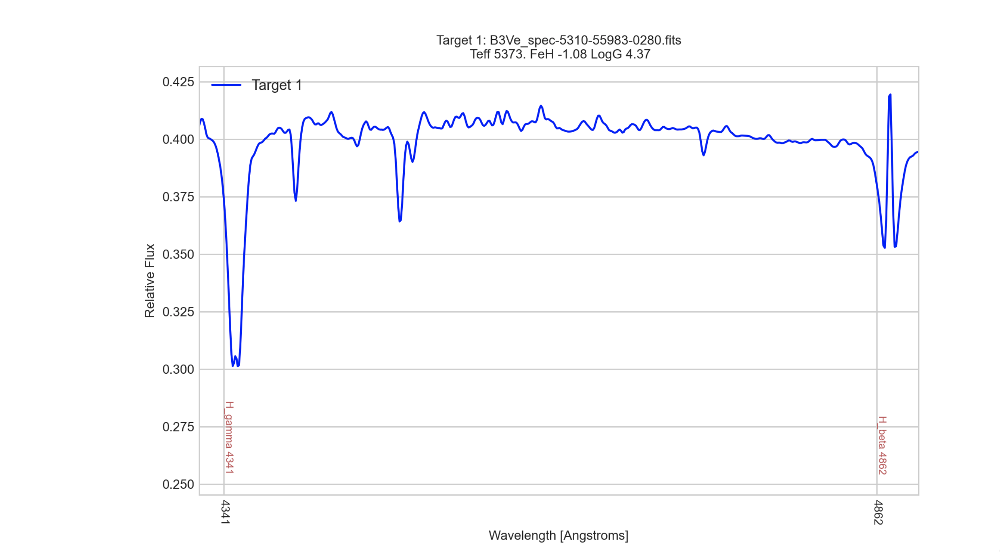

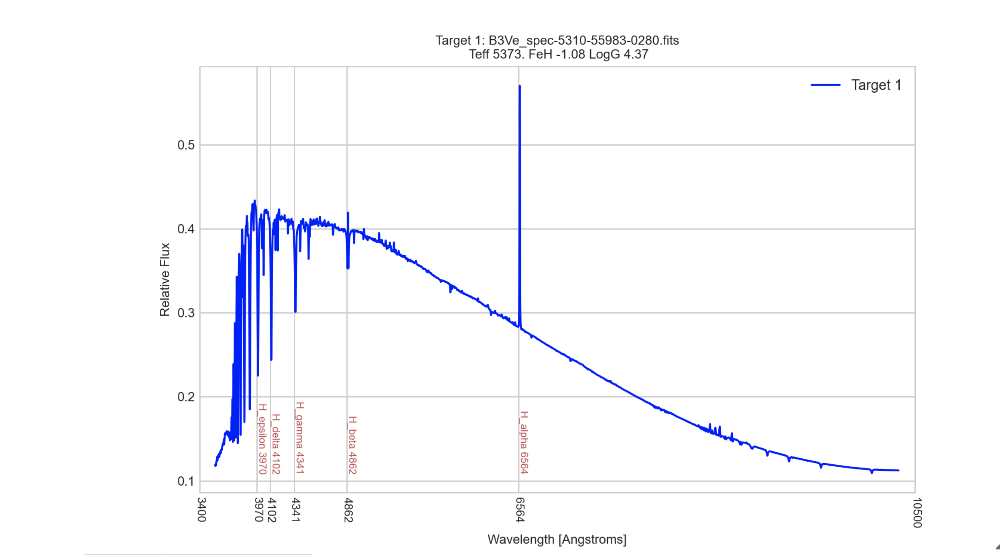

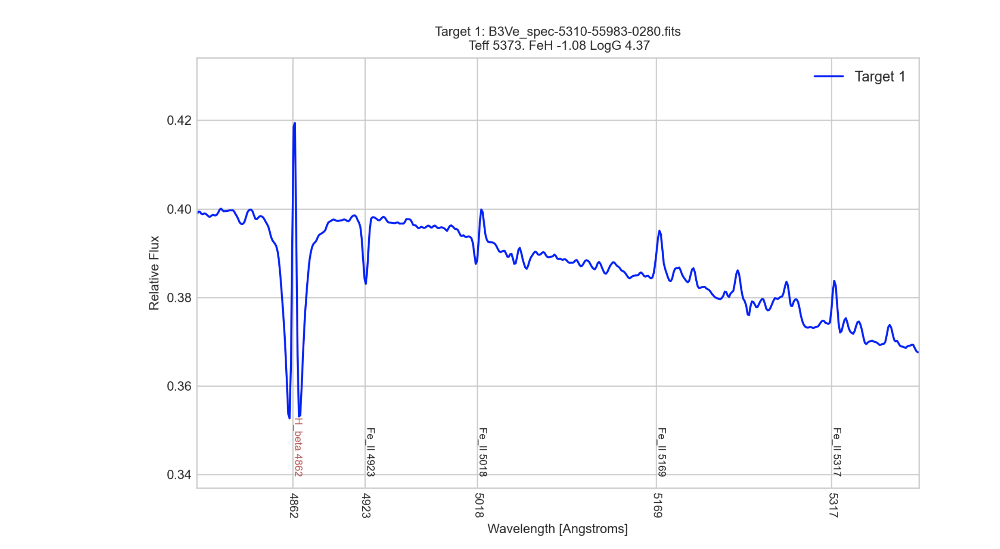

In [ ]:
txt = """ 
SDSS DR16 BOSS Survey B3Ve_6.csv  [Ve-  main sequence stars (dwarfs) 
                                        e-Emission lines present] 
B3Ve_spec-4200-55499-0108.fits  - Type 1 H-alpha emission
                                - Type 2 H-Beta emission
                                - Fe II 5018A ̊,5169 A ̊,5317A ̊ emission
B3Ve_spec-4877-55707-0136.fits  - Bad
B3Ve_spec-5310-55983-0280.fits  - Type 1 H-alpha emission
                                - Type 2 H-Beta emission
                                - Fe II 5018A ̊,5169 A ̊,5317A ̊ emission
B3Ve_spec-5465-55988-0908.fits  - Type 1 H-alpha emission
                                - Type 2 H-Beta emission
                                - Fe II 5018A ̊,5169 A ̊,5317A ̊ emission
B3Ve_spec-6599-56567-0258.fits  - Type 1 H-alpha emission
                                - Type 2 H-Beta emission
                                - Fe II 5018A ̊,5169 A ̊,5317A ̊ emission
B3Ve_spec-6646-56389-0834.fits  - Type 1 H-alpha emission
                                - Type 2 H-Beta emission
                                - Fe II 5018A ̊,5169 A ̊,5317A ̊ emission

SDSS DR16 eBOSS Survey B3Ve_9.csv
B3Ve_spec-7730-58107-0904.fits  - Type 1 H-alpha emission
                                - Type 2 H-Beta emission
                                - Fe II 5018A ̊,5169 A ̊,5317A ̊ emission
B3Ve_spec-7731-58130-0375.fits  - Type 1 H-alpha emission
                                - Type 2 H-Beta emission
                                - Fe II 5018A ̊,5169 A ̊,5317A ̊ emission
B3Ve_spec-8125-56955-0998.fits  - Type 1 H-alpha emission
                                - Type 2 H-Beta emission
                                - Fe II 5018A ̊,5169 A ̊,5317A ̊ emission
B3Ve_spec-8408-57874-0511.fits  - Type 1 H-alpha emission
                                - Type 2 H-Beta emission
                                - Fe II 5018A ̊,5169 A ̊,5317A ̊ emission
B3Ve_spec-8542-57933-0486.fits  - Type 1 H-alpha emission
                                - Type 2 H-Beta emission
                                - Fe II 5018A ̊,5169 A ̊,5317A ̊ emission
B3Ve_spec-9381-57758-0865.fits  - Type 1 H-alpha emission
                                - Type 2 H-Beta emission
                                - Fe II 5018A ̊,5169 A ̊,5317A ̊ emission
B3Ve_spec-9393-58100-0899.fits  - Type 1 H-alpha emission
                                - Type 2 H-Beta emission
                                - Fe II 5018A ̊,5169 A ̊,5317A ̊ emission
B3Ve_spec-9577-57786-0874.fits  - Type 1 H-alpha emission
                                - Type 2 H-Beta emission
                                - Fe II 5018A ̊,5169 A ̊,5317A ̊ emission
B3Ve_spec-10453-58136-0085.fits - Type 1 H-alpha emission
                                - Type 2 H-Beta emission
                                - Fe II 5018A ̊,5169 A ̊,5317A ̊ emission """

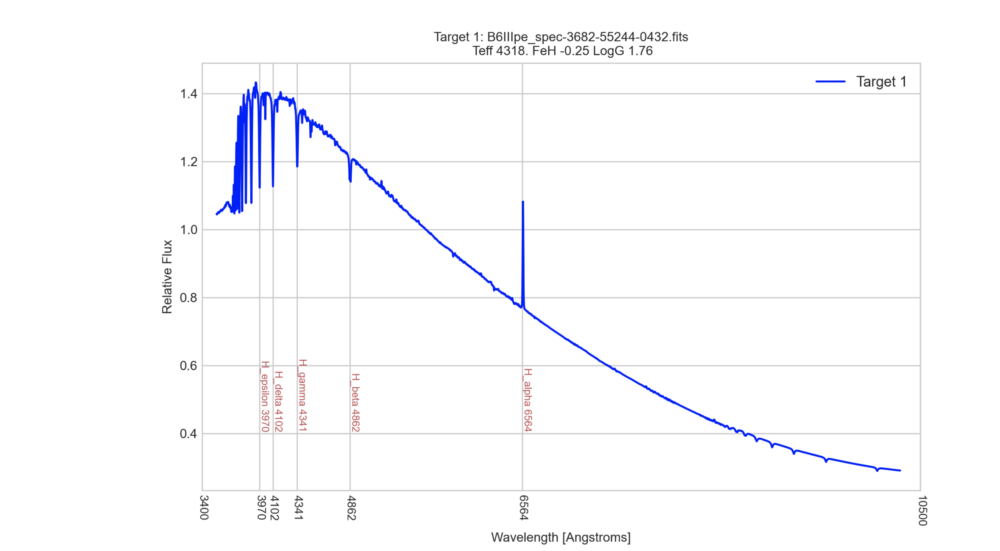

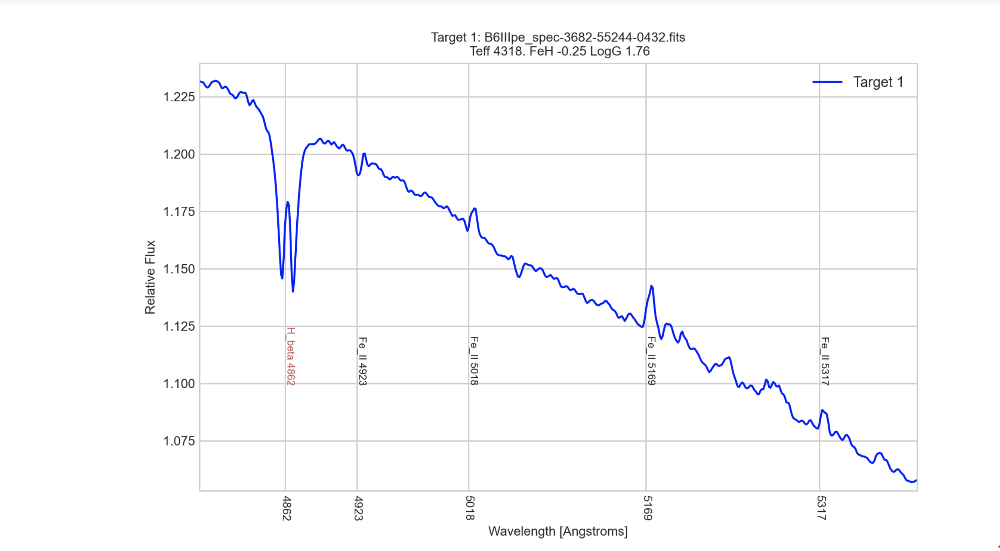

In [ ]:
txt = """ 
SDSS DR16 BOSS Survey B6IIIpe_23.csv  [IIIpe- normal giants 
                                              p-peculiar   
                                              e-Emission lines present]
B6IIIpe_spec-3682-55244-0064.fits
B6IIIpe_spec-3682-55244-0432.fits - Type 1 H-Alpha emission
                                  - Type 2 H-Beta emission or shell core
B6IIIpe_spec-3757-55508-0924.fits
B6IIIpe_spec-3768-55564-0901.fits
B6IIIpe_spec-3793-55214-0444.fits
B6IIIpe_spec-4175-55680-0151.fits
B6IIIpe_spec-4442-55532-0443.fits
B6IIIpe_spec-4661-55614-0992.fits - Type 1 H-alpha emission
B6IIIpe_spec-4723-56033-0538.fits - Type 1 H-alpha emission
B6IIIpe_spec-4740-55651-0520.fits
B6IIIpe_spec-4837-55707-0056.fits
B6IIIpe_spec-4867-55924-0558.fits
B6IIIpe_spec-5006-55706-0518.fits
B6IIIpe_spec-5155-55946-0956.fits
B6IIIpe_spec-5156-55925-0459.fits
B6IIIpe_spec-5335-56013-0453.fits
B6IIIpe_spec-5798-56326-0462.fits
B6IIIpe_spec-5810-56358-0358.fits
B6IIIpe_spec-5863-56042-0534.fits
B6IIIpe_spec-6299-56478-0582.fits
B6IIIpe_spec-6760-56425-0936.fits
B6IIIpe_spec-7239-56693-0666.fits
B6IIIpe_spec-7446-56722-0018.fits

SDSS DR16 eBOSS Survey B6IIIpe_6.csv
B6IIIpe_spec-8231-58199-0095.fits
B6IIIpe_spec-8525-57900-0738.fits
B6IIIpe_spec-8764-57332-0230.fits
B6IIIpe_spec-9619-57866-0963.fits
B6IIIpe_spec-11345-58428-0381.fits
B6IIIpe_spec-11357-58522-0265.fits
"""

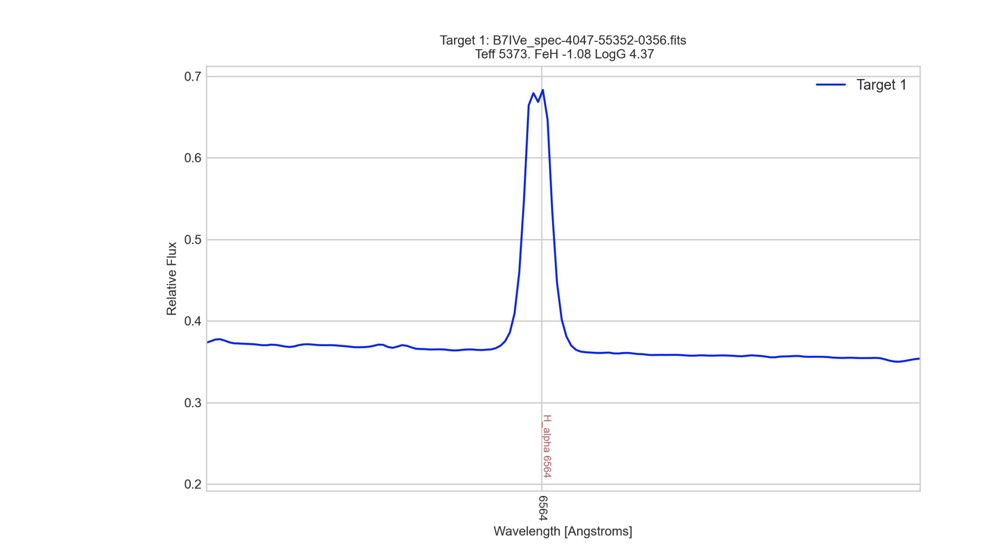

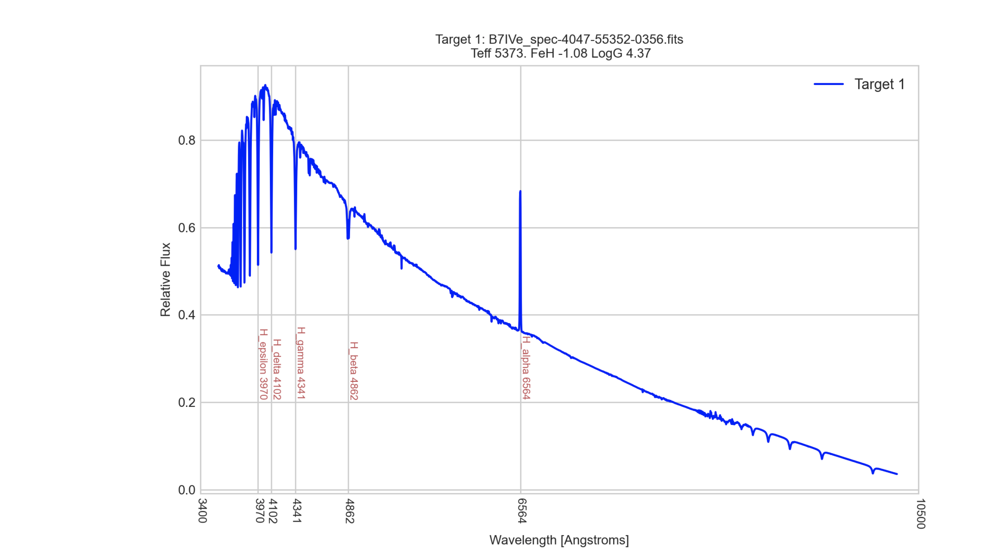

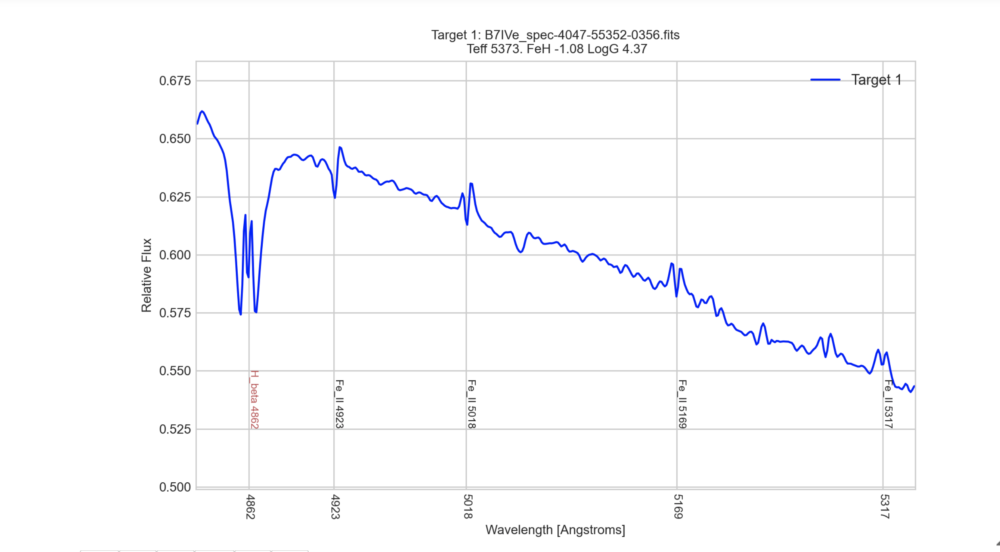

In [ ]:
txt = """
SDSS DR16 BOSS Survey B7IVe_15.csv  [IVe- subgiants                  
                                          e-Emission lines present]
B7IVe_spec-3969-55307-0911.fits - Type 3 H-alpha emission
                                - Type 4 H-Beta emission
                                - Fe II 5018A ̊,5169 A ̊,5317A ̊ Double Peak emission
B7IVe_spec-4047-55352-0356.fits - Type 3 H-alpha emission
                                - Type 4 H-Beta emission
                                - Fe II 5018A ̊,5169 A ̊,5317A ̊ Double Peak emission
B7IVe_spec-4264-55506-0196.fits - Type 3 H-alpha emission
                                - Type 4 H-Beta emission
                                - Fe II 5018A ̊,5169 A ̊,5317A ̊ Double Peak emission
B7IVe_spec-4889-55709-0770.fits - Type 3 H-alpha emission
                                - Type 4 H-Beta emission
                                - Fe II 5018A ̊,5169 A ̊,5317A ̊ Double Peak emission
B7IVe_spec-5198-55823-0528.fits - Type 3 H-alpha emission
                                - Type 4 H-Beta emission
                                - Fe II 5018A ̊,5169 A ̊,5317A ̊ Double Peak emission
B7IVe_spec-5863-56042-0584.fits - Type 3 H-alpha emission
                                - Type 4 H-Beta emission
                                - Fe II 5018A ̊,5169 A ̊,5317A ̊ Double Peak emission
B7IVe_spec-5972-56334-0560.fits - Type 3 H-alpha emission
                                - Type 4 H-Beta emission
                                - Fe II 5018A ̊,5169 A ̊,5317A ̊ Double Peak emission
B7IVe_spec-6265-56248-0916.fits - Type 3 H-alpha emission
                                - Type 4 H-Beta emission
                                - Fe II 5018A ̊,5169 A ̊,5317A ̊ Double Peak emission
B7IVe_spec-6462-56326-0435.fits - Type 3 H-alpha emission
                                - Type 4 H-Beta emission
                                - Fe II 5018A ̊,5169 A ̊,5317A ̊ Double Peak emission
B7IVe_spec-6617-56365-0624.fits - Type 3 H-alpha emission
                                - Type 4 H-Beta emission
                                - Fe II 5018A ̊,5169 A ̊,5317A ̊ Double Peak emission
B7IVe_spec-6739-56393-0704.fits
B7IVe_spec-7117-56685-0586.fits
B7IVe_spec-7120-56720-0106.fits
B7IVe_spec-7258-56605-0039.fits
B7IVe_spec-7258-56605-0421.fits                    
                    
SDSS DR16 eBOSS Survey B7IVe_10.csv      
B7IVe_spec-7708-57664-0776.fits
B7IVe_spec-7716-58097-0457.fits
B7IVe_spec-7730-58107-0822.fits
B7IVe_spec-7730-58107-0971.fits
B7IVe_spec-7731-58130-0177.fits
B7IVe_spec-8167-57071-0972.fits
B7IVe_spec-8281-57042-0081.fits
B7IVe_spec-8399-57843-0520.fits
B7IVe_spec-10246-58171-0001.fits
B7IVe_spec-10725-58250-0749.fits

"""

In [116]:
# eBOSS Spectra
f_path = './Downloads/eBOSS FITS Targets/'

In [117]:
def list_files(directory, extension):
    saved = getcwd()
    chdir(directory)
    ###
    ###                              Change Prefix 
    ###
    it = glob('A1Iae*.' + extension)
    ###
    ###
    chdir(saved)
    return it

In [118]:
selected_files = list_files(f_path, 'fits')
selected_file = int(len(selected_files))

In [119]:
items = ['Choose a star spectra']+sorted(selected_files)

In [120]:
v_target = widgets.Dropdown(
     options=items,
    value='Choose a star spectra',
    description='Target:',
    layout={'width': 'max-content'},
    disabled=False,
)
def get_variable(b):
    clear_output
    print(v_target.value)
    
display(v_target)


Dropdown(description='Target:', layout=Layout(width='max-content'), options=('Choose a star spectra', 'A1Iae_s…

In [121]:
target = str(v_target.value)
print(target)

A1Iae_spec-10253-58487-0394.fits


In [122]:
from astropy.table import Table
from astropy.io import fits

table = Table.read(f_path + target, hdu=1)
df0 = table.to_pandas() 
hdulist = fits.open(f_path + target)
hdu12 = hdulist[2].data
    
#wl = np.power(10, df0["loglam"])
#flux = df0['flux']
#model = df0['model']

wl = np.power(10, df0["LOGLAM"])
flux = df0['FLUX']
model = df0['MODEL']
    
tbl =np.column_stack((wl, flux, model))
df = pd.DataFrame(tbl, columns=['Wavelength', 'Flux', 'Model'])

In [125]:
spectra_lines = pd.read_csv("./Downloads/eBOSS FITS Targets/Boss_spectra_lines.csv")
df_spectra_lines = pd.DataFrame(spectra_lines)
df_Lines = df_spectra_lines.sort_values(by=['Element', 'SpectraLine'])

In [69]:
Class_O_notes = """O9.5_Ib - the lower level of the Super Giants, 25,000 K O9.5_II - Bright Giant

O-type stars are very hot and extremely luminous, with most of their radiated output in the ultraviolet range. 
These are the rarest of all main-sequence stars. 

About 1 in 3,000,000 (0.00003%) of the main-sequence stars in the solar neighborhood are O-type stars.
Some of the most massive stars lie within this spectral class. 

O-type stars frequently have complicated surroundings that make measurement of their spectra difficult.

O-type spectra formerly were defined by the ratio of the strength of 
the He II λ4541 relative to that of He I λ4471, where λ is the wavelength, measured in ångströms. 

Spectral type O7 was defined to be the point at which the two intensities are equal, 
with the He I line weakening towards earlier types. 

Type O3 was, by definition, the point at which said line disappears altogether, 
although it can be seen very faintly with modern technology. 

Due to this, the modern definition uses the ratio of the nitrogen line N IV λ4058 to N III λλ4634-40-42.

O-type stars have dominant lines of absorption and sometimes emission for He II lines, 
prominent ionized (Si IV, O III, N III, and C III) and neutral helium lines, 
strengthening from O5 to O9, and prominent hydrogen Balmer lines, although not as strong as in later types. 

Because they are so massive, O-type stars have very hot cores and burn through their hydrogen fuel very quickly, 
so they are the first stars to leave the main sequence.

When the MKK classification scheme was first described in 1943, the only subtypes of class O used were O5 to O9.5. 
The MKK scheme was extended to O9.7 in 1971 and O4 in 1978, 
and new classification schemes that add types O2, O3, and O3.5 have subsequently been introduced

Spectra display a strong ultraviolet emittance, 
with absent to weak He I and He II (neutral and singly ionized helium) 
and strong Balmer (ionized hydrogen) lines, which become weaker in earlier types at higher temperatures. 

Lines of N IV and N III (triply or doubly ionized nitrogen) and 
Si III (doubly ionized silicon) apparent but weak. 

Spectral classification is based on the line strength of N IV (λ4058) (O2 to O3.5) 
and the line strength ratios He II (λ4200)/He I (λ4026) (1.0 = O6), He II (λ4541)/He I (λ4471) (1.0 = O7), 
and He II (λ4541) = Si III (λ4552) (1.0 = O9.7). 

Luminosity is judged by the ratio of the strengths of N III emission and He II absorption. 

Temperature classification based on helium ionization; 
stellar winds become increasingly significant in the earlier subtypes.

[
Weak neutral and ionized Helium, 
weak Hydrogen, 
a relatively smooth contiinuum 
with very few absorption lines
]

"""

In [70]:
Class_B_notes = """B-type stars are very luminous and blue. 

Their spectra have neutral helium lines, which are most prominent at the B2 subclass, and moderate hydrogen lines. 

As O- and B-type stars are so energetic, they only live for a relatively short time. 

Thus, due to the low probability of kinematic interaction during their lifetime, 
they are unable to stray far from the area in which they formed, apart from runaway stars.

The transition from class O to class B was originally defined to be the point at which the He II λ4541 disappears. 

However, with modern equipment, the line is still apparent in the early B-type stars. 

Today for main-sequence stars, the B-class is instead defined by the intensity of the He I violet spectrum, 
with the maximum intensity corresponding to class B2. 

For supergiants, lines of silicon are used instead; 

the Si IV λ4089 and Si III λ4552 lines are indicative of early B. 

At mid B, the intensity of the latter relative to that of Si II λλ4128-30 is the defining characteristic, 
while for late B, it is the intensity of Mg II λ4481 relative to that of He I λ4471.

These stars tend to be found in their originating OB associations, which are associated with 
giant molecular clouds. 

The Orion OB1 association occupies a large portion of a spiral arm of the Milky Way and contains many of the 
brighter stars of the constellation Orion. 

About 1 in 800 (0.125%) of the main-sequence stars in the solar neighborhood are B-type main-sequence stars.

Massive yet non-supergiant entities known as "Be stars" are main-sequence stars that notably have, 
or had at some time, one or more Balmer lines in emission, with the hydrogen-related electromagnetic radiation 
series projected out by the stars being of particular interest. 

Be stars are generally thought to feature unusually strong stellar winds, high surface temperatures, 
and significant attrition of stellar mass as the objects rotate at a curiously rapid rate. 

Objects known as "B(e)" or "B[e]" stars possess distinctive neutral or low ionisation emission lines 
that are considered to have 'forbidden mechanisms', undergoing processes not normally allowed under 
current understandings of quantum mechanics.

Many stars have B-type spectra and show hydrogen emission lines, 
including many supergiants, Herbig Ae/Be stars, mass-transferring binary systems, and B[e] stars. 

It is preferred to restrict usage of the term Be star to non-supergiant stars showing one or more 
Balmer series lines in emission. These are sometimes referred to as classical Be stars. 

The emission lines may be present only at certain times.

Although the Be type spectrum is most strongly produced in class B stars, 
it is also detected in O and A shell stars, and these are sometimes included under the "Be star" banner. 

Be stars are primarily considered to be main sequence stars, 
but a number of subgiants and giant stars are also included.

With the understanding of the processes of emission line formation in the early 20th century 
it became clear that these lines in Be stars must come from circumstellar material ejected from the star 
helped by the rapid rotation of the star. 

All the observational characteristics of Be stars can now be explained with a gaseous disk that is formed 
of material ejected from the star. 

The infrared excess and the polarization result from the scattering of stellar light in the disk, 
while the line emission is formed by re-processing stellar ultraviolet light in the gaseous disc.

Some Be stars exhibit spectral features that are interpreted as a detached "shell" of gas surrounding the star, 
or more accurately a disc or ring. 

These shell features are thought to be caused when the disc of gas that is present around many Be stars 
is aligned edge on to us so that it creates very narrow absorption lines in the spectrum.

Strong He I (neutral helium) and Balmer hydrogen lines, Si I and Si II, O I (neutral oxygen) 
and Mg I (neutral magnesium). 

Spectral classification based on absence of He II in blue violet, 
weakening of He I and strengthening of Balmer hydrogen lines, the ratio S IV/S III (1.0 = B0.7) 
and strengthening of the Mg II (λ4481) line. 

Luminosity is judged by the "wings" (width vs. depth) of Balmer hydrogen lines and 
the intensity of O II lines as ratios to neutral helium and hydrogen. 

The Type B stars present many spectral and luminosity classification anomalies 
affected by the proportion of helium in the photosphere.

B stars are hot stars defined by the presence of hydrogen (H) and neutral helium (HeI) in the optical spectra. H line strength increases over the B star subclasses while HeI decreases. There are a wide variety of sub-types, as B stars occur over a wide range of luminosity, many have companion stars, and many have circumstellar material.
Other spectral features may include CaII, CII, CIII, NII, NIII, OII, SiII, SiIV, and MgII.

Be stars are defined as B stars having at least one of the hydrogen Balmer lines in emission at some time. 
These stars are rapid rotators, and a circumstellar shell and/or disk of gas is present. 
The circumstellar material may be due to mass loss or due to accretion from an evolved companion star. 
They are variable in both brightness and spectra. 
Spectra of Be stars show broad HeI absorption, and complex hydrogen Balmer line profiles 
that show emission out of the absorption cores.. 

A sub-class of the Be stars are the shell stars, which are Be stars oriented so that we see a 
circumstellar disk edge-on. 
The shell stars have spectra that show Balmer emission with sharp absorption cores, 
narrow absorption lines of ionized metals, and broad HeI absorption. Be stars are common,



[
Weak neutral Helium, 
stronger Hydrogen, 
an otherwise relatively smooth continuum
]

"""

In [71]:
Class_A_notes = """A-type stars are among the more common naked eye stars, and are white or bluish-white. 

They have strong hydrogen lines, at a maximum by A0, 

and also lines of ionized metals (Fe II, Mg II, Si II) at a maximum at A5. 

The presence of Ca II lines is notably strengthening by this point. 

About 1 in 160 (0.625%) of the main-sequence stars in the solar neighborhood are A-type stars

Very strong Balmer hydrogen lines, which peak in strength in Type A2, and the disappearance of He I. 
Many neutral metals (Fe I, Mg I, Ca I) weakly appear, 
but the spectrum overall is dominated by the hydrogen series. 

Spectral classification is based on the strength and width of Balmer hydrogen lines, 
strengthening of the Ca II K (λ3934) line, and strengthening in other metal lines. 

Luminosity is judged by the "wings" of the Balmer hydrogen lines. 

Type A stars show many surface peculiarities, with over 30% showing overabundances or underabundances 
of specific metallic elements; many also have very short rotation periods.

[
No Helium, 
very strong Hydrogen, 
weak CaII, 
the continuum is less smooth because of weak ionized metal lines
]

"""

In [72]:
Class_F_notes = """F-Class 
The H-Balmer lines are now much weaker and the Fraunhofer H + K lines(Ca II)become the dominant features. 
The Fraunhofer H absorption displaces the Hepsilon line. 
Toward the late subclasses the neutral elements (Fe I, Cr I, replace the absorption of ionised ones. 

The Ca I line at 4227 intensifies, as well as the G-band(CH molecular) the intesity of which surpasses the 
neighboring Hgamma line. 

The Line-double of the G-Band(CH molecular) and Hgamma the string Brand of the F-class. 

The Magnesium Triplet(5168-83) becomes stronger compared to the A-Class. 

F0 III is located at the top of the F-class and has already reachedthe Giant stage (III). 
The surface temperature is about 7,030 K. 
Apparent rotation speed some 84 km/s. 

Within this early F-class, the Fraunhofer H + K lines have already surpassed the intensity of the H-Balmer series,
where the K-line at 3968 has overprinteted the Hepsilon absorption. 

F5 IV-V represents the center of the F-class. 
The luminosity class IV-V reveales that it has begun to leave the Main Sequence in the HRD towards 
the Giant Branch. 
Rotation speed, 6 km/s. 
Surface temperature 6,630 K. 

The most noticeable and important difference relates to the Brand of the F-class, 
the increasing intensity of the CH molecular absorption band at 4300 and conversely the shrinkling of 
the neighboring Hgamma line. 

Further the growing intensity of the CaI line 4227. 

F0V - Dwarf on the main sequence 7,100K.
F2 III-IV moving from the Main Sequence to the Giant Branch, 6,700K, rotation speed 70 km/s. 
F2 lb one of the Supergiants, 6,180K, rotation 18 km/s.

F-type stars have strengthening spectral lines H and K of Ca II. 

Neutral metals (Fe I, Cr I) beginning to gain on ionized metal lines by late F. 

Their spectra are characterized by the weaker hydrogen lines and ionized metals. 

Their color is white. 

About 1 in 33 (3.03%) of the main-sequence stars in the solar neighborhood are F-type stars.

The strong Balmer lines indicate that this must be an A, B or F class star. 
Metal lines are not very strong in B class stars. 
And in general metal lines are increasingly common in cooler stars. 
Indeed, many metal lines are present, they account for most of the “bumps and wiggles” in the spectrum. 
They are too numerous to mention, however G-band λ4300 and FeII λ4175 are clearly present. 
We conclude that this is an F class star because 
it has strong Balmer lines, 
very strong CaII lines, 
and several other metal lines (including Na I).

Strong Balmer hydrogen lines that weaken as neutral metallic lines (Ca I, Fe I, Cr I) strengthen, 
with the first appearance of a few molecules (notably CH, the G band absorption at ~λ4300). 

Spectral classification is based primarily on the width and strength of Balmer hydrogen lines, 
which weaken in later subtypes, strengthening of metal absorption lines such as Fe I and Ca I, 
and appearance of the CH G band (at around F4). 

Luminosity is judged by lines of ionized iron and titanium in early subtypes 
and by the ratio of these metals to strontium (Sr II λ4077) in later subtypes. 

The F transition from Type A to G stars comprises the transition from primarily layered, 
radiative stellar surfaces to well mixed, convective photospheres, strong magnetic fields 
and much slower rotational speeds.

[
Strong Hydrogen, 
strong CaII, 
weak NaI, 
G-band, 
the continuum is rougher because of many ionized metal lines
]

"""

In [73]:
Class_G_notes = """G-Class 
The Fraunhofer H + K lines of ionised Ca II become strong acheiving theoretically the maximum intensity 
in the late G classes. 

For the main sequence starsof the G-Class, the K-line is slightly more intense than the H-line. 

The H-Balmer series becomes weaker, so these lines are now surpassed by various metal absorptions. 

From here they lose their function as orientation marks for calibration and line identification. 

The Magnesium Triplet(5169-83) increased during the F-Class and achieves considerable strength, 
with b its labeled with its own Fraunhofer letter. 

The Ca I line 4227 gains in intensity since early F classes and becomes here a striking spectral feature 
also with its own Fraunhofer letter g. 

In general, the trend continues by growing intensity of neutral metals Fe I and the Fraunhofer-D lines (Na l). 

Increasingly replacing the absorption of the ionized elements.

The temperature here is sunken to such a low level that simple diatomic molecules can survive in the 
stellar atmosphere. 

The Fraunhofer G-band and the CH molecule surpassing the H_gamma line. 

Strong CN and CH absorption bands in the violet area, overprinting the H8 and H9 Balmer lines.

G-type stars, including the Sun, have prominent spectral lines H and K of Ca II, which are most pronounced at G2. 

They have even weaker hydrogen lines than F, but along with the ionized metals, they have neutral metals. 

There is a prominent spike in the G band of CH molecules. 

Class G main-sequence stars make up about 7.5%, nearly one in thirteen, of the main-sequence stars in the 
solar neighborhood.

Class G contains the "Yellow Evolutionary Void".

Supergiant stars often swing between O or B (blue) and K or M (red). 

While they do this, they do not stay for long in the yellow supergiant G class, 
as this is an extremely unstable place for a supergiant to be.

Much weakened Balmer hydrogen lines and strengthened metal lines and G band (CH) absorption lines; 
neutral metallic atoms and ions now predominate. 

Spectral classification is based on the ratio of neutral metallic lines with hydrogen, 
specifically Ca I (λ4226)/Hδ and Fe I (λ4046)/Hδ, or with each other, e.g. Cr I (λ4254)/Fe I (λ4271), 
and infrared features become clearly diagnostic. 

Luminosity is judged by the ratio Sr II (λ4077)/Fe I (λ4046), strengthening of violet CN lines, 
and widening of the "wings" in Ca II H & K lines. 

The G stars form a continuous transition in features from mid Type F through mid Type K, 
creating a large but coherent group of "solar type" stars; 
increased metallicity is associated with a higher frequency of planetary systems, 
probably due to the thermal and magnetic effects of metallicity in the 
fragmentation of protostar circumstellar disks.

[
Weaker Hydrogen, 
strong CaII, 
stronger NaI, 
many ionized and neutral metals, 
G-band is present
]

"""

In [74]:
Class_K_notes = """The neutral calcium Ca I at 4227 has excelled the G-Band in the class K5

They have extremely weak hydrogen lines, if those are present at all, 
and mostly neutral metals (Mn I, Fe I, Si I). 

By late K, molecular bands of titanium oxide become present. 

K-type stars are orangish stars that are slightly cooler than the Sun. 
They make up about 12% of the main-sequence stars in the solar neighborhood.

There are also giant K-type stars, which range from hypergiants like RW Cephei, to giants and supergiants, 
such as Arcturus, whereas orange dwarfs, like Alpha Centauri B, are main-sequence stars.

They have extremely weak hydrogen lines, if those are present at all, and mostly neutral metals (Mn I, Fe I, Si I).

By late K, molecular bands of titanium oxide become present. 

Neutral metal lines strengthen, and Balmer hydrogen lines weaken in a continuation of the trends 
seen in Type G stars; the G band of the CH molecule peaks at K2 and then weakens. 

Luminosity is judged by widening in the Ca II H & K lines, in the MgH and TiO lines near λ4770, 
and in the ratio Sr II/Fe I. 

Infrared features above one micron (> λ10000) become the more reliable basis for spectral classification, 
in particular using molecular bands of carbon monoxide (CO). 

Type K dwarfs have less than half the luminosity of the Sun; 
most naked eye examples are giant or supergiant stars.	

[
Very weak Hydrogen, 
strong CaII, 
strong NaI, 
and many metals, 
G-band is present
]

"""

In [75]:
Class_M_notes = """Class M stars are by far the most common. 
About 76% of the main-sequence stars in the solar neighborhood are class M stars.
However, class M main-sequence stars (red dwarfs) have such low luminosities that none are bright enough 
to be seen with the unaided eye, unless under exceptional conditions. 
The brightest known M-class main-sequence star is M0V Lacaille 8760, with magnitude 6.6 
(the limiting magnitude for typical naked-eye visibility under good conditions is typically quoted as 6.5), 
and it is extremely unlikely that any brighter examples will be found.

Although most class M stars are red dwarfs, most of the largest ever supergiant stars in the Milky Way are M stars,
such as VV Cephei, Antares, and Betelgeuse, which are also class M. 

Furthermore, the larger, hotter brown dwarfs are late class M, usually in the range of M6.5 to M9.5.

The spectrum of a class M star contains lines from oxide molecules (in the visible spectrum, especially TiO) 
and all neutral metals, but absorption lines of hydrogen are usually absent. 

TiO bands can be strong in class M stars, usually dominating their visible spectrum by about M5. 

Vanadium(II) oxide bands become present by late M.

Strong lines of many neutral metals and diatomic molecules predominate; 
in late subtypes the background continuum entirely disappears under molecular absorption features 
which also causes metallic absorption lines to decrease in strength. 

Spectral classification is based on bands of titanium oxide (TiO), 
especially TiO (λ4955), and MgH (λ4780). 

Luminosity is judged by decreasing strength of the Ca I (λ4226) line 
and in TiO bands above λ4900. 

Type M stars often show hydrogen emission due to very large chromosphere flares.

[
Strong TiO molecular bands, 
strongest NaI, 
weak CaII, 
very weak Hydrogen absorption, 
(Note: Hydrogen may be emission lines.)
]

"""

In [76]:
t = """
e	Emission lines present
m	Enhanced metal features
n	Broad ("nebulous") absorption due to spinning
p	Unspecified peculiarity
var	Variable spectral feature[30] (sometimes abbreviated to "v")
wl	Weak lines[30] (also "w" & "wk")

0 or Ia+ hypergiants or extremely luminous supergiants
Ia	luminous supergiants
Iab	intermediate-size luminous supergiants
Ib	less luminous supergiants
II	bright giants
III	normal giants
IV	subgiants
V	main-sequence stars (dwarfs)
sd (prefix) or VI subdwarfs
D (prefix) or VII white dwarfs 

"""

In [77]:
Blue_Giants_notes = """Blue Giants. 
Here are examples of massive stars as they appear when they begin to evolve off the main sequence 
and head to the red giant branch. 
Note the extremely well-defined hydrogen absorption lines. 
As the star expands its surface gravity decreases, relative to what it was on the main-sequence, 
and this improves the sharpness of the asbsorption lines.

O7B1III, [B5III], A3III, F47III

"""

In [78]:
Blue_Super_Giants_notes = """Blue Super Giants. 

O56IF, OBI, B1I, B35I, B8I, A03I, A79I, F03I

A1Iae, A2Ia, A3Iae, A5Ia , B0.5Iae, B0.5Ibe, B2Iaevar, B3Ib/II, B5Ib, B8Ib, F0Ib, 

"""

In [79]:
Red_Giants_notes = """Red Giants. 
Here are example spectra of cool, red giant stellar atmospheres. 
They look similar to their main sequence counterparts of the same spectral type 
but again the features are sharper, most notably, the calcium triple at around 8500 angstroms, 
in which all 3 lines of calcium are much more prominent in Giants than main sequence stars.

G04III, G56III, G8K0III, K2III, K4III, CO

"""

In [80]:
Very_Cool_Giants_notes = """Very Cool Giants. 
(Here are example spectra of very cool (T < 3500 K) red giant stellar atmospheres. 
The degree of excitation is so low here that molecules are able to form in these atmospheres. 
The complex rotational and vibrational energy states of a molecule give rise to deep absorption troughs 
(called bandheads) that occupy 1-300 angstroms. 
Missing data in these spectra is due to calibration problems associated with sky subtraction.

M4III, M3III, M01III, M4VE, M2V, K7III

"""

In [81]:
Very_Cool_Giants_notes = """Extreme Molecular Band Heads. 
These are the coolest known giants (and likely to be very rich in heavy elements). 
The bandhead structure should be obvious, particularly longward of 7000 angstroms. 
They look similar to their main sequence counterparts of the same spectral type 
but again the features are sharper, most notably, the calcium triple at around 8500 angstroms, 
in which all 3 lines of calcium are apparent.

M7SIII, M6III, M5III

"""

In [96]:
###########################  Display Area    #####################

http://skyserver.sdss.org/dr16/en/tools/getimg/plate.aspx?choosesurvey=apogee&P=299489402097264640&S=1868993899549190144&B=4037477152865658880&A=apogee.apo25m.s.r12.10001.57372

In [82]:
notes = widgets.Output(layout={'border': '1px solid black'})
notes

Output(layout=Layout(border='1px solid black'))

In [83]:
out = widgets.Output(layout={'border': '1px solid black'})
out

Output(layout=Layout(border='1px solid black'))

In [84]:
out1 = widgets.Output(layout={'border': '1px solid black'})
out1

Output(layout=Layout(border='1px solid black'))

In [85]:
out2 = widgets.Output(layout={'border': '1px solid black'})
out2

Output(layout=Layout(border='1px solid black'))

In [86]:
out3 = widgets.Output(layout={'border': '1px solid black'})
out3

Output(layout=Layout(border='1px solid black'))

In [87]:
out4 = widgets.Output(layout={'border': '1px solid black'})
out4

Output(layout=Layout(border='1px solid black'))

In [88]:
out5 = widgets.Output(layout={'border': '1px solid black'})
out5

Output(layout=Layout(border='1px solid black'))

In [89]:
out6 = widgets.Output(layout={'border': '1px solid black'})
out6

Output(layout=Layout(border='1px solid black'))

In [90]:
out7 = widgets.Output(layout={'border': '1px solid black'})
out7

Output(layout=Layout(border='1px solid black'))

In [91]:
from IPython.core.display import display, HTML
#display(HTML('https://en.wikipedia.org/wiki/Stellar_classification#Class_K'))

In [92]:
from IPython.core.display import display, HTML
#display(HTML('https://en.wikipedia.org/wiki/Supergiant_star'))

In [93]:
from IPython.core.display import display, HTML
#display(HTML('https://en.wikipedia.org/wiki/Blue_supergiant_star'))

In [94]:
from IPython.core.display import display, HTML
#display(HTML('https://en.wikipedia.org/wiki/Yellow_supergiant_star'))

In [95]:
from IPython.core.display import display, HTML
#display(HTML('https://en.wikipedia.org/wiki/Red_supergiant_star'))

In [97]:
from IPython.display import display, HTML
display(HTML(data="""
<style>
    div#notebook-container    { width: 95%; }
    div#menubar-container     { width: 65%; }
    div#maintoolbar-container { width: 99%; }
</style>
"""))

In [105]:
shift = 0
y_size = 0.0

<IPython.core.display.Javascript object>


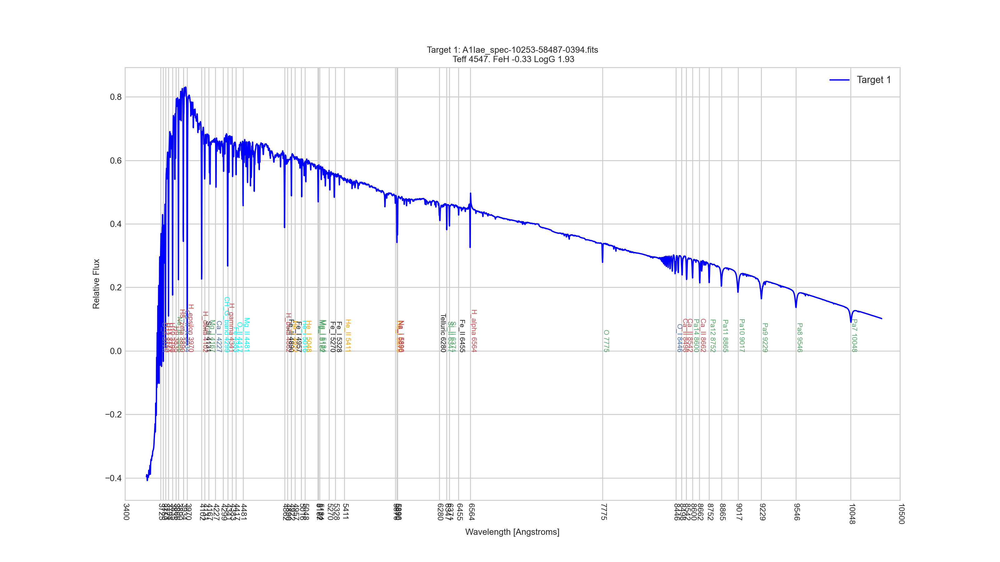

Box(children=(Checkbox(value=False, description='Hydrogen'), Checkbox(value=False, description='Small Hydrogen…

In [126]:
import matplotlib.pyplot as plt
from IPython.display import display
from ipywidgets import Checkbox
from ipywidgets import Layout, Box
%matplotlib notebook

df0 = df[df['Wavelength'] >= 3400]
df1 = df0[df0['Wavelength'] <= 10500]

plt.style.use('seaborn-whitegrid')

fig = plt.figure(figsize=(16,9), dpi= 100)

ax  = fig.add_subplot(111)
ax.plot(df1['Wavelength'] - shift, df1['Model'] * target_shift, color='blue', linestyle='solid', label='Target 1')
ax.set_title('Target 1: ' + target + '\n' + 
             " Teff " + str(hdu12['ELODIE_TEFF']).strip("[\]") +
             " FeH " + str(hdu12['ELODIE_FEH']).strip("[\]") +
             " LogG " + str(hdu12['ELODIE_LOGG']).strip("[\]"), fontsize=10)
ax.set_xlabel('Wavelength [Angstroms]', fontsize=10)
ax.set_ylabel('Relative Flux', fontsize=10)
ax.legend(fontsize=10)
plt.xticks(size = 9, rotation=-90)
plt.yticks(size = 10)

plt.xlim(3400, 10500)
Grid      = [3400, 10500]

extraTicks = []

for i in df_Lines.index:
    extraTicks.append(df_Lines.SpectraLine[i])

t = Grid + extraTicks

ax.set_xticks(t)

xticks = ax.xaxis.get_major_ticks()

for i in extraTicks:
        xticks[t.index(i)].set_visible(False)
                
plt.legend()
plt.show();

ck_Class_O.value =  False
ck_Class_B.value =  False
ck_Class_Be.value = False
ck_Class_A.value =  False
ck_Class_Am.value = False
ck_Class_F.value =  False
ck_Class_G.value =  False
ck_Class_K.value =  False
ck_Class_M.value =  False

out.clear_output()
out1.clear_output()
out2.clear_output()
out3.clear_output()
out4.clear_output()
out5.clear_output()
out6.clear_output()
out7.clear_output()
notes.clear_output()

box_layout = Layout(display='flex',
                    flex_flow='row',
                    align_items='stretch',
                    width='100%')

box = Box(children=(ck_Hydrogen, ck_Small_Hydrogen, ck_Class_Be, ck_Small_Class_Be, 
                    ck_Class_O, ck_Class_B, ck_Class_A, ck_Class_Am,
                    ck_Class_F, ck_Class_G, ck_Class_K, ck_Class_M,
                     ck_Helium, ck_Ca_II_H_K, ck_Metals, ck_Molecular_Band, ck_Telluric_Absorption,
                    ck_O2_A_band, ck_O2_B_band, ck_O2_a_band, 
                    ck_All, ck_Class_SDSS, ck_Emission, ck_He_I_Emission, ck_Fe_II_Emission, ck_Special, ck_Ba_II,  
                    ck_C,      ck_C_I,    ck_C_II,   ck_C_III,  ck_C_IV,   ck_C2,     ck_Ca_I,   ck_Ca_II,  
                    ck_CaH,    ck_CH,     ck_Cn,     ck_CN,     ck_Cr_I,   ck_Cr_II,
                    ck_Fe,     ck_Fe_I,   ck_Fe_II,  ck_He_I,   ck_He_II, 
                    ck_Mg_I,   ck_Mg_II,  ck_Mn_I,   ck_N_II,   ck_N_III,  ck_N_IV,   ck_N_V,   ck_Na_I,  
                    ck_Ne_III, ck_Ni_I,   ck_O,      ck_O_I,    ck_O_II,   ck_O_II_V, ck_O_III, ck_O_V,
                    ck_S,      ck_S_II,   ck_Si_II,  ck_Si_III, ck_Si_IV,  ck_SiC2,   ck_Sr_II, ck_Telluric,
                    ck_Ti_I,   ck_Ti_II,  ck_TiO,    ck_V_I,    ck_VI_CaI, ck_Zr_II,  ck_ZrO),
     layout=box_layout)

box


In [74]:
y_size = 0.35

In [81]:
shift = -10.0

In [ ]:
###########################  Special interest and emission lines    #####################

In [100]:
v_line = widgets.Dropdown(
     options=emission_lines,
    value='Choose an emission line',
    description='Line:',
    layout={'width': 'max-content'},
    disabled=False,
)
def get_variable(b):
    clear_output
    print(v_line.value)
    
display(v_line)


Dropdown(description='Line:', layout=Layout(width='max-content'), options=('Choose an emission line', [3888, '…

In [101]:
eLine = v_line.value
Apply_annotate(eLine[0], y_size, eLine[1], 'g', eval(str(eLine[1]) + '_idx'))
xticks[t.index(eLine[0])].set_visible(True)
print(eLine[0])
print(eLine[1])

4026
He_I


In [ ]:
###########################  Line Y Displacement    #####################

In [ ]:
from IPython.display import display
y = widgets.FloatSlider(description='Set Size', 
    min=0.0, 
    max=15,
    step=0.01)
display(y)

In [ ]:
size = float(y.value)
y_size = 0.1 + size
print('y_size: ' + str(y_size))


In [ ]:
y_size = 0.08

In [ ]:
target_shift   = 1.75    # Multiply by
template_shift = 0.01    # Divide by

In [ ]:
######################    Line Shift   ################################

In [ ]:
c = 300000 # speed of light
line_wavelength = 4862
shifted_wavelength = 4866
wavelength_shift = shifted_wavelength - line_wavelength
print("Wavelength shift: " + str(wavelength_shift) + " Angstroms")

In [ ]:
from IPython.display import display
x = widgets.IntSlider(description='Set Shift',
    min=-30, 
    max=50,
    step=1)
display(x)

In [ ]:
shift = int(x.value)
print('shift: ' + str(shift))

In [ ]:
shift = 0

In [ ]:
shift2 = 0

In [ ]:
###########################  All spectra lines    #####################

In [102]:
#df_sorted = spectra_lines.sort_values(by=['Element'])
df_sorted = spectra_lines.sort_values(by=['SpectraLine'])

a_list = df_sorted.values.tolist()
a_lists = ['Choose a spectra line'] + a_list

a_line = widgets.Dropdown(
     options=a_lists,
    description='Line:',
    layout={'width': 'max-content'},
    disabled=False,
)
def get_variable(b):
    clear_output
    print(a_line.value)
    
display(a_line)

Dropdown(description='Line:', layout=Layout(width='max-content'), options=('Choose a spectra line', ['N_IV', 3…

In [103]:
eLine = a_line.value
Apply_annotate(eLine[1], y_size, eLine[0], 'g', eval(str(eLine[0]) + '_idx'))
xticks[t.index(eLine[1])].set_visible(True)
print(eLine[0])
print(eLine[1])

O_II
3727


In [ ]:
###########################  Special interest and emission lines    #####################

In [104]:
v_line = widgets.Dropdown(
     options=emission_lines,
    value='Choose an emission line',
    description='Line:',
    layout={'width': 'max-content'},
    disabled=False,
)
def get_variable(b):
    clear_output
    print(v_line.value)
    
display(v_line)


Dropdown(description='Line:', layout=Layout(width='max-content'), options=('Choose an emission line', [3888, '…

In [ ]:
eLine = v_line.value
Apply_annotate(eLine[0], y_size, eLine[1], 'g', eval(str(eLine[1]) + '_idx'))
xticks[t.index(eLine[0])].set_visible(True)
print(eLine[0])
print(eLine[1])

In [ ]:
c = 300000 # speed of light
h_alpha_wavelength = 6564
wavelength_shift = 6595 - h_alpha_wavelength
print("Wavelength shift: " + str(wavelength_shift) + " Angstroms")

In [ ]:
gas_expansion_velocity = (wavelength_shift / h_alpha_wavelength) * c
print("gas_expansion velocity: " + str(int(gas_expansion_velocity)) + " km/s")

http://www.eso.org/~cguirao/caos/spectralclassification/SpectralClassification.html

### Luminosity class 0 or Ia+ is used for hypergiants
### class I for supergiants, 
### class II for bright giants, 
### class III for regular giants, 
### class IV for sub-giants, 
### class V for main-sequence stars, 
### class sd (or VI) for sub-dwarfs, and 
### class D (or VII) for white dwarfs. 

## A9 - O5 main sequence stars. 
These are hot stars, with surface temperatures greater than 10,000 K. As a consequence their spectra are rising into the blue. You should also note the steady increase of the strength of the hydrogen absorption lines.
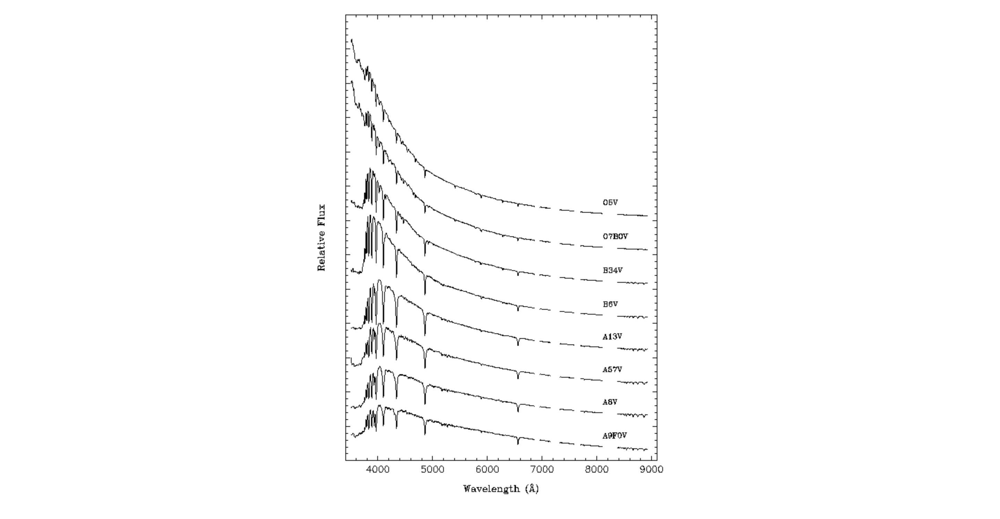


## K5 - F7 main sequence stars. 
Now we see a progression from stars with temperatures around 7000 (F7) to those with temperatures of around 4000 (K5). The strength of the hydrogen lines decreases as collisional excitation in these cooler atmospheres is insufficient to populate excited stats in hydrogen. Metallic lines now become much stronger. In particular, Calcium II H and K (wavelength around 3900 Angstroms), Magnesium I (5150 angstroms - see especially K stars) and Sodium D around 5800 angstroms. As you get to lower temperature proportinately more flux is emitted at longer (redder wavelengths).
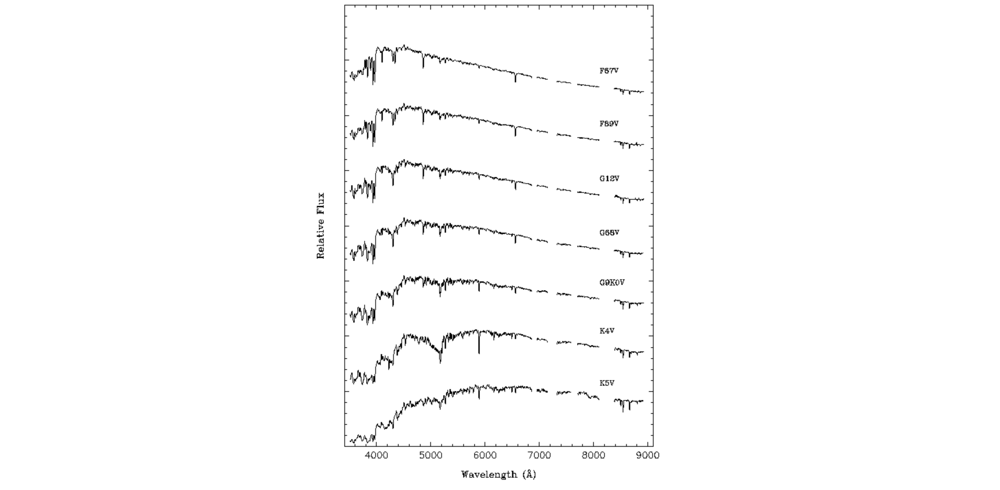

## G8 - A7 main sequence stars. 
Here we see a narrower range of temperatures represented with again the general trend of increasing metallic line strength and decreasing hydrogen line strength. A collection of absorption features, predominately due to Iron, produces a depression, known as the G-band around 4100 angstroms which can be clearly seen in the G-star spectra (try using the zoom option in ghostview for this).
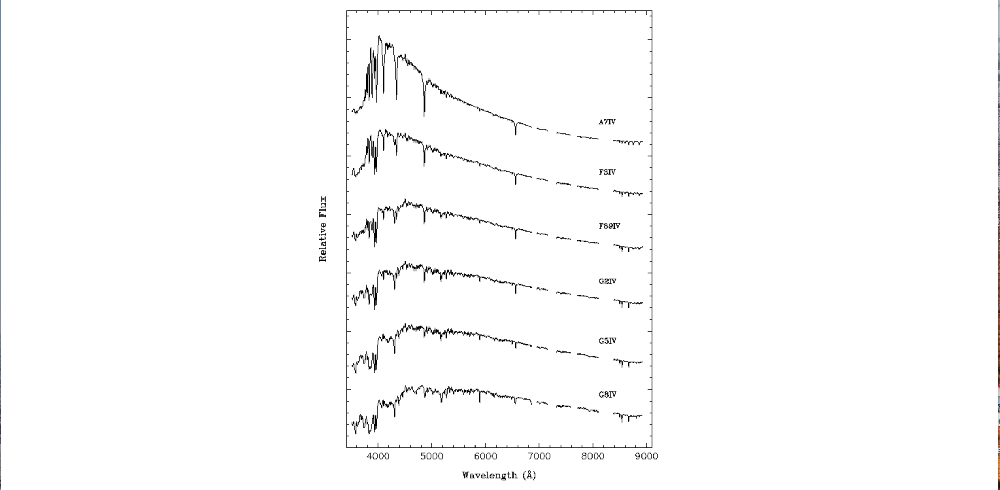

## Blue Giants. 
Here are examples of massive stars as they appear when they begin to evolve off the main sequence and head to the red giant branch. Not the extremely well-defined hydrogen absorption lines. As the star expands its surface gravity decreases, relative to what it was on the main-sequence, and this improves the sharpness of the asbsorption lines.
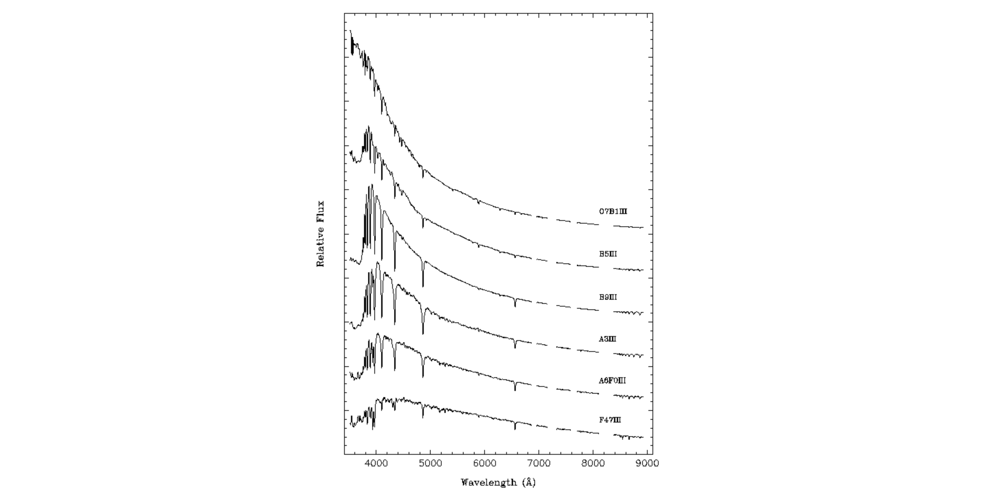

## Red Giants. 
Here are example spectra of cool, red giant stellar atmospheres. They look similar to their main sequence counterparts of the same spectral type but again the features are sharper, most notably, the calcium triple at around 8500 angstroms, in which all 3 lines of calcium are much more prominent in Giants than main sequence stars.
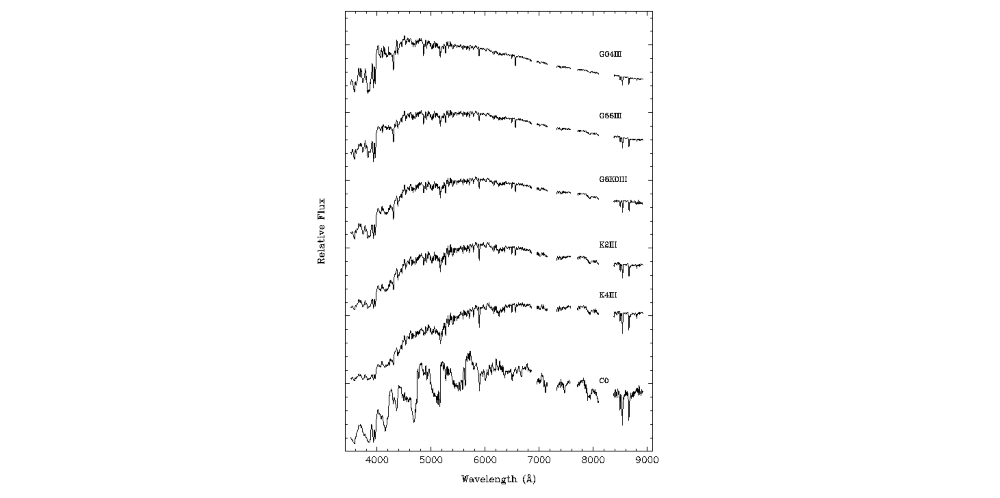

## Very Cool Giants. 
(Here are example spectra of very cool (T < 3500 K) red giant stellar atmospheres. The degree of excitation is so low here that molecules are able to form in these atmospheres. The complex rotational and vibrational energy states of a molecule give rise to depp absorption troughs (called bandheads) that occupy 1-300 angstroms. Missing data in these spectra is due to calibration problems associated with sky subtraction.
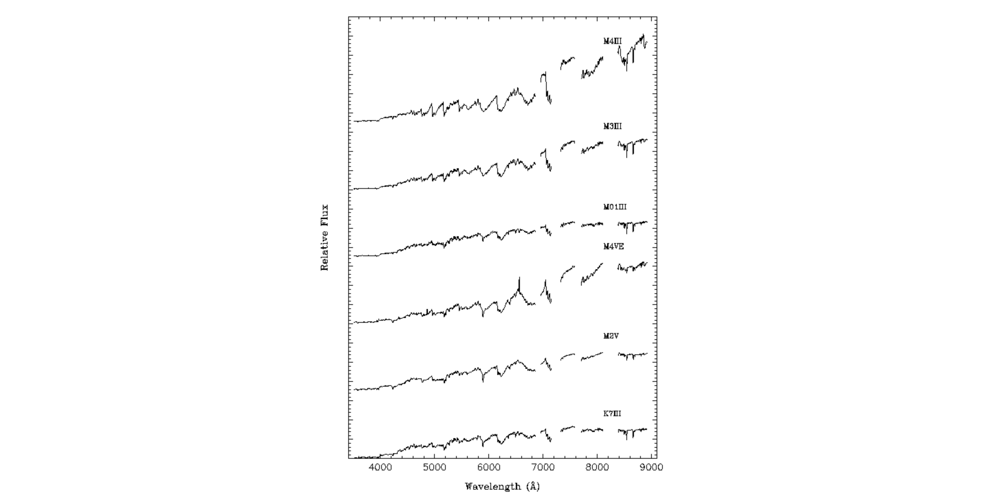

## Extreme Molecular Band Heads. 
These are the coolest known giants (and likely to be very rich in heavy elements). The bandhead structure should be obvious, particularly longward of 7000 angstroms. They look similar to their main sequence counterparts of the same spectral type but again the features are sharper, most notably, the calcium triple at around 8500 angstroms, in which all 3 lines of calcium are apparent.
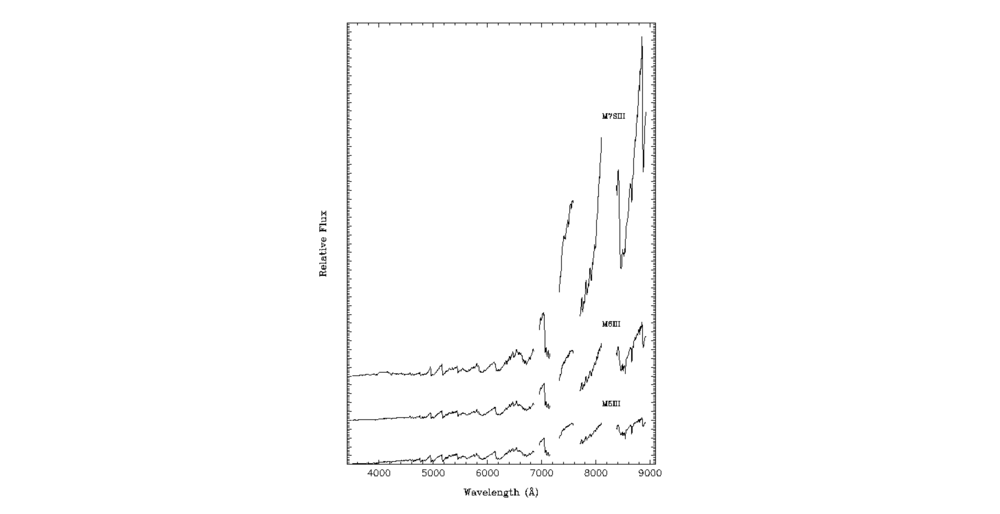

## Blue Supergiants.
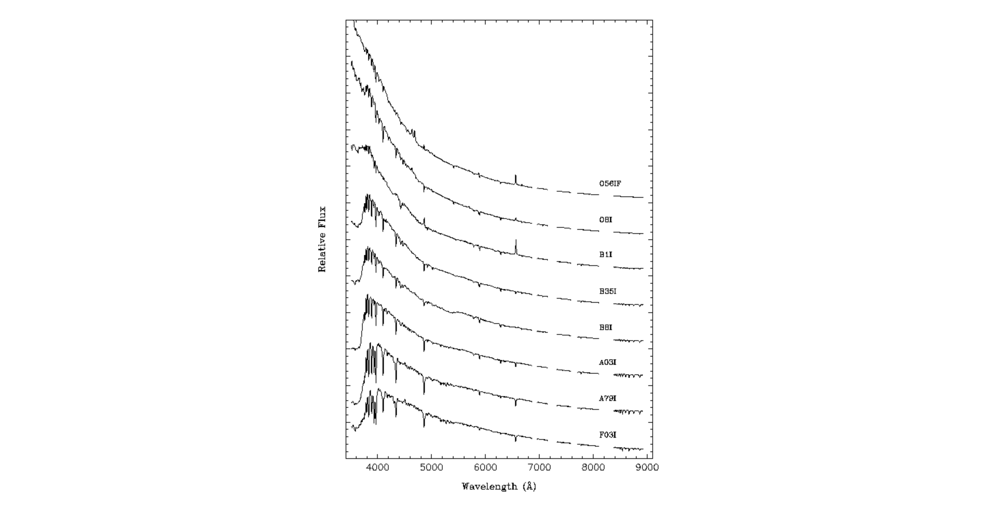